In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import StackingRegressor
from sklearn.metrics import accuracy_score, mean_squared_error
from sklearn.compose import ColumnTransformer
import statsmodels.api as sma
from sklearn.model_selection import cross_val_score,GridSearchCV,RandomizedSearchCV
from sklearn import tree
from scipy.stats import randint
from mlxtend.feature_selection import SequentialFeatureSelector as sfs

In [4]:
df_final=pd.read_csv("df_last.csv")

,department,promotion_name,media_type,sales_district,store_type,yearly_income,member_card,occupation,video_store,store_cost,unit_sales,SRP,net_weight,cost,store_sqft,promotion_period
0,14,38,1,2,4,4,0,4,0,2.2784,4,1.78,11.30,12950,39696.0,4
1,9,38,1,2,4,4,0,4,0,1.7856,4,1.44,5.25,12950,39696.0,4
2,13,38,1,2,4,4,0,4,0,2.0535,3,1.85,4.11,12950,39696.0,4
3,17,38,1,2,4,5,2,4,0,2.2440,2,3.74,12.10,12950,39696.0,4
4,5,38,1,2,4,5,2,4,0,1.0488,4,0.57,14.80,12950,39696.0,4


In [5]:
df_final.shape

(70751, 16)

In [19]:
df_final.columns

Index(['department', 'promotion_name', 'media_type', 'sales_district',
       'store_type', 'yearly_income', 'member_card', 'occupation',
       'video_store', 'store_cost', 'unit_sales', 'SRP', 'net_weight', 'cost',
       'store_sqft', 'promotion_period'],
      dtype='object')

In [10]:
#Setting target variable
X = df_final.drop(columns=['cost'])
y = df_final['cost']

In [11]:
#Splitting train test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# XGB Regressor

In [12]:
xgbr=XGBRegressor(random_state=42)
model_xgbr=xgbr.fit(X_train,y_train)

In [13]:
df_imp_xgbr=pd.DataFrame({"feature":X_train.columns,"importance":model_xgbr.feature_importances_})
df_imp_xgbr.sort_values(by="importance",ascending=False)

,feature,importance
8,video_store,0.366447
2,media_type,0.117064
3,sales_district,0.115071
14,promotion_period,0.108674
13,store_sqft,0.105873
1,promotion_name,0.099891
4,store_type,0.084572
10,unit_sales,0.001076
6,member_card,0.001042
7,occupation,0.000116


<Axes: xlabel='importance', ylabel='feature'>

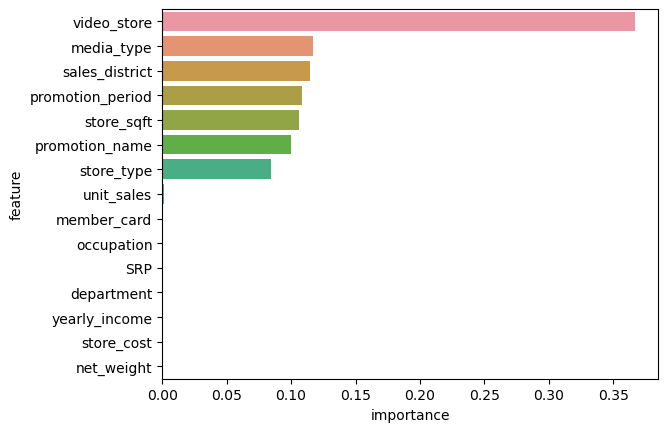

In [14]:
df_max_imp_xgbr=df_imp_xgbr.sort_values(by="importance",ascending=False)
sns.barplot(x=df_max_imp_xgbr["importance"],y=df_max_imp_xgbr["feature"])

In [15]:
ypred_train=model_xgbr.predict(X_train)
ypred_test=model_xgbr.predict(X_test)

In [16]:
mse_train=mean_squared_error(y_train,ypred_train)
mse_test=mean_squared_error(y_test,ypred_test)
print("Mean squared error for train data:",mse_train)
print("Mean squared error for test data:",mse_test)

Mean squared error for train data: 2661.0073255958323
Mean squared error for test data: 3154.4348410471835


In [17]:
# Example: Cross-validation with 3 folds
scores = cross_val_score(XGBRegressor(random_state=42), X, y, cv=3, scoring='neg_mean_squared_error')
print("Cross-validated RMSE:", -scores)

Cross-validated RMSE: [10632527.76591312 10610486.21193903 10599066.13568085]


In [18]:
print(np.min(-scores),np.max(-scores),np.mean(-scores))

10599066.135680847 10632527.765913118 10614026.704511


 # visualization

In [20]:
df_vis=pd.read_csv("df_trim.csv")
df_vis.head()

,product_id,time_id,customer_id,promotion_id,store_id,store_sales,store_cost,unit_sales,product_class_id,brand_name,...,houseowner,num_cars_owned,fullname,the_date,the_day,the_year,the_month,day_of_month,day_since_epoch,promotion_period
0,451,677,7366,207,3,7.12,2.2784,4,55,Red Wing,...,Y,4,Ann Smith,11/7/1997,Friday,1997,11,7,34279,4
1,1293,677,7366,207,3,5.76,1.7856,4,14,Booker,...,Y,4,Ann Smith,11/7/1997,Friday,1997,11,7,34279,4
2,738,677,7366,207,3,5.55,2.0535,3,39,Consolidated,...,Y,4,Ann Smith,11/7/1997,Friday,1997,11,7,34279,4
3,1426,677,8947,207,3,7.48,2.2440,2,61,Hermanos,...,Y,2,Robert Bell,11/7/1997,Friday,1997,11,7,34279,4
4,338,677,8947,207,3,2.28,1.0488,4,58,Better,...,Y,2,Robert Bell,11/7/1997,Friday,1997,11,7,34279,4


In [23]:
#Impute null values with median for specified columns
columns_to_impute = ['store_sqft', 'grocery_sqft', 'frozen_sqft', 'meat_sqft']
imputer = SimpleImputer(strategy='median')
df_vis[columns_to_impute] = imputer.fit_transform(df_vis[columns_to_impute])

In [24]:
df_vis.isnull().sum()

product_id          0
time_id             0
customer_id         0
promotion_id        0
store_id            0
                   ..
the_year            0
the_month           0
day_of_month        0
day_since_epoch     0
promotion_period    0
Length: 94, dtype: int64

In [25]:
df_fin=df_vis[['department', 'promotion_name', 'media_type', 'sales_district',
       'store_type', 'yearly_income', 'member_card', 'occupation',
       'video_store', 'store_cost', 'unit_sales', 'SRP', 'net_weight', 'cost',
       'store_sqft', 'promotion_period']]

In [26]:
df_fin

,department,promotion_name,media_type,sales_district,store_type,yearly_income,member_card,occupation,video_store,store_cost,unit_sales,SRP,net_weight,cost,store_sqft,promotion_period
0,Household,Super Duper Savers,Cash Register Handout,Bremerton,Supermarket,$30K - $50K,Bronze,Skilled Manual,0,2.2784,4,1.78,11.30,12950,39696.0,4
1,Dairy,Super Duper Savers,Cash Register Handout,Bremerton,Supermarket,$30K - $50K,Bronze,Skilled Manual,0,1.7856,4,1.44,5.25,12950,39696.0,4
2,Health and Hygiene,Super Duper Savers,Cash Register Handout,Bremerton,Supermarket,$30K - $50K,Bronze,Skilled Manual,0,2.0535,3,1.85,4.11,12950,39696.0,4
3,Produce,Super Duper Savers,Cash Register Handout,Bremerton,Supermarket,$50K - $70K,Normal,Skilled Manual,0,2.2440,2,3.74,12.10,12950,39696.0,4
4,Canned Foods,Super Duper Savers,Cash Register Handout,Bremerton,Supermarket,$50K - $70K,Normal,Skilled Manual,0,1.0488,4,0.57,14.80,12950,39696.0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70746,Produce,Savings Galore,In-Store Coupon,Victoria,Mid-Size Grocery,$110K - $130K,Silver,Management,0,3.5328,3,2.56,8.50,13006,34452.0,3
70747,Produce,Savings Galore,In-Store Coupon,Victoria,Mid-Size Grocery,$110K - $130K,Silver,Management,0,0.8835,5,0.57,7.30,13006,34452.0,3
70748,Household,Savings Galore,In-Store Coupon,Victoria,Mid-Size Grocery,$90K - $110K,Golden,Professional,0,1.4586,3,1.43,7.19,13006,34452.0,3
70749,Produce,Savings Galore,In-Store Coupon,Victoria,Mid-Size Grocery,$90K - $110K,Golden,Professional,0,2.0720,2,2.59,7.77,13006,34452.0,3


In [28]:
df_fin.dtypes

department           object
promotion_name       object
media_type           object
sales_district       object
store_type           object
yearly_income        object
member_card          object
occupation           object
video_store           int64
store_cost          float64
unit_sales            int64
SRP                 float64
net_weight          float64
cost                  int64
store_sqft          float64
promotion_period      int64
dtype: object

In [29]:
df_fin["video_store"]=df_fin["video_store"].astype("object")

C:\Users\hp\AppData\Local\Temp\ipykernel_20624\506408220.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_fin["video_store"]=df_fin["video_store"].astype("object")


In [30]:
df_fin.dtypes

department           object
promotion_name       object
media_type           object
sales_district       object
store_type           object
yearly_income        object
member_card          object
occupation           object
video_store          object
store_cost          float64
unit_sales            int64
SRP                 float64
net_weight          float64
cost                  int64
store_sqft          float64
promotion_period      int64
dtype: object

In [31]:
df_num=df_fin.select_dtypes(include=np.number)
df_cat=df_fin.select_dtypes(exclude=np.number)

# 5 point summary

In [32]:
df_num.describe().T

,count,mean,std,min,25%,50%,75%,max
store_cost,70751.0,2.617448,1.456678,0.1632,1.4937,2.3828,3.4827,9.7265
unit_sales,70751.0,3.089384,0.834137,1.0000,3.0000,3.0000,4.0000,6.0000
SRP,70751.0,2.116969,0.934185,0.5000,1.4200,2.1300,2.7900,3.9800
net_weight,70751.0,11.794920,4.683140,3.0500,7.7100,11.5000,16.0000,20.8000
cost,70751.0,9953.459513,2970.781598,5079.0000,7151.0000,9771.0000,12583.0000,14975.0000
store_sqft,70751.0,27945.511442,5269.744223,20319.0000,23598.0000,27694.0000,30797.0000,39696.0000
promotion_period,70751.0,3.364475,3.954644,1.0000,2.0000,3.0000,4.0000,29.0000


In [33]:
df_cat.describe().T

,count,unique,top,freq
department,70751,22,Produce,10004
promotion_name,70751,49,Price Winners,2993
media_type,70751,13,"Daily Paper, Radio",7739
sales_district,70751,21,Los Angeles,8111
store_type,70751,5,Supermarket,30696
yearly_income,70751,8,$30K - $50K,22787
member_card,70751,4,Bronze,39574
occupation,70751,5,Professional,23347
video_store,70751,2,0,49350


# Univariate Analysis

# numerical columns

* skewness

In [34]:
df_num.skew()

store_cost          0.837154
unit_sales          0.039679
SRP                 0.137514
net_weight          0.107111
cost                0.038977
store_sqft          0.442595
promotion_period    5.954801
dtype: float64

* kurtosis

In [35]:
df_num.kurt()

store_cost           0.550919
unit_sales          -0.315578
SRP                 -0.895761
net_weight          -1.192553
cost                -1.220868
store_sqft          -0.572585
promotion_period    35.830690
dtype: float64

# visualization

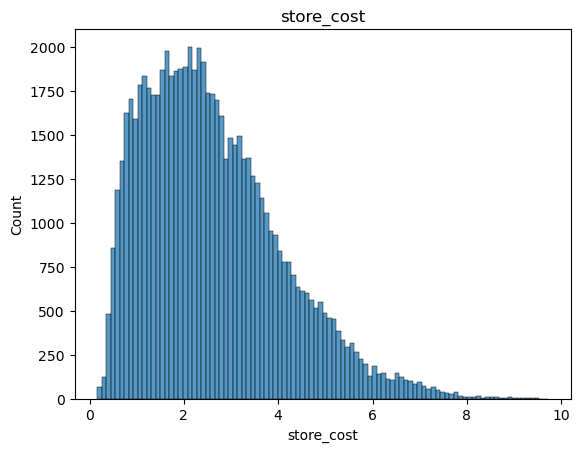

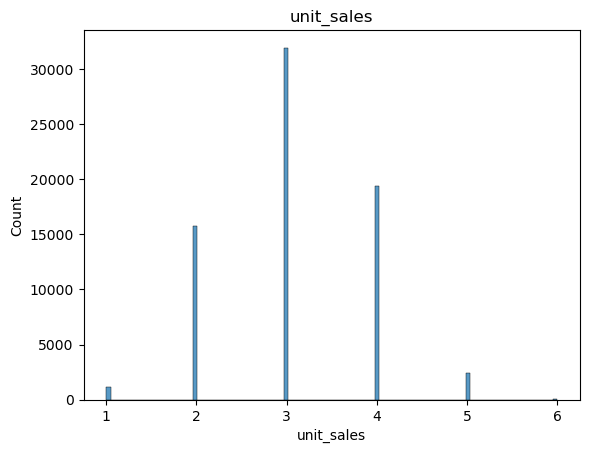

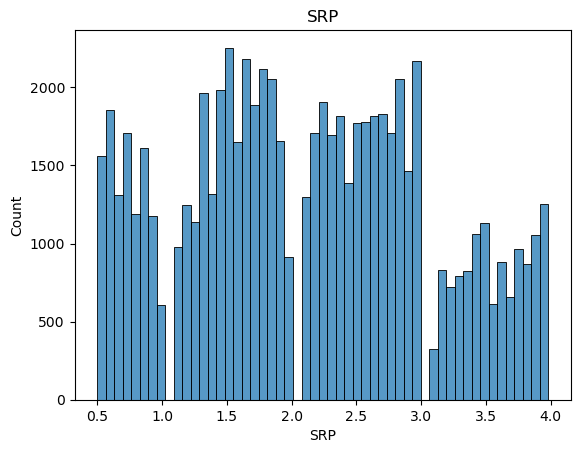

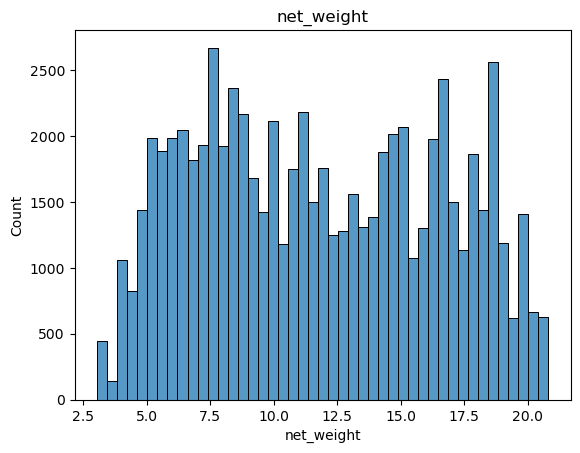

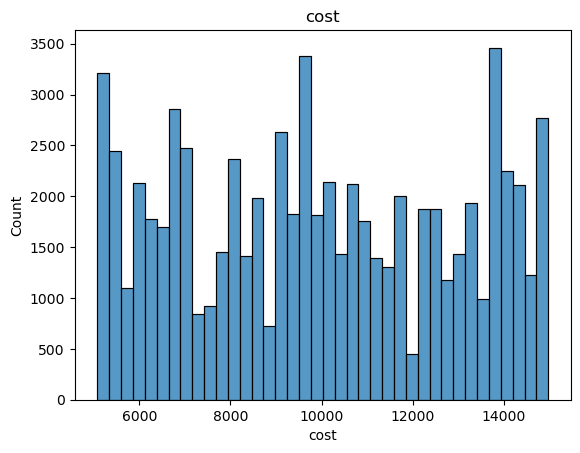

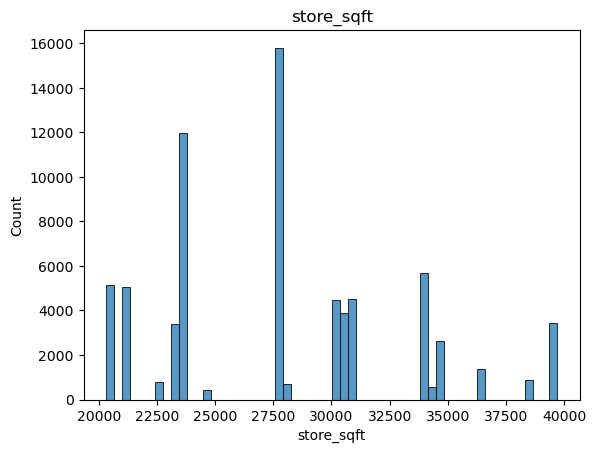

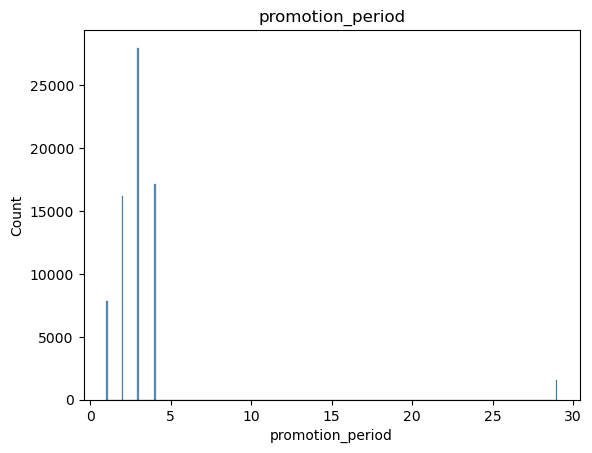

In [36]:
for i in df_num.columns:
    sns.histplot(x=df_num[i])
    plt.title(i)
    plt.show()

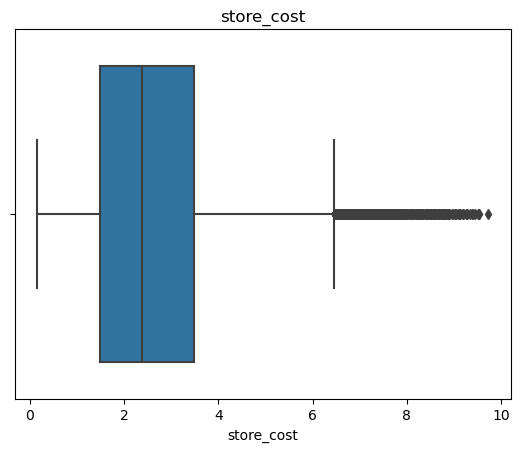

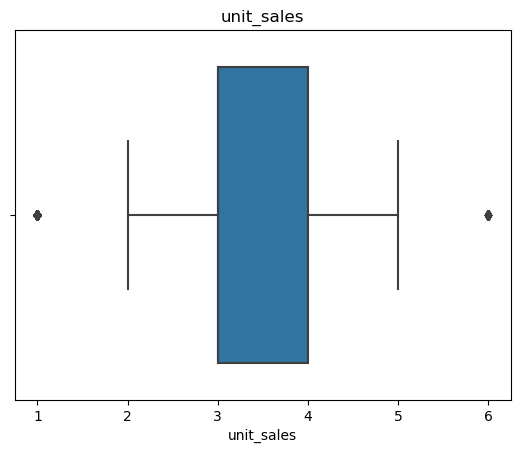

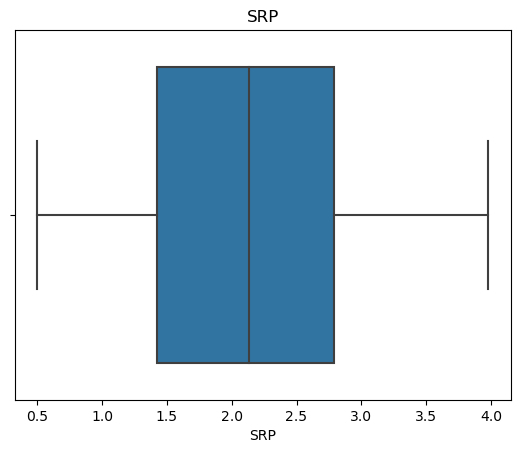

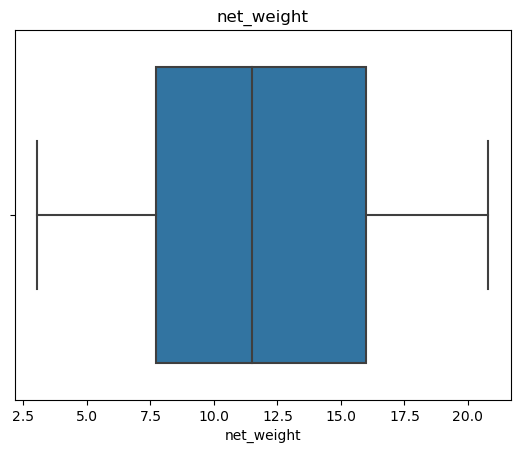

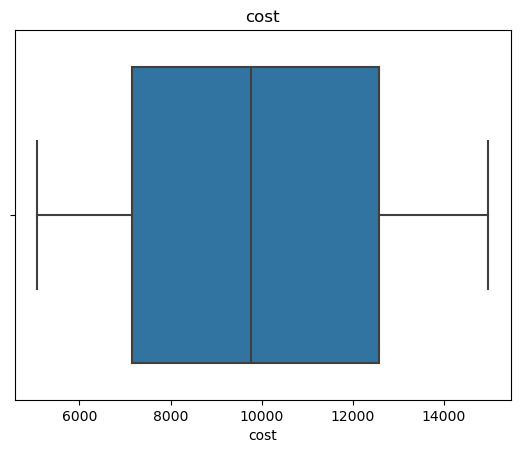

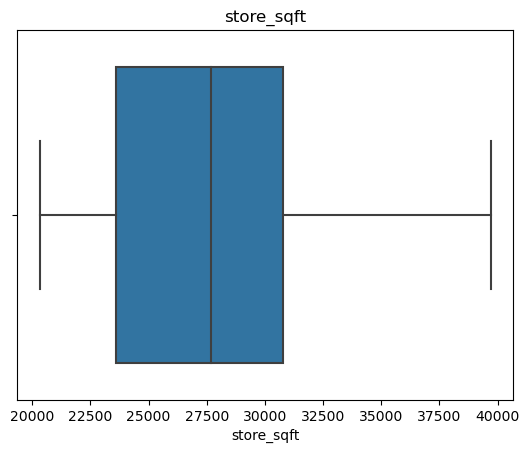

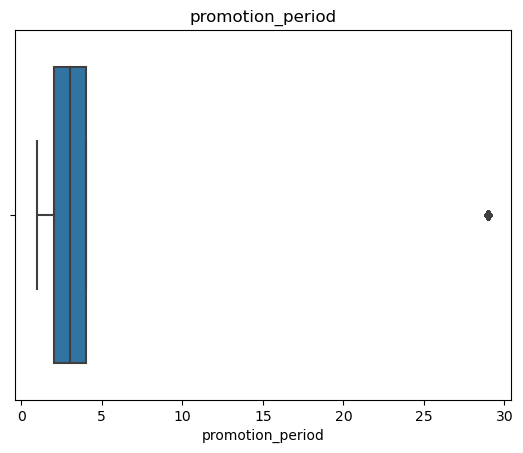

In [37]:
for i in df_num.columns:
    sns.boxplot(x=df_num[i])
    plt.title(i)
    plt.show()

# categorical columns

* mode

In [38]:
for i in df_cat.columns:
    print(i,df_cat[i].mode()[0])

department Produce
promotion_name Price Winners
media_type Daily Paper, Radio
sales_district Los Angeles
store_type Supermarket
yearly_income $30K - $50K
member_card Bronze
occupation Professional
video_store 0


* no of sub categories

In [39]:
for i in df_cat.columns:
    print(i,df_cat[i].nunique())

department 22
promotion_name 49
media_type 13
sales_district 21
store_type 5
yearly_income 8
member_card 4
occupation 5
video_store 2


In [40]:
for i in df_cat.columns:
    print(i,df_cat[i].value_counts(normalize=True), sep="\n")

department
Produce                0.141397
Snack Foods            0.114232
Household              0.101977
Frozen Foods           0.101582
Baking Goods           0.074812
Canned Foods           0.070147
Dairy                  0.064056
Health and Hygiene     0.062685
Beverages              0.050091
Deli                   0.045554
Baked Goods            0.029413
Alcoholic Beverages    0.026516
Snacks                 0.025554
Starchy Foods          0.018403
Periodicals            0.016099
Eggs                   0.015562
Breakfast Foods        0.012961
Canned Products        0.006643
Meat                   0.006473
Checkout               0.006276
Seafood                0.006021
Carousel               0.003548
Name: department, dtype: float64
promotion_name
Price Winners              0.042303
Two Day Sale               0.041469
Weekend Markdown           0.037568
Save-It Sale               0.035773
Price Savers               0.035745
Super Duper Savers         0.033003
One Day Sale         

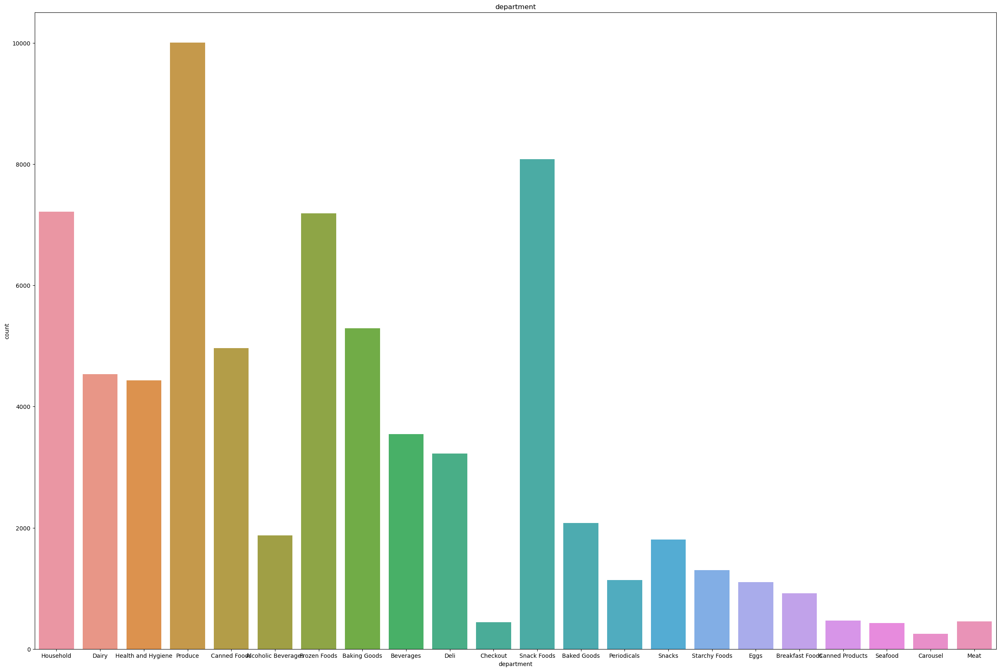

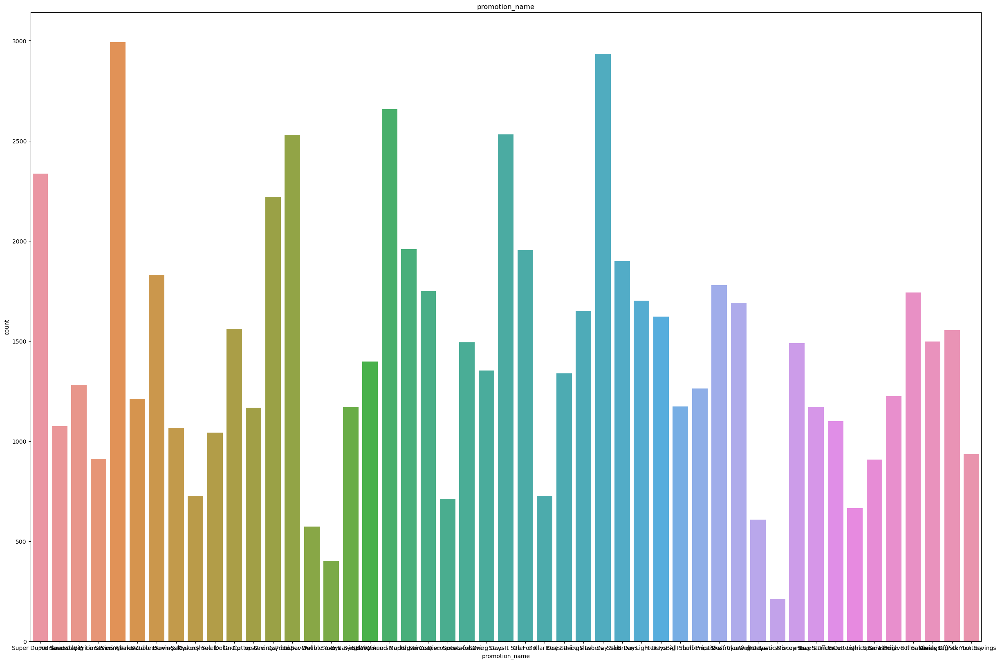

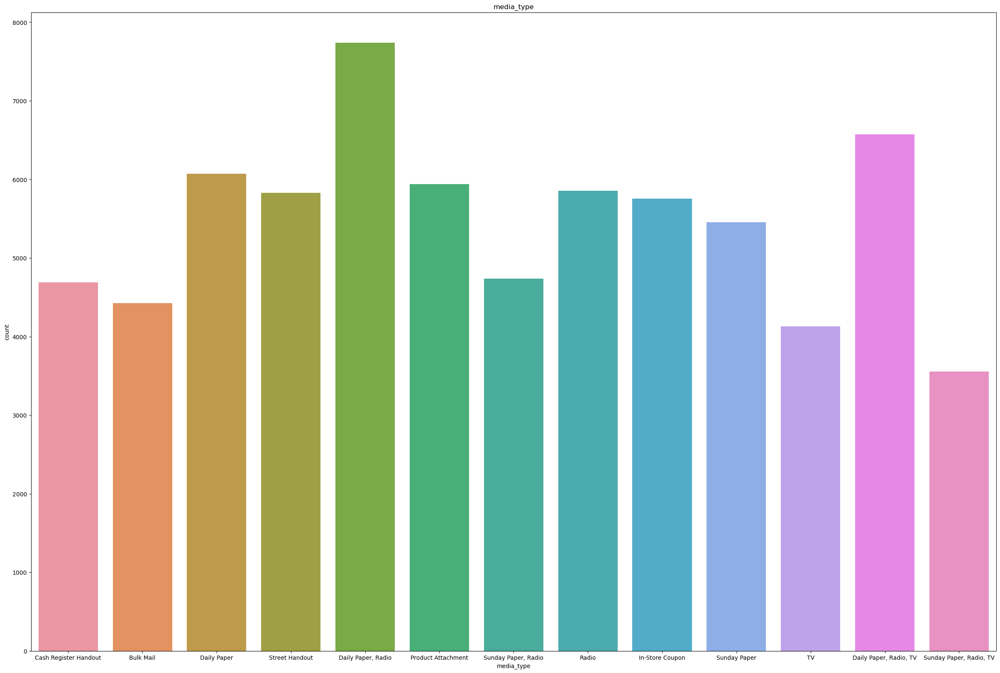

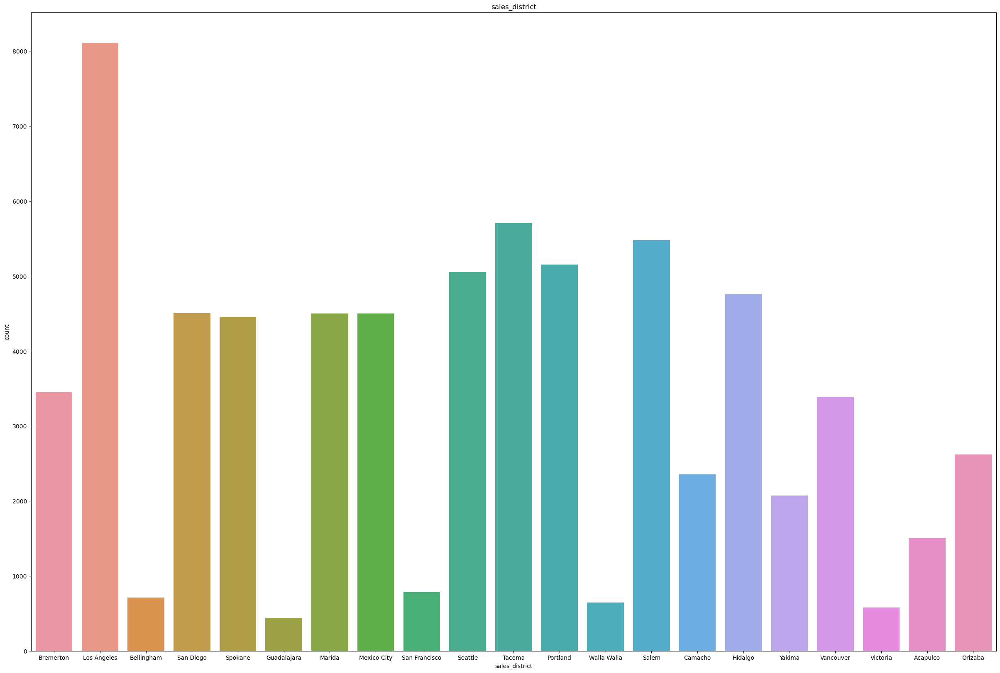

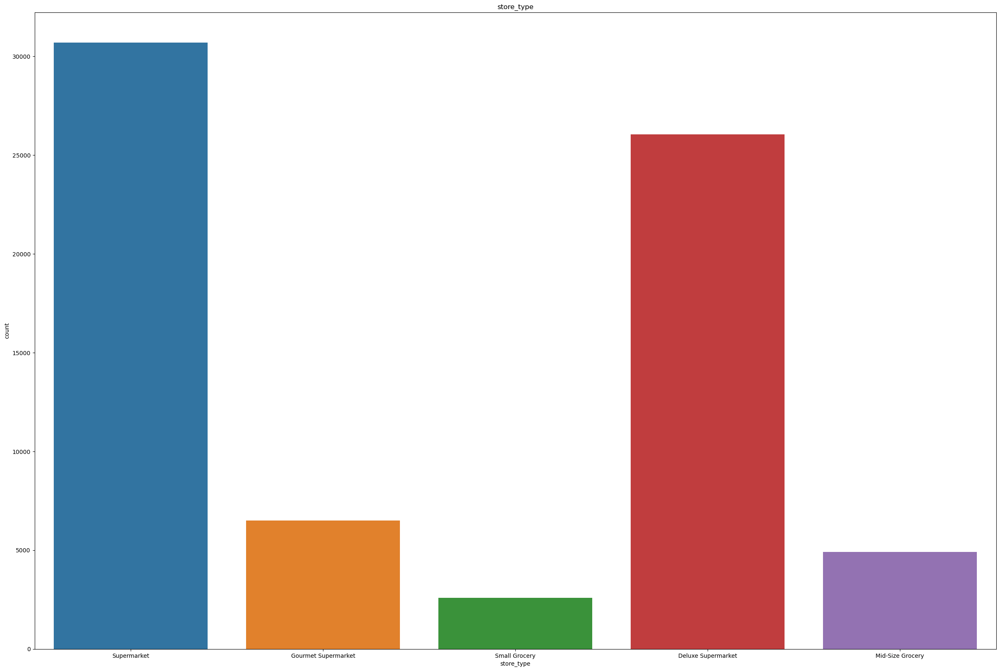

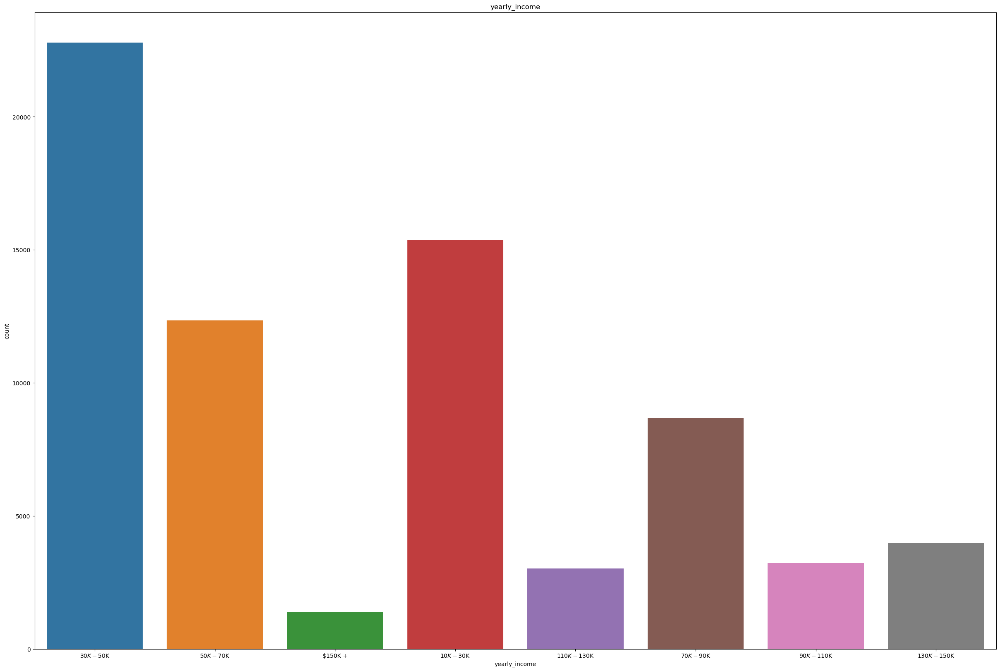

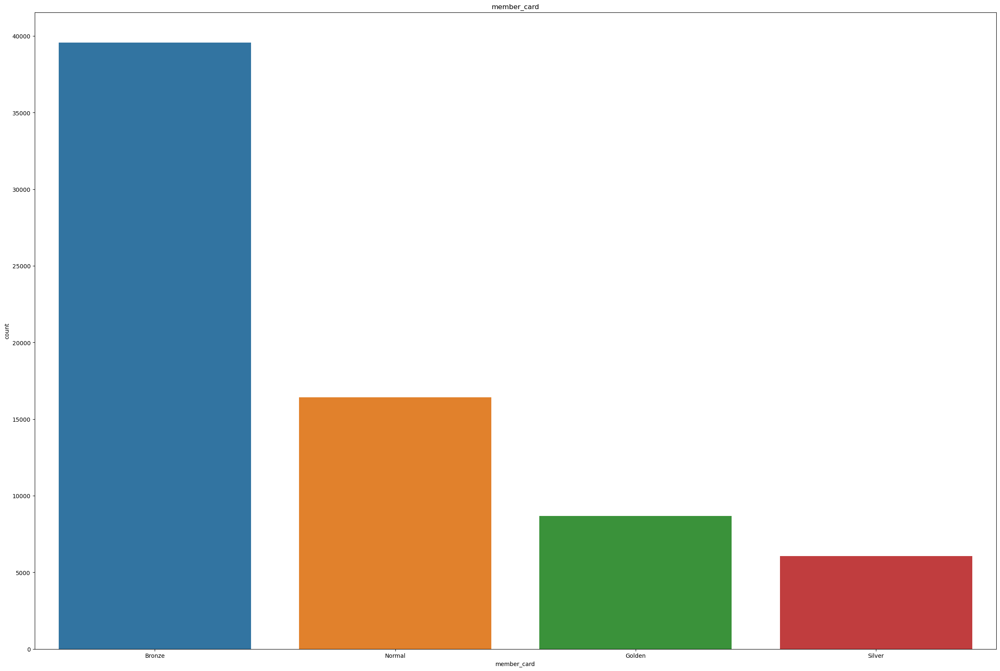

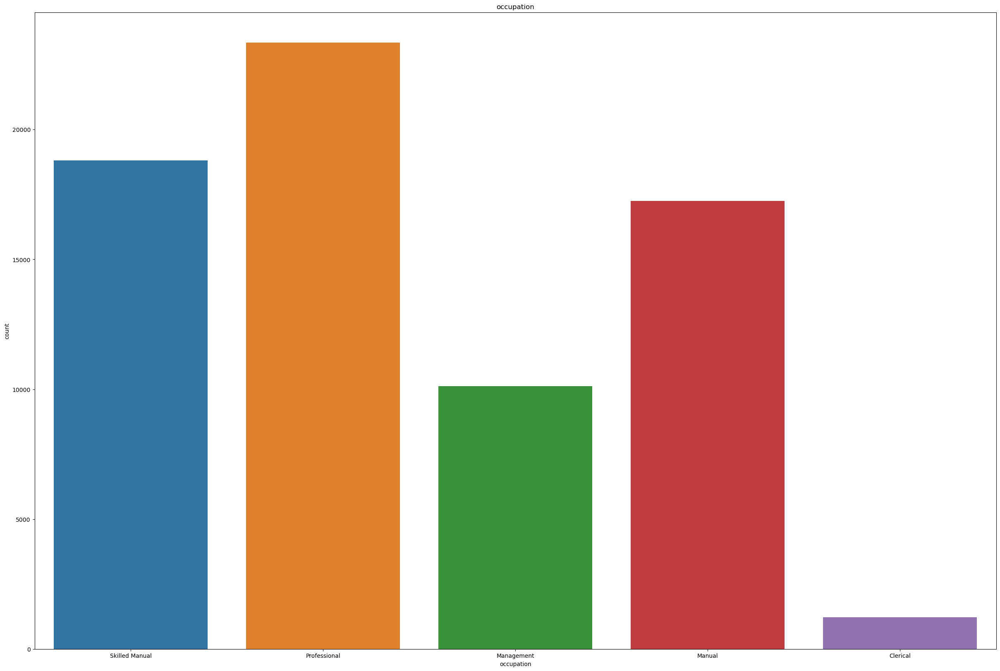

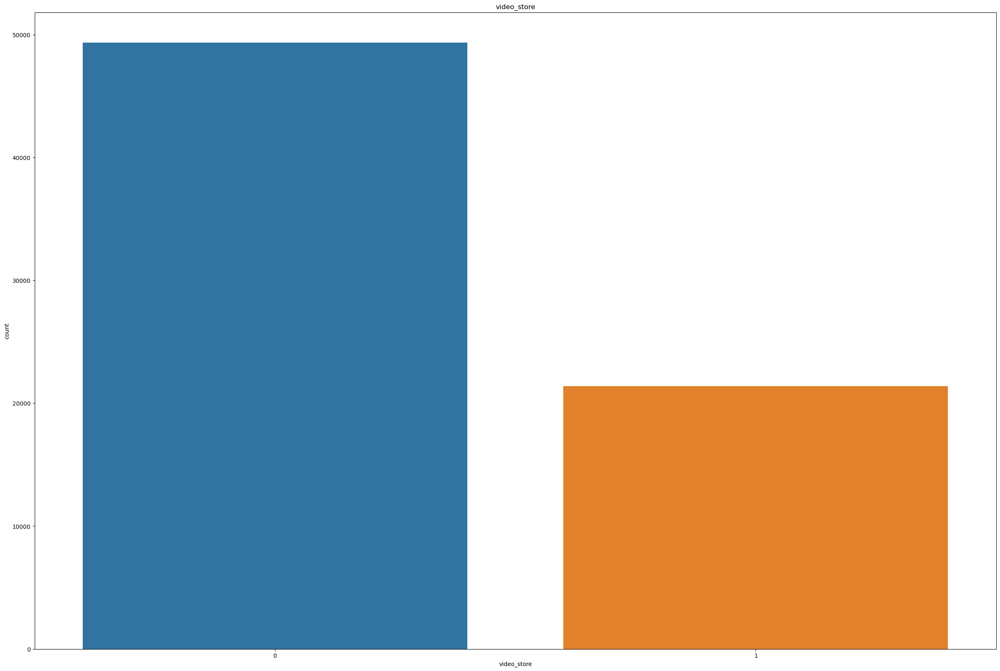

In [42]:
for i in df_cat.columns: 
    plt.figure(figsize=(30,20))
    sns.countplot(x=df_cat[i])
    plt.title(i)
    plt.show()

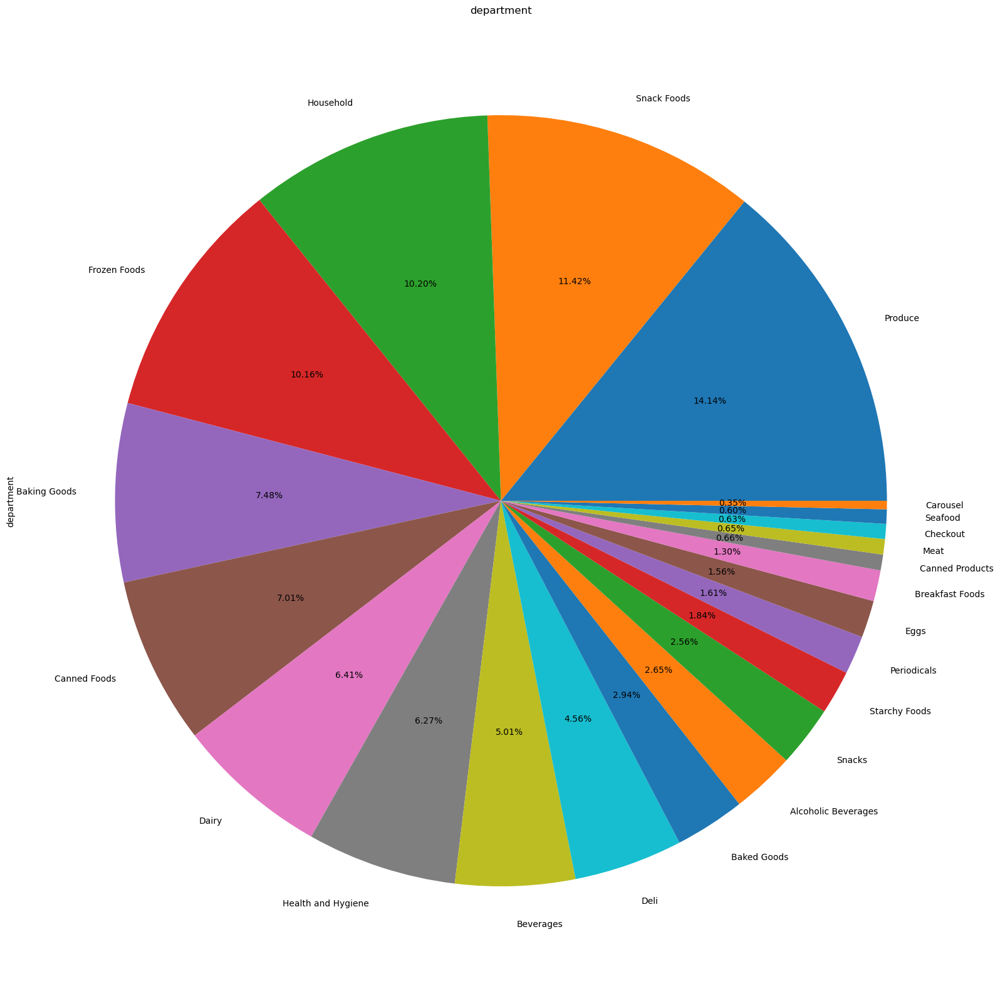

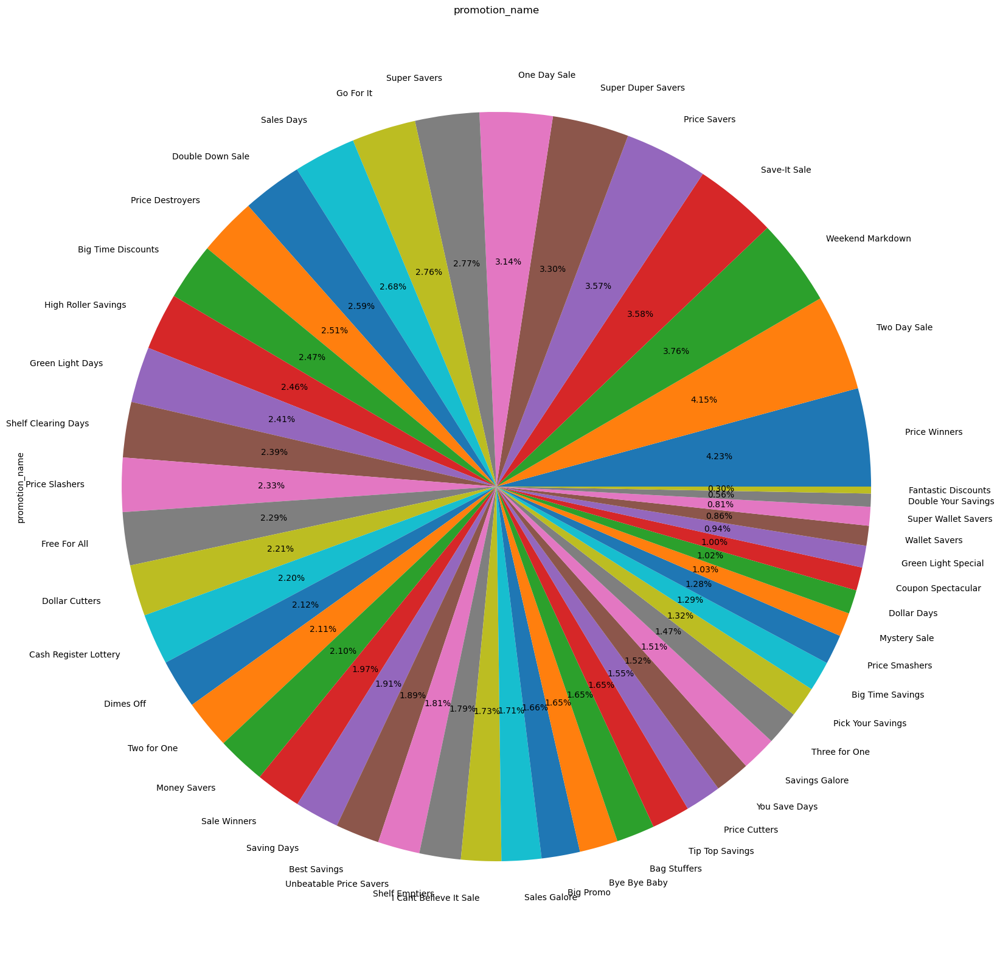

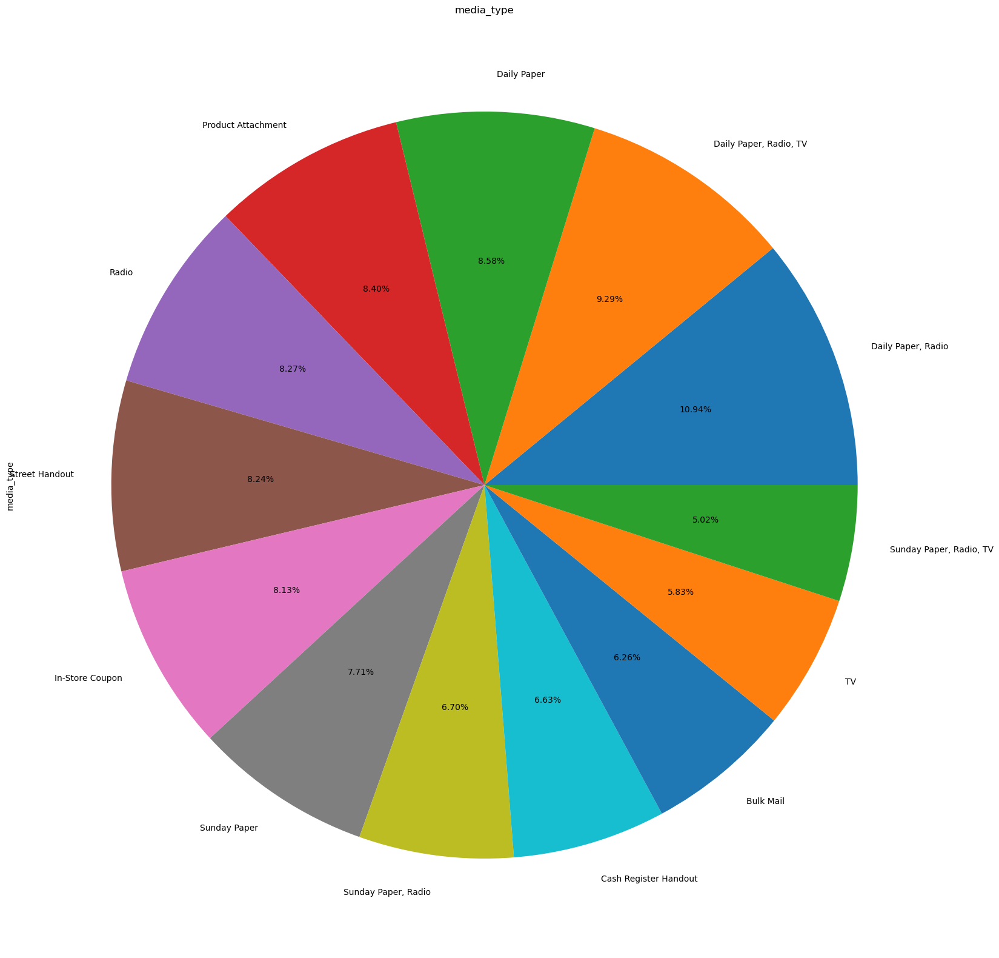

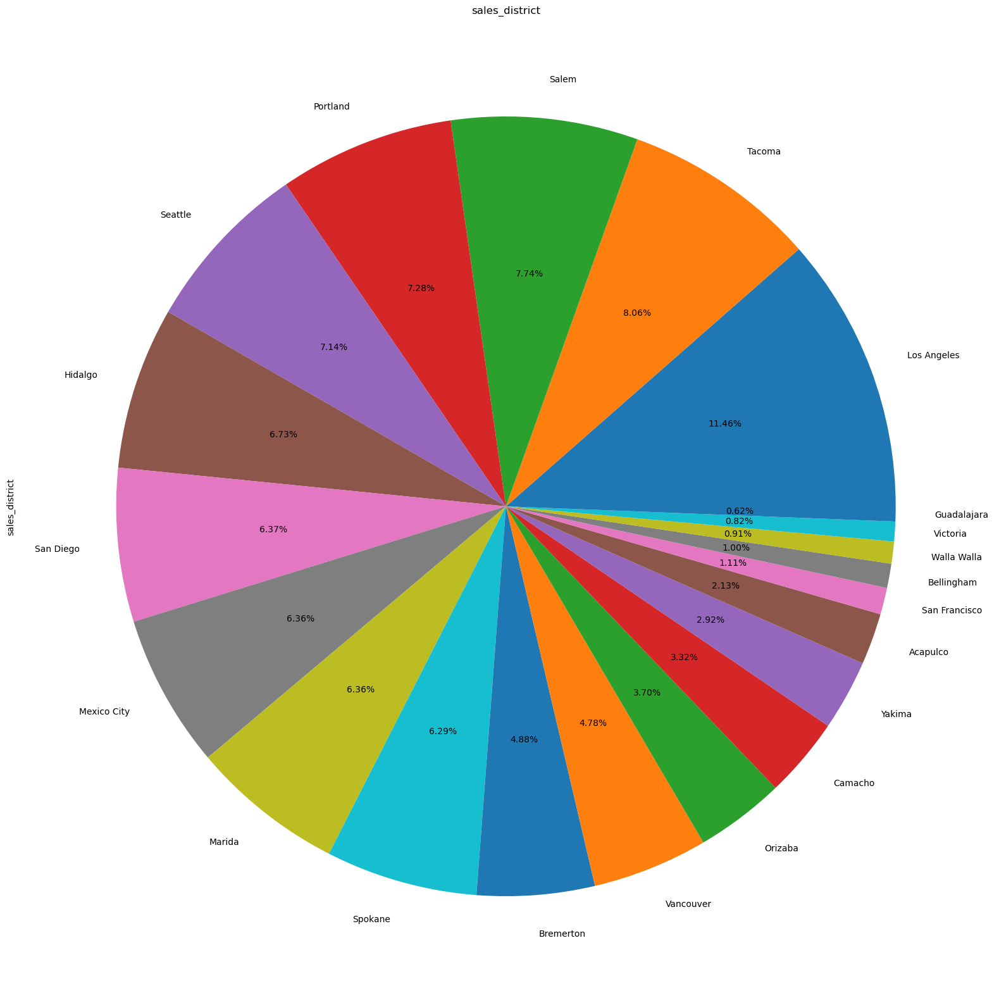

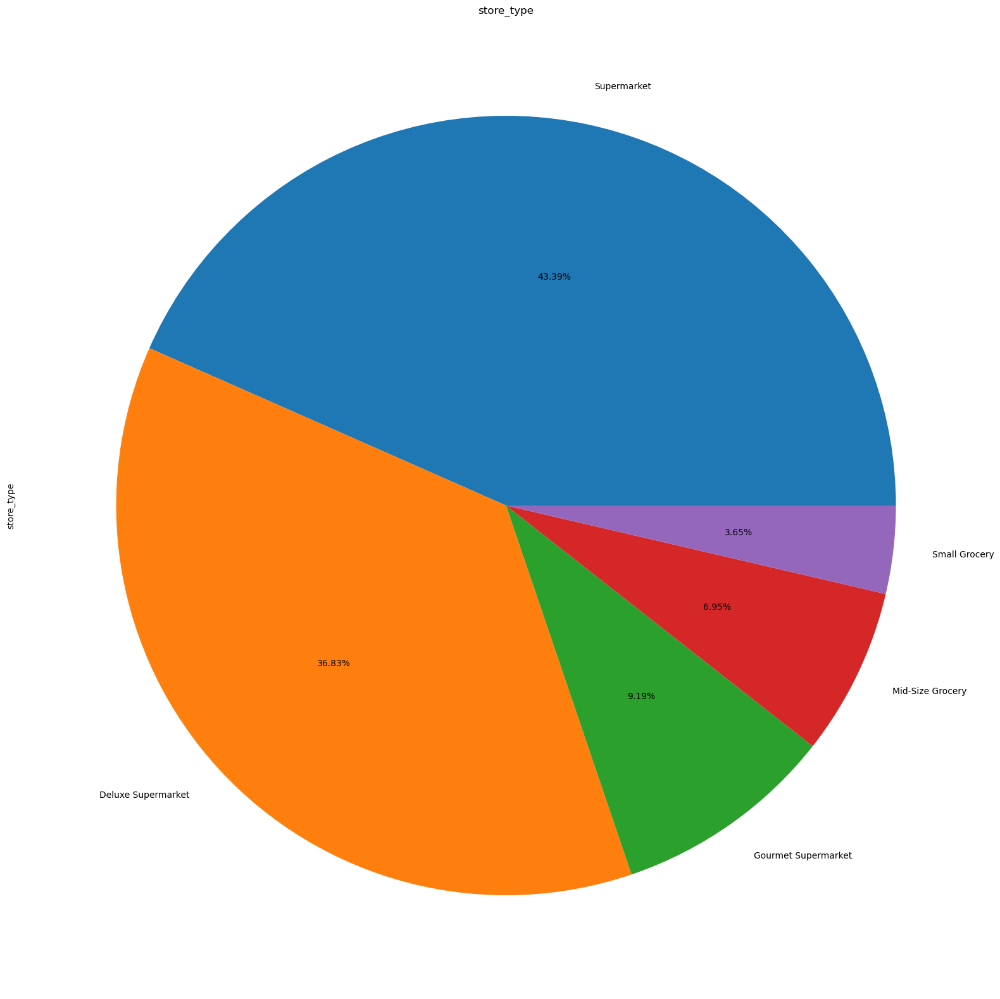

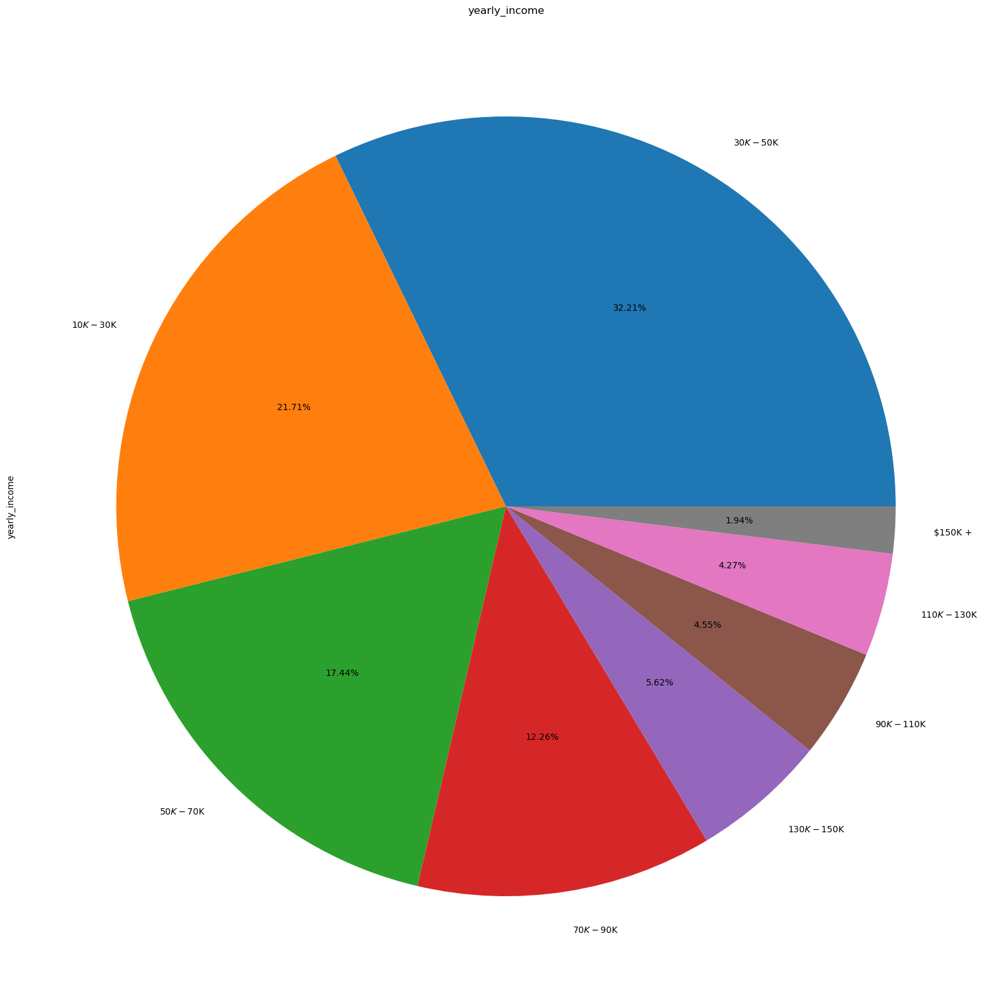

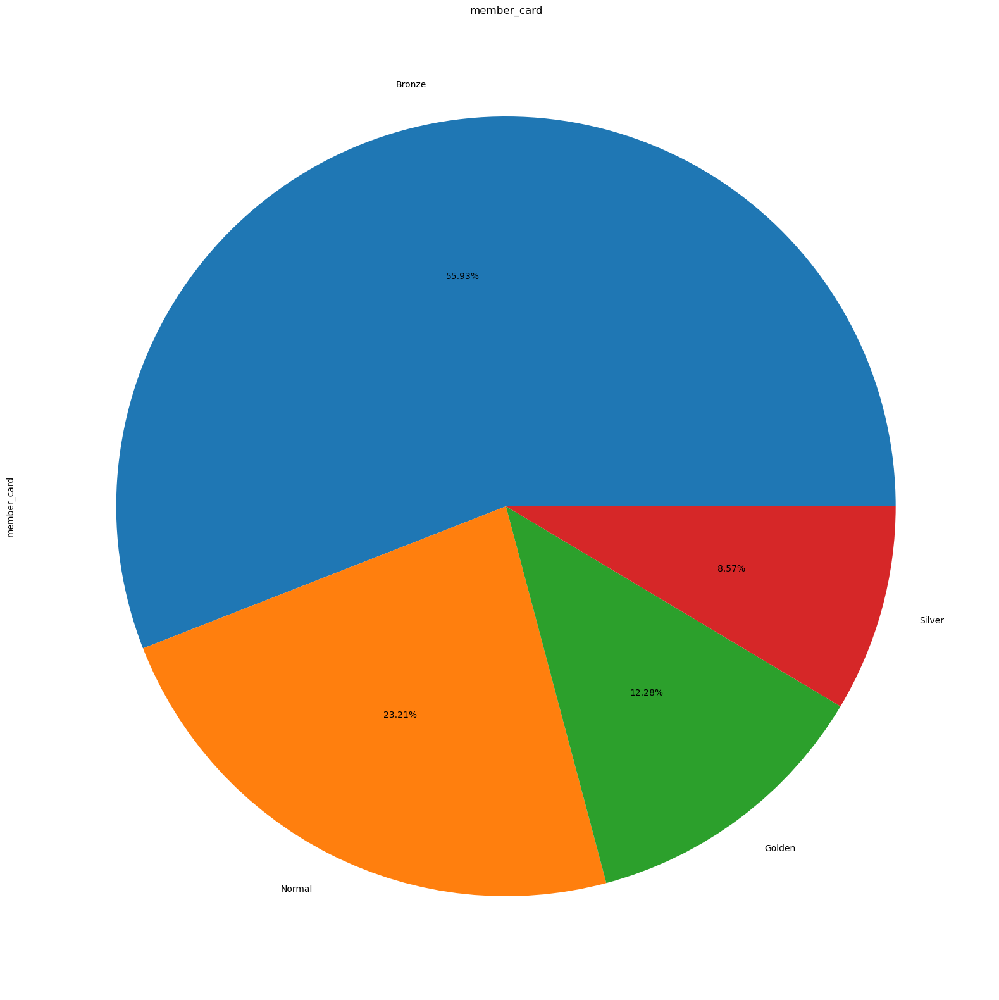

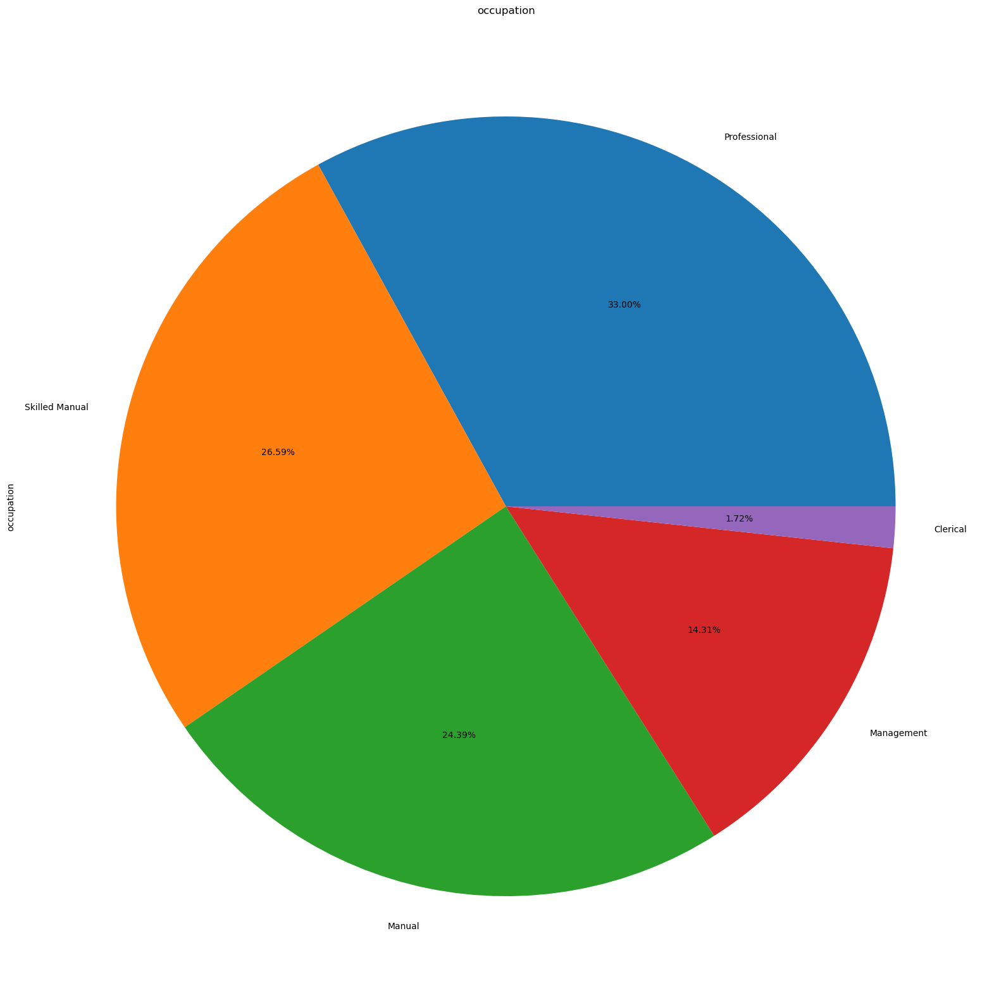

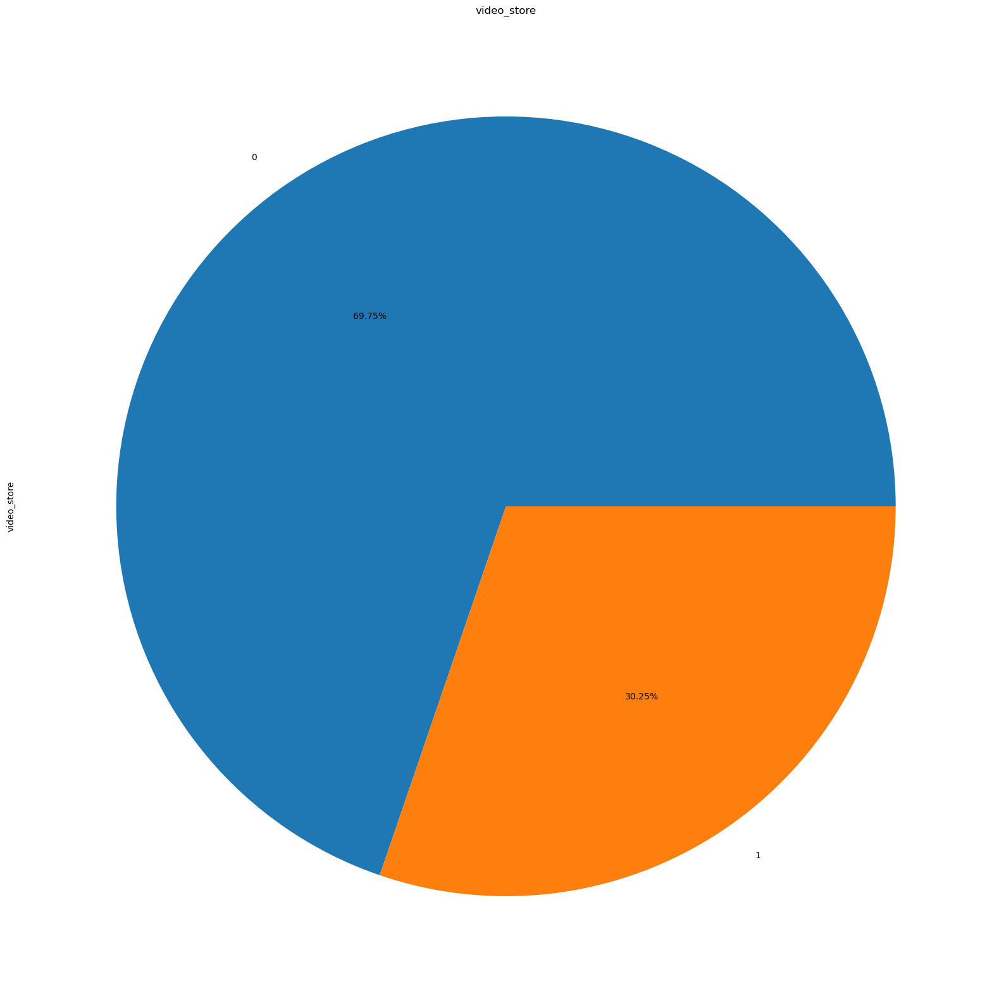

In [44]:
for i in df_cat.columns:
    plt.figure(figsize=(30,20))
    df_cat[i].value_counts().plot(kind='pie',autopct='%.2f%%')
    plt.title(i)
    plt.show()

# Bivariate Analysis

# categorical vs categorical

# tabulation

In [45]:
for i in df_cat.columns:
    for j in df_cat.columns:
        print(f"{i} vs {j}")
        print(pd.crosstab(df_cat[i],df_cat[j]))

department vs department
department           Alcoholic Beverages  Baked Goods  Baking Goods  \
department                                                            
Alcoholic Beverages                 1876            0             0   
Baked Goods                            0         2081             0   
Baking Goods                           0            0          5293   
Beverages                              0            0             0   
Breakfast Foods                        0            0             0   
Canned Foods                           0            0             0   
Canned Products                        0            0             0   
Carousel                               0            0             0   
Checkout                               0            0             0   
Dairy                                  0            0             0   
Deli                                   0            0             0   
Eggs                                   0            

occupation           Clerical  Management  Manual  Professional  \
department                                                        
Alcoholic Beverages        22         287     470           599   
Baked Goods                42         277     541           695   
Baking Goods               82         745    1324          1794   
Beverages                  57         504     858          1159   
Breakfast Foods            13         128     234           290   
Canned Foods               93         709    1238          1642   
Canned Products             5          59     130           152   
Carousel                    7          40      64            76   
Checkout                    6          67     101           155   
Dairy                      89         657    1118          1467   
Deli                       45         457     819          1033   
Eggs                       17         177     257           364   
Frozen Foods              132        1007    1705          241

store_type               Deluxe Supermarket  Gourmet Supermarket  \
promotion_name                                                     
Bag Stuffers                           1009                    0   
Best Savings                            192                  174   
Big Promo                               682                  151   
Big Time Discounts                      391                    0   
Big Time Savings                        438                   80   
Bye Bye Baby                            263                  115   
Cash Register Lottery                  1555                    0   
Coupon Spectacular                      248                    0   
Dimes Off                               926                    0   
Dollar Cutters                          410                    0   
Dollar Days                             404                    0   
Double Down Sale                       1158                  127   
Double Your Savings                       0     

sales_district           Acapulco  Bellingham  Bremerton  Camacho  \
media_type                                                          
Bulk Mail                     149          52        146        0   
Cash Register Handout         161          89        524        0   
Daily Paper                     0         137        146      486   
Daily Paper, Radio              0          74        261      344   
Daily Paper, Radio, TV          0          61        301      455   
In-Store Coupon               149          45        237        0   
Product Attachment            152          69        133      216   
Radio                         174          32        337        0   
Street Handout                170          62          0      138   
Sunday Paper                  183          18        615        0   
Sunday Paper, Radio           228           0        135        0   
Sunday Paper, Radio, TV         0          24        345      398   
TV                            140 

media_type      Bulk Mail  Cash Register Handout  Daily Paper  \
sales_district                                                  
Acapulco              149                    161            0   
Bellingham             52                     89          137   
Bremerton             146                    524          146   
Camacho                 0                      0          486   
Guadalajara            54                     90           16   
Hidalgo               509                    639            0   
Los Angeles           988                    323         2137   
Marida                  0                      0            0   
Mexico City           477                    327          350   
Orizaba               121                    151          309   
Portland                0                    869          762   
Salem                   0                      0          147   
San Diego             483                    443          195   
San Francisco          45

media_type           Bulk Mail  Cash Register Handout  Daily Paper  \
store_type                                                           
Deluxe Supermarket         890                   1355          996   
Gourmet Supermarket        486                    160         1251   
Mid-Size Grocery           150                    283          547   
Small Grocery              208                    320          185   
Supermarket               2693                   2571         3092   

media_type           Daily Paper, Radio  Daily Paper, Radio, TV  \
store_type                                                        
Deluxe Supermarket                 3509                    1536   
Gourmet Supermarket                 775                    1255   
Mid-Size Grocery                    577                     281   
Small Grocery                       233                     135   
Supermarket                        2645                    3365   

media_type           In-Store Coupon  P

media_type     Bulk Mail  Cash Register Handout  Daily Paper  \
yearly_income                                                  
$10K - $30K         1048                   1170         1275   
$110K - $130K        171                    191          234   
$130K - $150K        194                    250          431   
$150K +               90                     83          132   
$30K - $50K         1433                   1534         1941   
$50K - $70K          783                    732         1123   
$70K - $90K          494                    530          774   
$90K - $110K         214                    199          161   

media_type     Daily Paper, Radio  Daily Paper, Radio, TV  In-Store Coupon  \
yearly_income                                                                
$10K - $30K                  1733                    1464             1211   
$110K - $130K                 357                     282              248   
$130K - $150K                 428              

sales_district  Acapulco  Bellingham  Bremerton  Camacho  Guadalajara  \
member_card                                                             
Bronze               877         353       1827     1326          235   
Golden               170          75        495      332           31   
Normal               375         167        914      433          128   
Silver                84         116        215      261           45   

sales_district  Hidalgo  Los Angeles  Marida  Mexico City  Orizaba  ...  \
member_card                                                         ...   
Bronze             2423         4355    2748         2567     1709  ...   
Golden              779          908     679          454      267  ...   
Normal             1191         2002     710         1017      588  ...   
Silver              368          846     361          461       57  ...   

sales_district  Salem  San Diego  San Francisco  Seattle  Spokane  Tacoma  \
member_card                      

store_type      Deluxe Supermarket  Gourmet Supermarket  Mid-Size Grocery  \
occupation                                                                  
Clerical                       399                  101                55   
Management                    3561                  947               781   
Manual                        6238                 1575              1101   
Professional                  8721                 2260              1567   
Skilled Manual                7139                 1620              1411   

store_type      Small Grocery  Supermarket  
occupation                                  
Clerical                   48          611  
Management                381         4453  
Manual                    723         7617  
Professional              796        10003  
Skilled Manual            631         8012  
occupation vs yearly_income
yearly_income   $10K - $30K  $110K - $130K  $130K - $150K  $150K +  \
occupation                                     

yearly_income  $10K - $30K  $110K - $130K  $130K - $150K  $150K +  \
video_store                                                         
0                    10917           2121           2803      950   
1                     4440            902           1172      426   

yearly_income  $30K - $50K  $50K - $70K  $70K - $90K  $90K - $110K  
video_store                                                         
0                    15852         8883         5839          1985  
1                     6935         3457         2832          1237  
video_store vs member_card
member_card  Bronze  Golden  Normal  Silver
video_store                                
0             27753    5980   11553    4064
1             11821    2709    4869    2002
video_store vs occupation
occupation   Clerical  Management  Manual  Professional  Skilled Manual
video_store                                                            
0                 834        7076   12170         16224           13046
1 

# visualization

* grouped bar plot

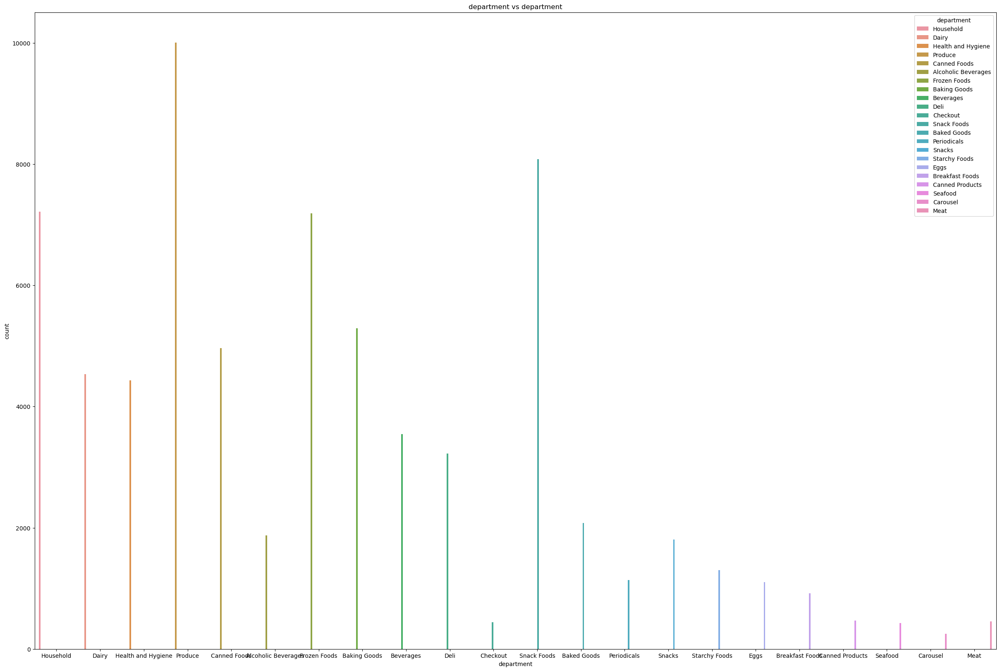

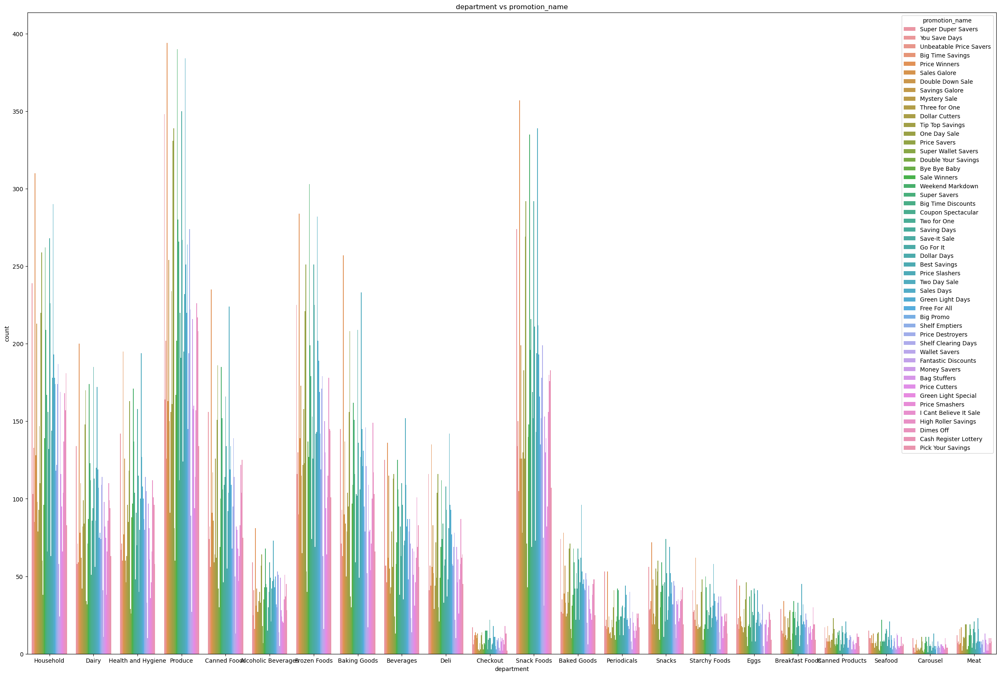

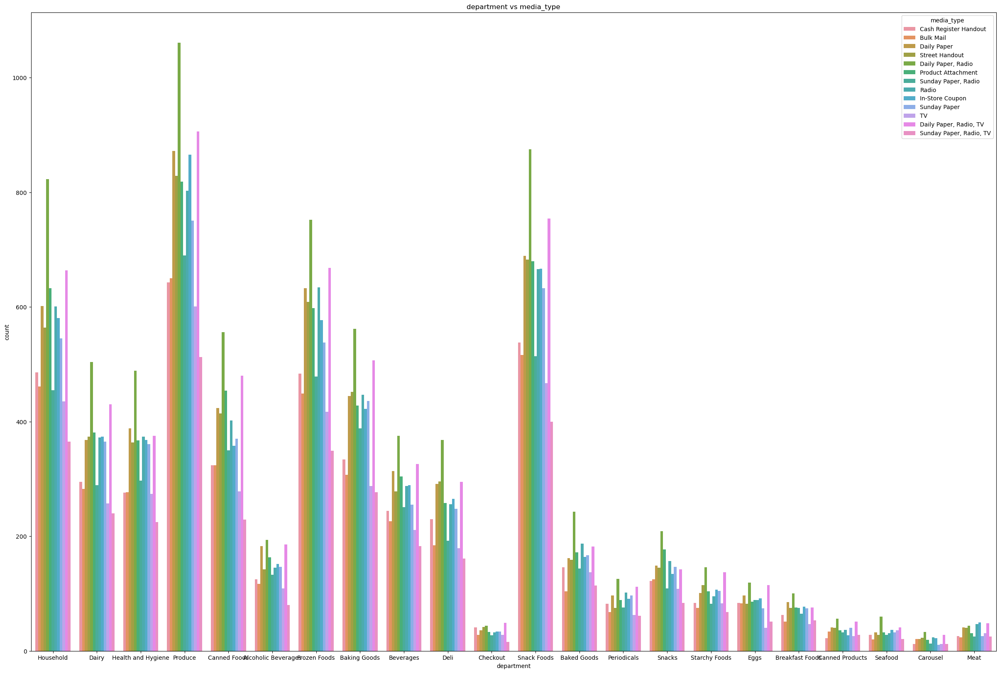

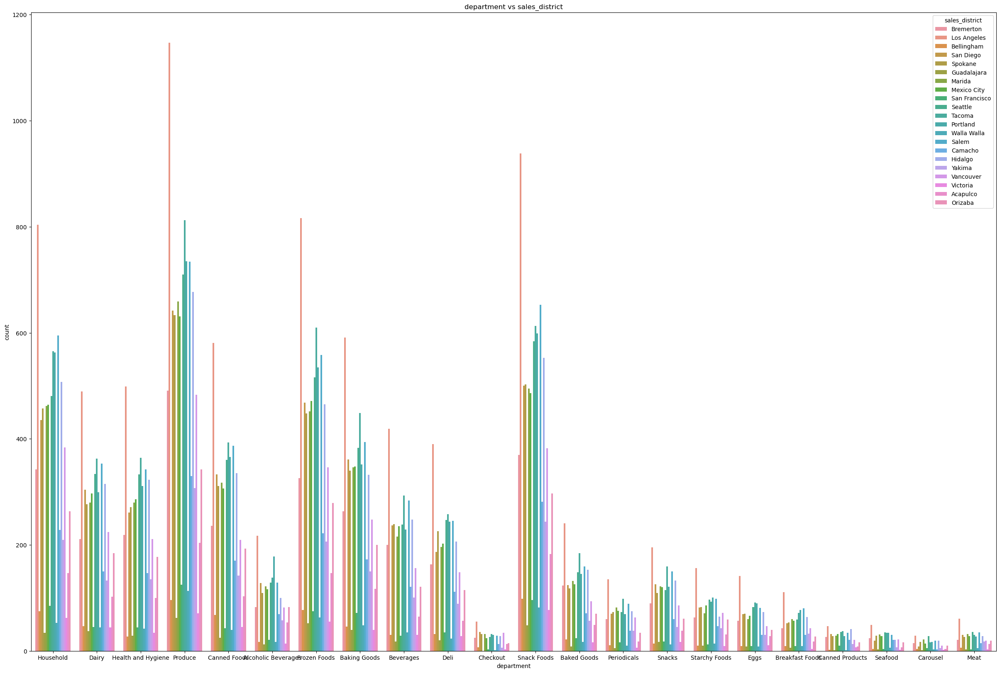

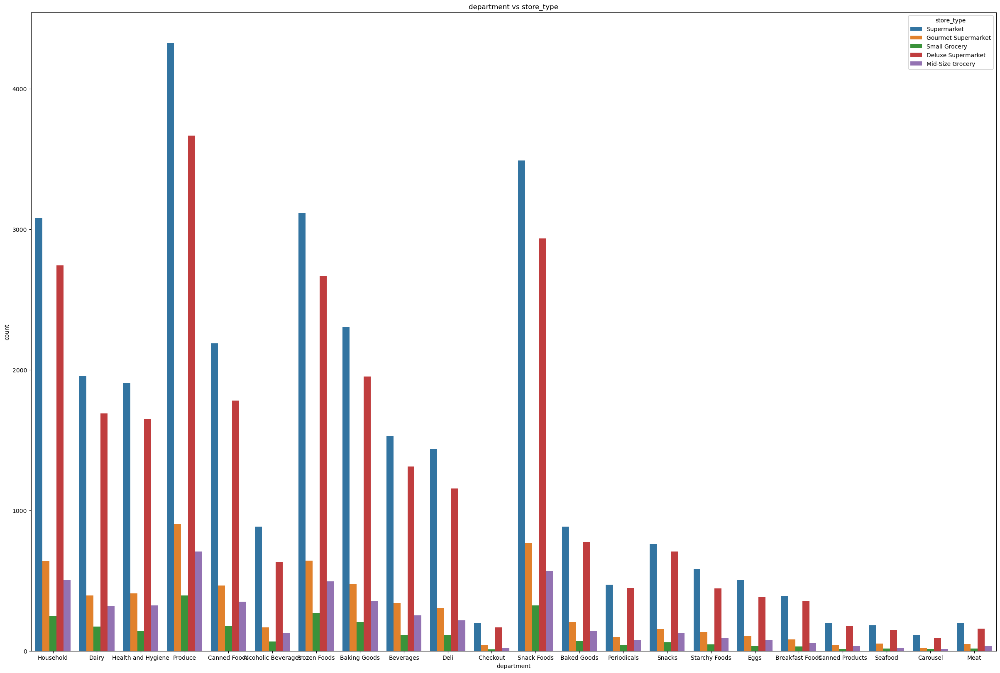

...

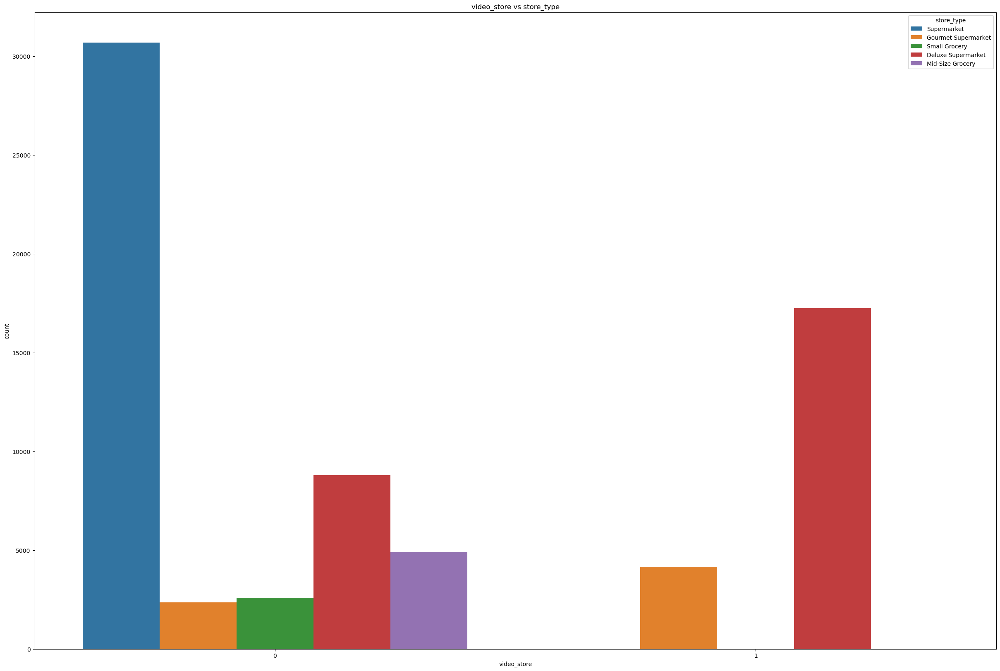

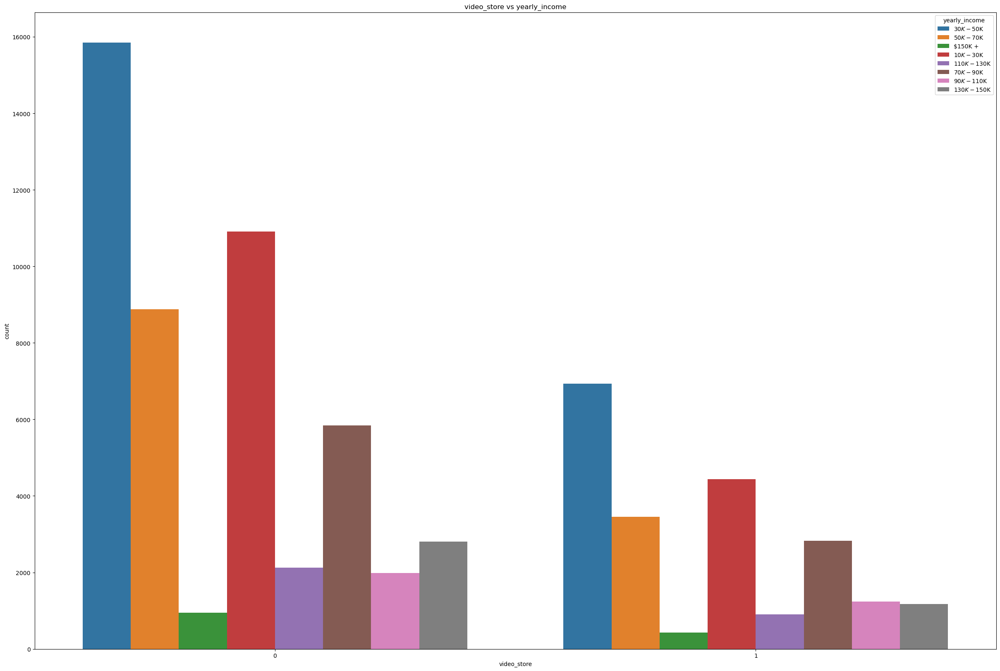

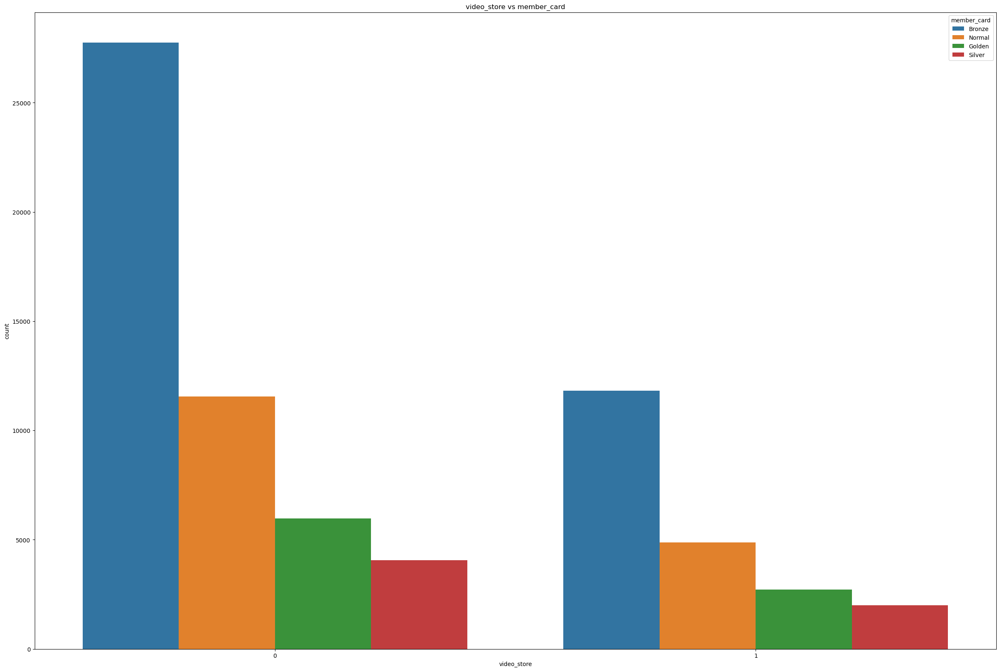

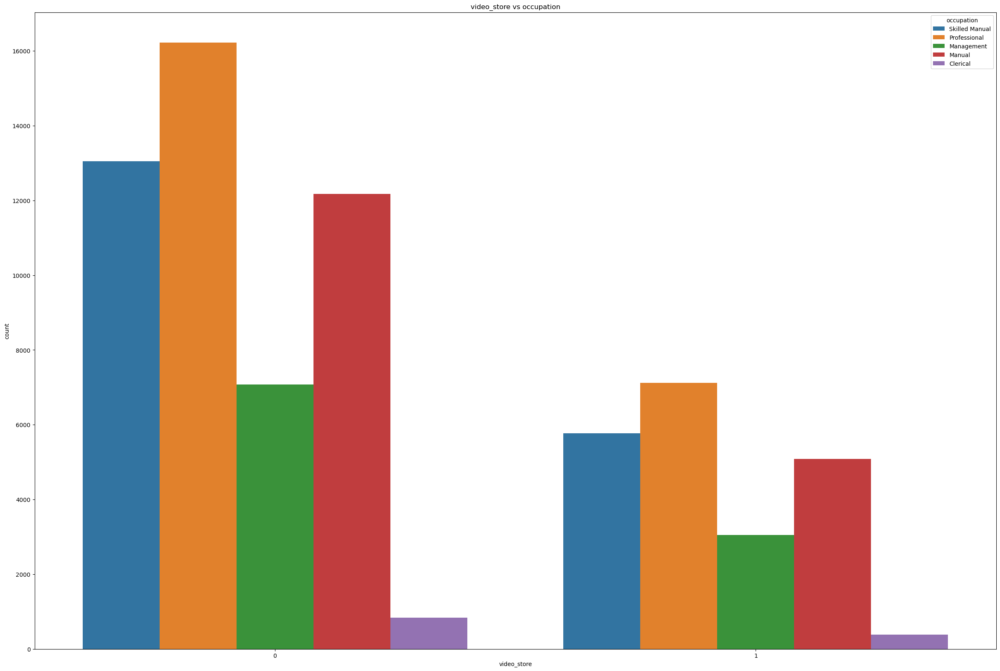

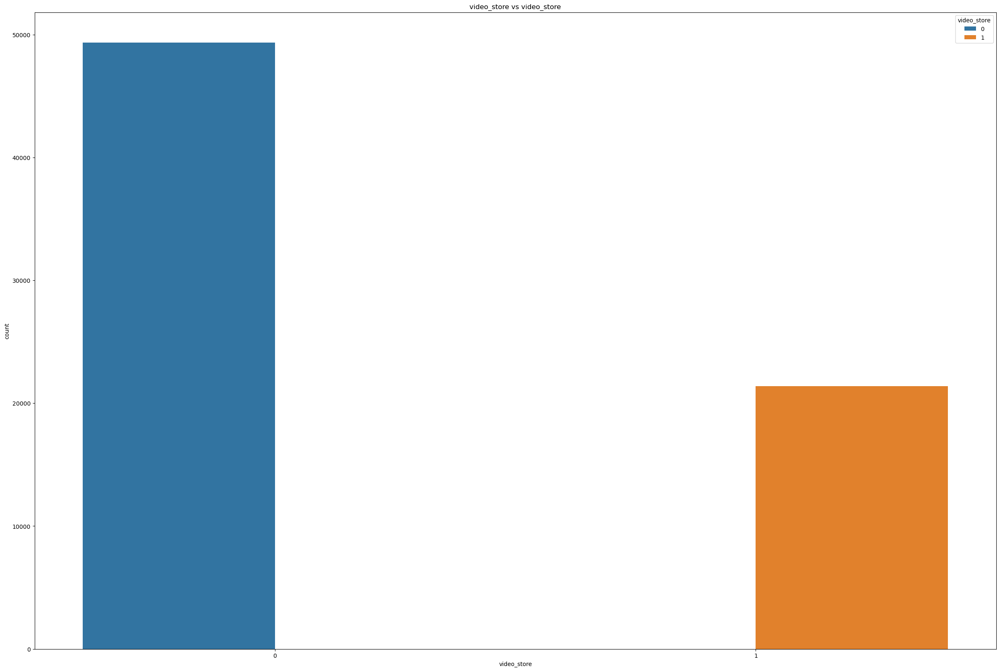

In [47]:
for i in df_cat.columns:
    for j in df_cat.columns:
        plt.figure(figsize=(30,20))
        sns.countplot(x=df_cat[i],hue=df_cat[j])
        plt.title(f"{i} vs {j}")
        plt.show()

* stacked bar plot

<Figure size 4000x4000 with 0 Axes>

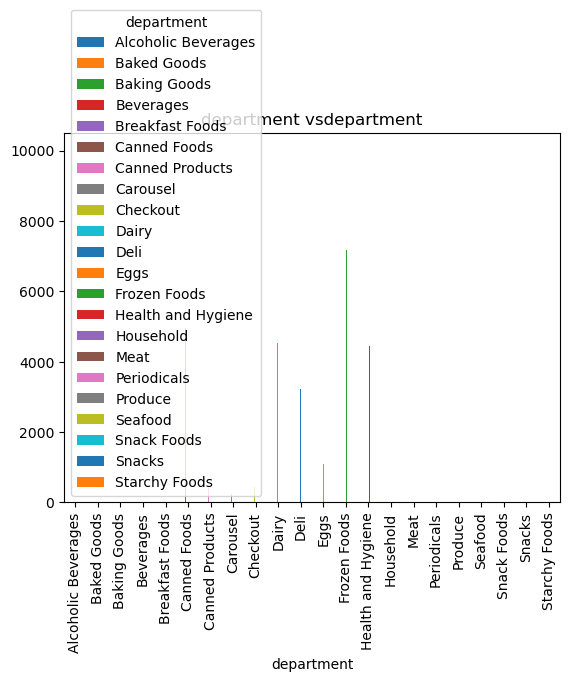

<Figure size 4000x4000 with 0 Axes>

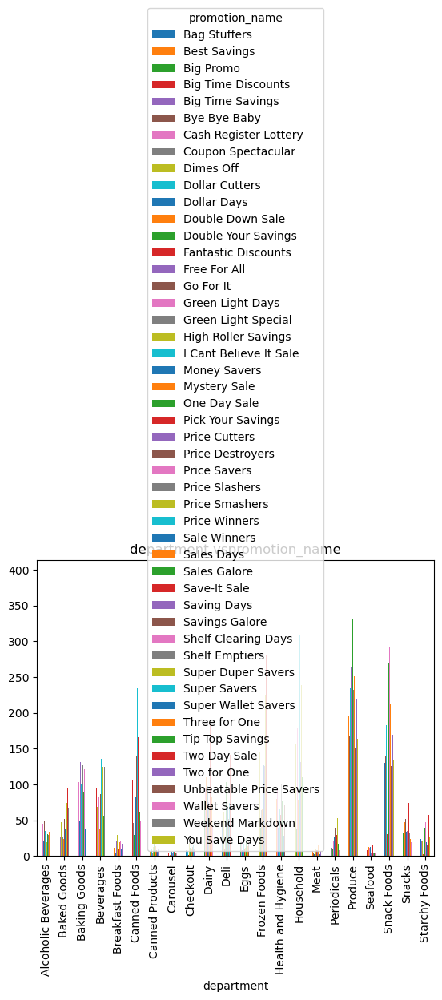

<Figure size 4000x4000 with 0 Axes>

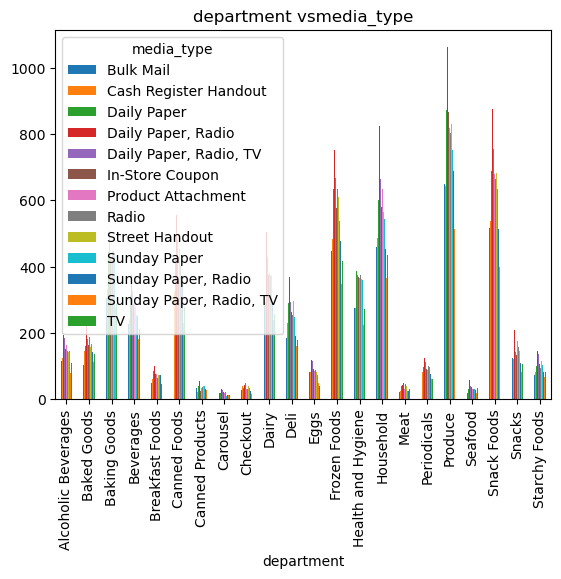

<Figure size 4000x4000 with 0 Axes>

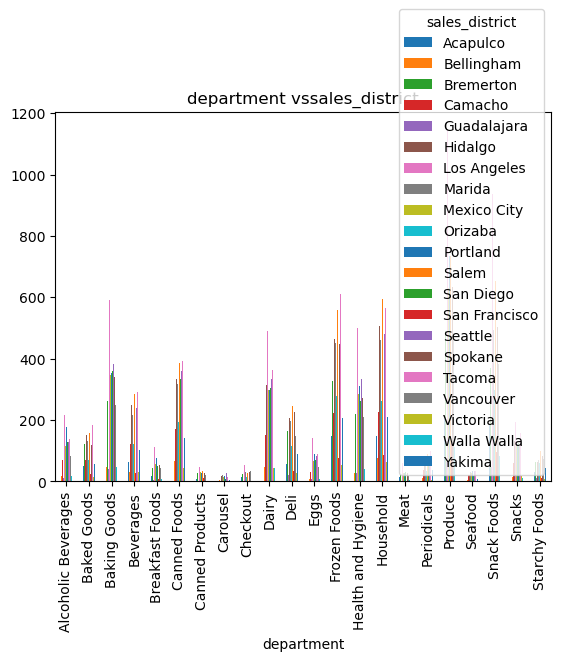

<Figure size 4000x4000 with 0 Axes>

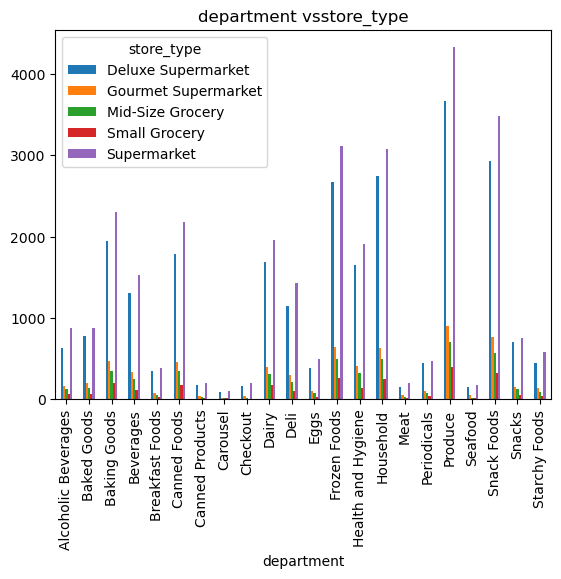

<Figure size 4000x4000 with 0 Axes>

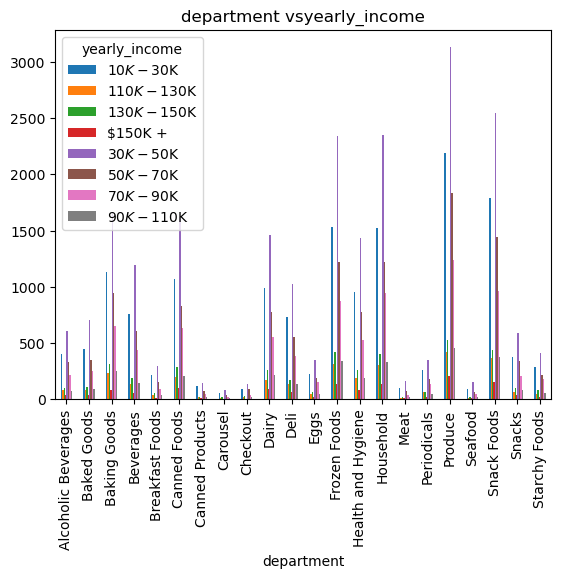

<Figure size 4000x4000 with 0 Axes>

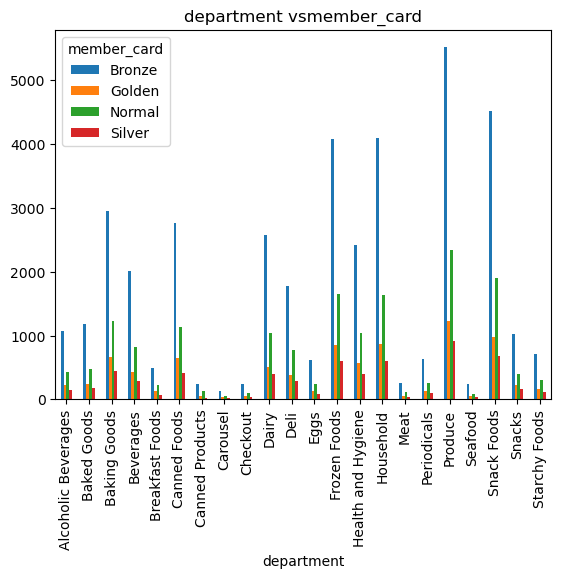

<Figure size 4000x4000 with 0 Axes>

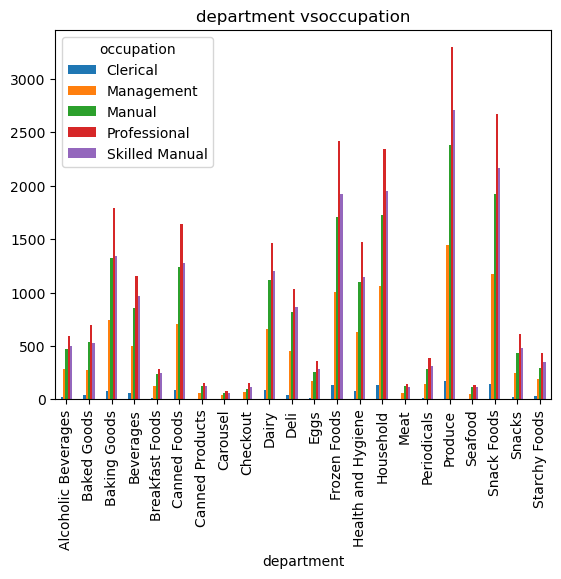

<Figure size 4000x4000 with 0 Axes>

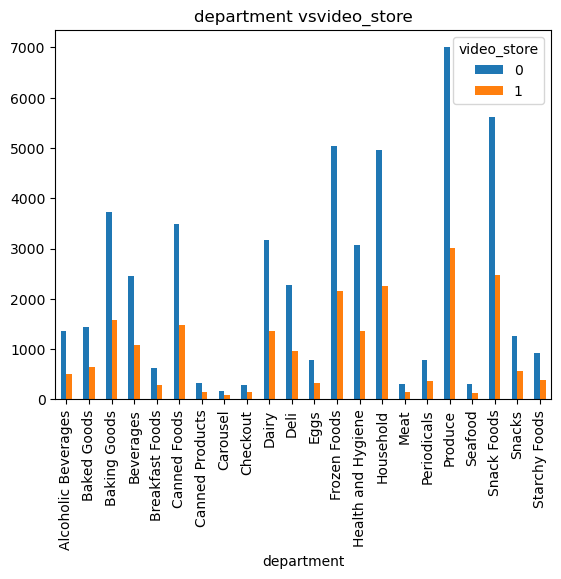

<Figure size 4000x4000 with 0 Axes>

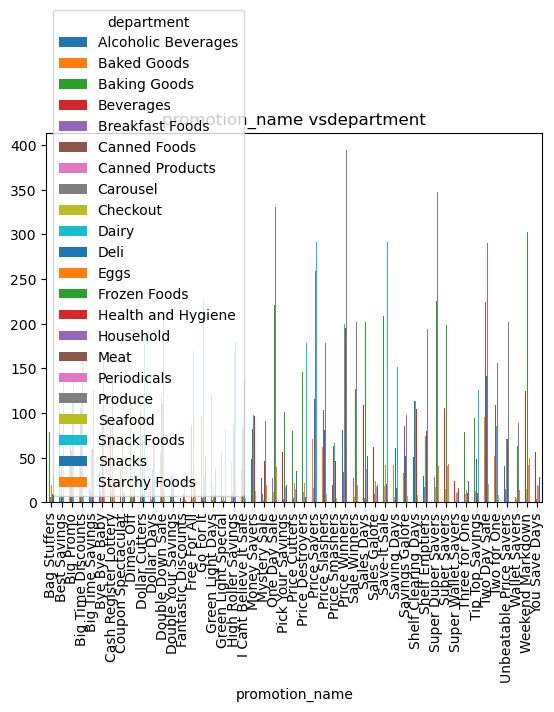

<Figure size 4000x4000 with 0 Axes>

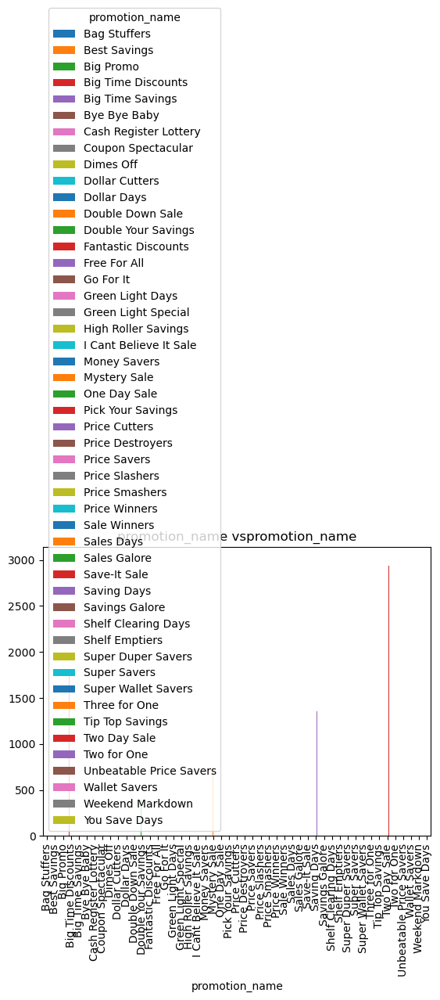

<Figure size 4000x4000 with 0 Axes>

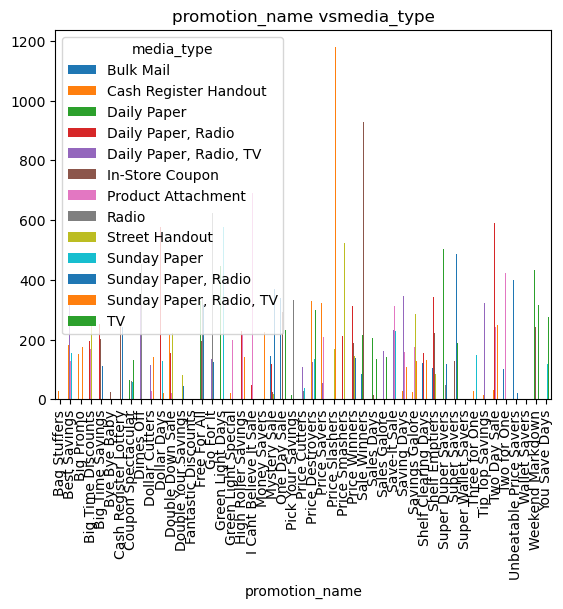

<Figure size 4000x4000 with 0 Axes>

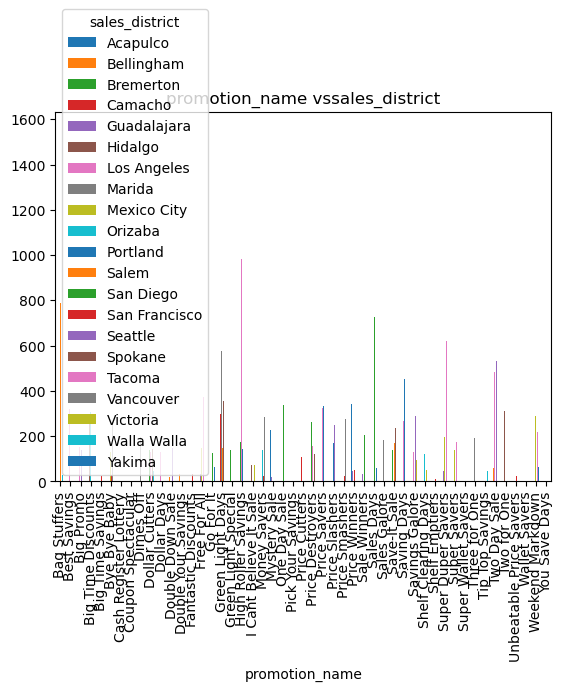

<Figure size 4000x4000 with 0 Axes>

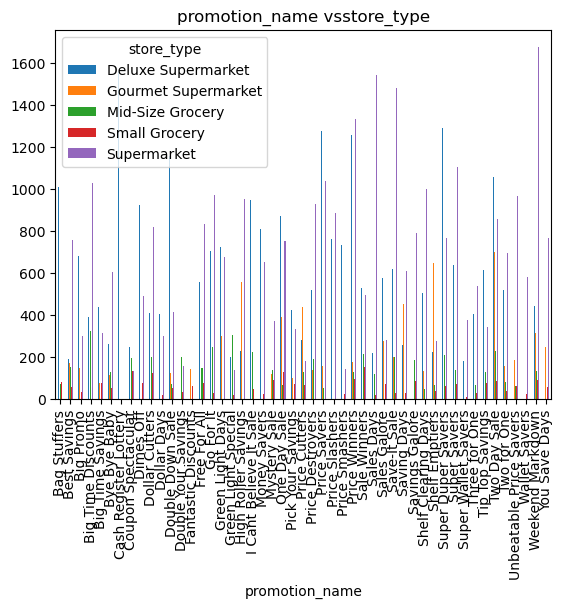

<Figure size 4000x4000 with 0 Axes>

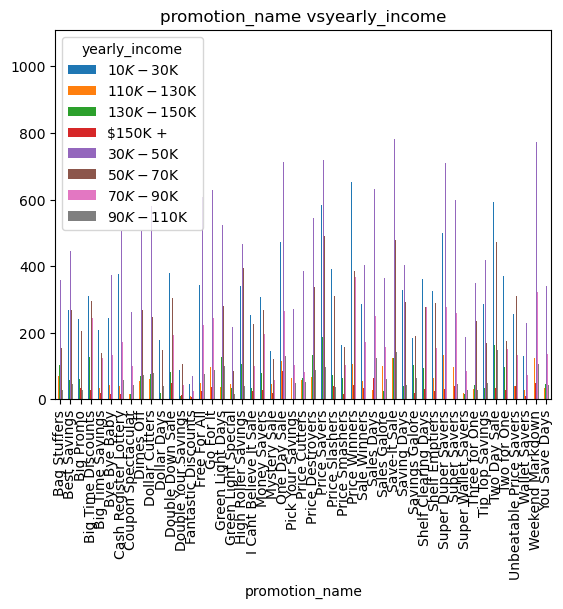

<Figure size 4000x4000 with 0 Axes>

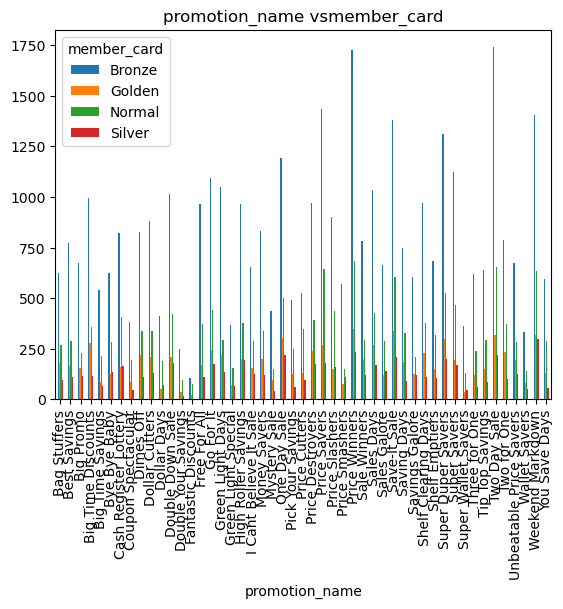

<Figure size 4000x4000 with 0 Axes>

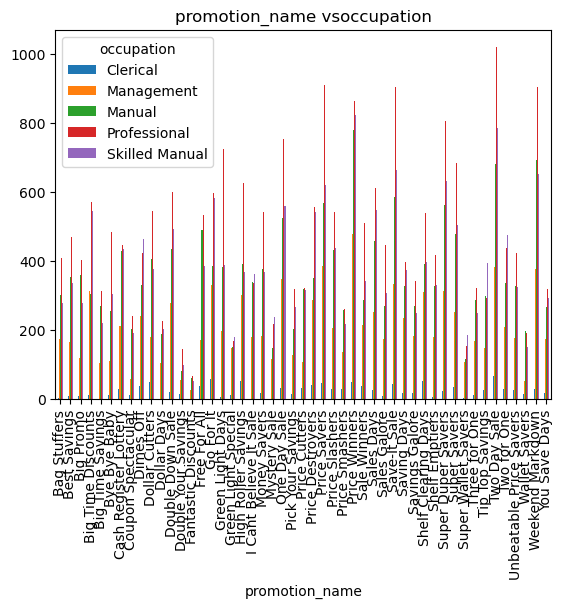

<Figure size 4000x4000 with 0 Axes>

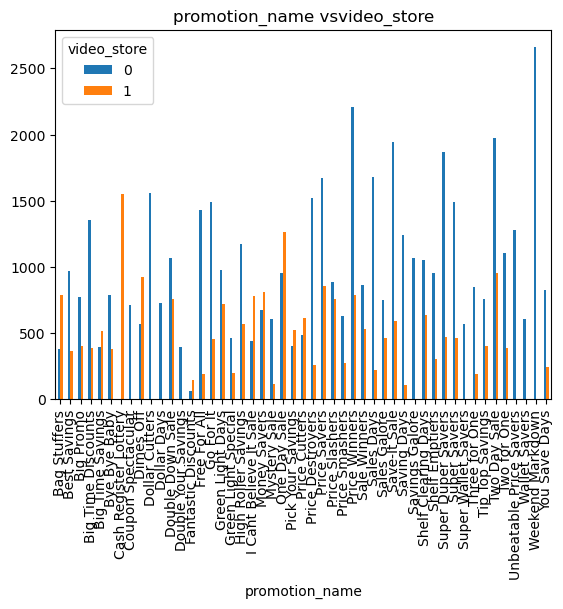

<Figure size 4000x4000 with 0 Axes>

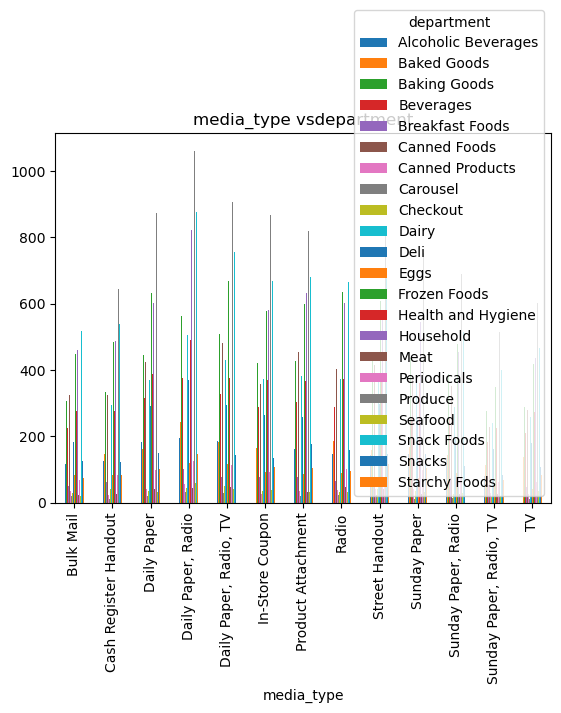

<Figure size 4000x4000 with 0 Axes>

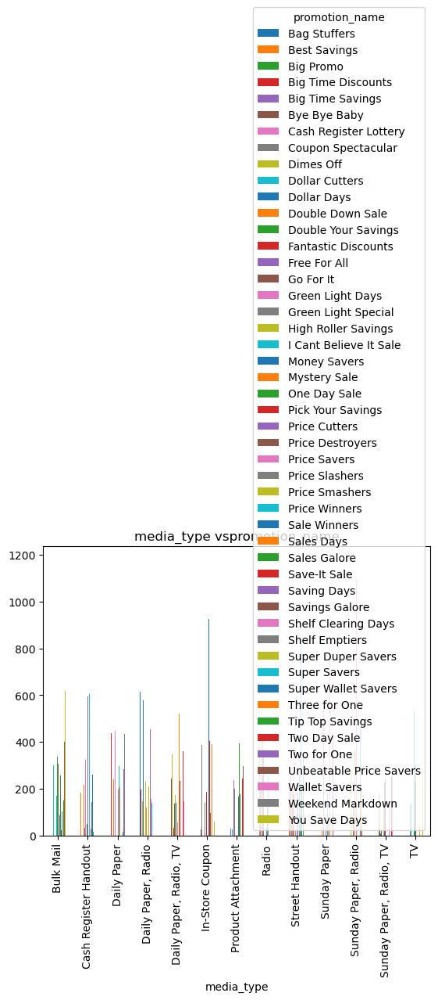

<Figure size 4000x4000 with 0 Axes>

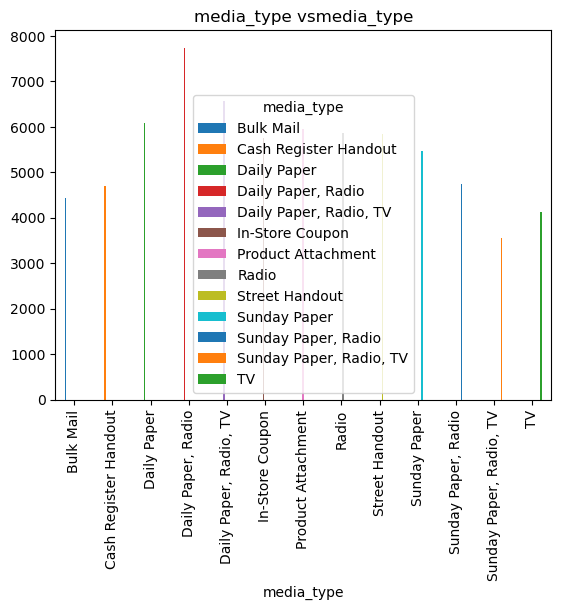

<Figure size 4000x4000 with 0 Axes>

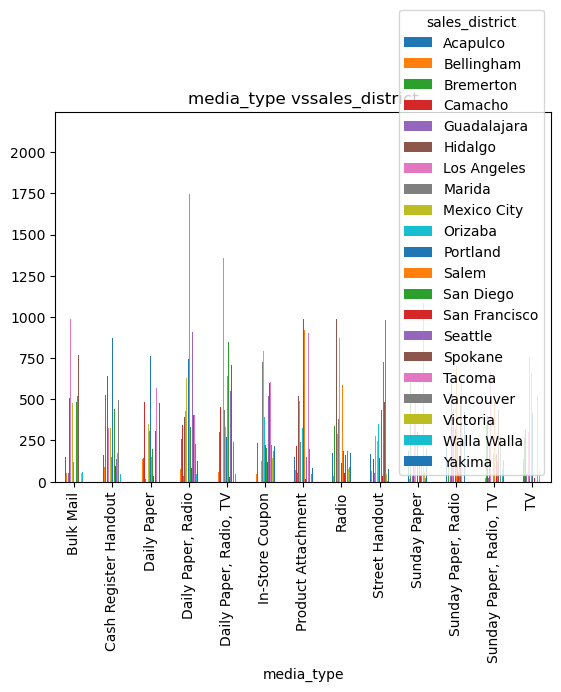

<Figure size 4000x4000 with 0 Axes>

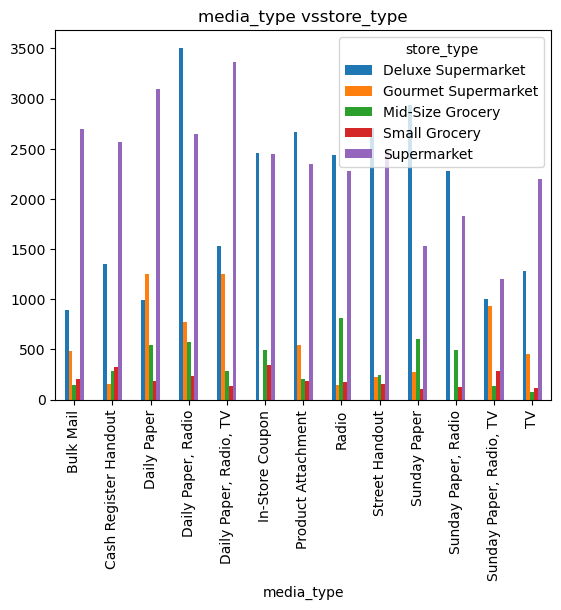

<Figure size 4000x4000 with 0 Axes>

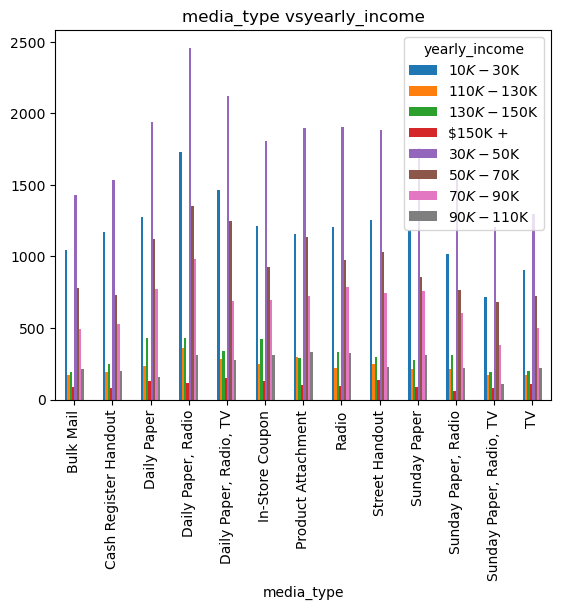

<Figure size 4000x4000 with 0 Axes>

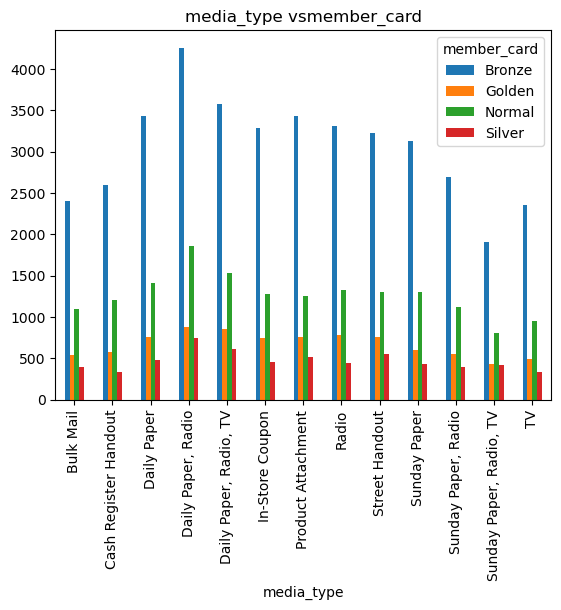

<Figure size 4000x4000 with 0 Axes>

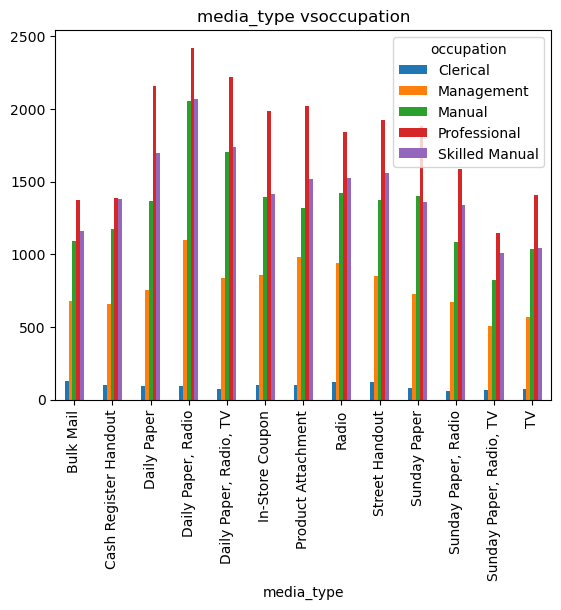

<Figure size 4000x4000 with 0 Axes>

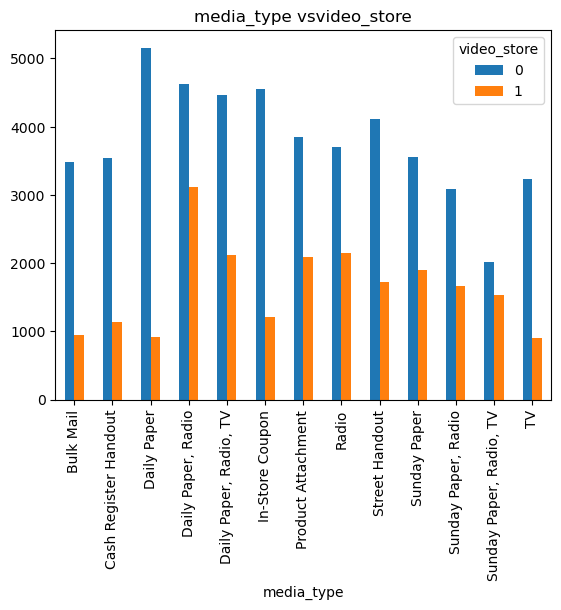

<Figure size 4000x4000 with 0 Axes>

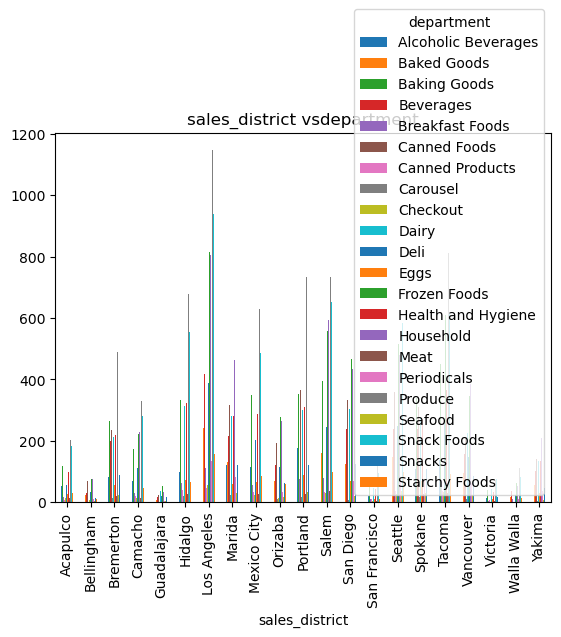

<Figure size 4000x4000 with 0 Axes>

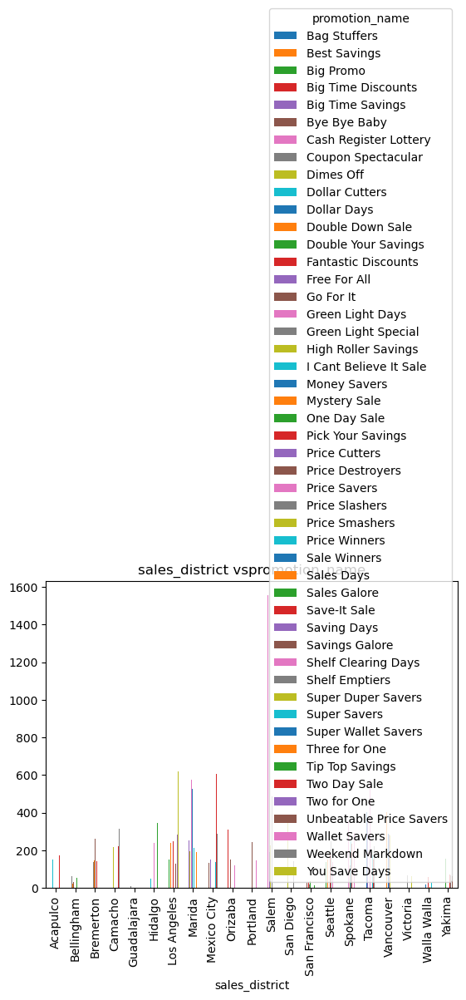

<Figure size 4000x4000 with 0 Axes>

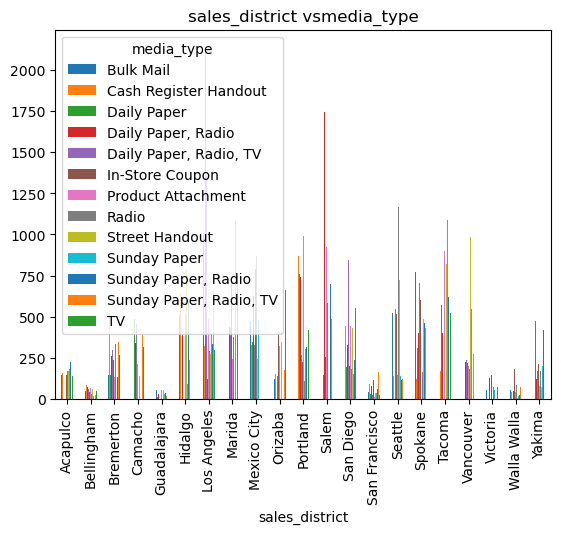

<Figure size 4000x4000 with 0 Axes>

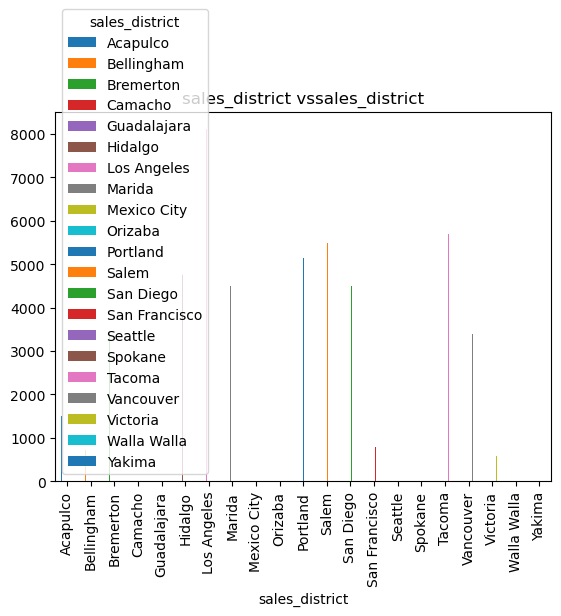

<Figure size 4000x4000 with 0 Axes>

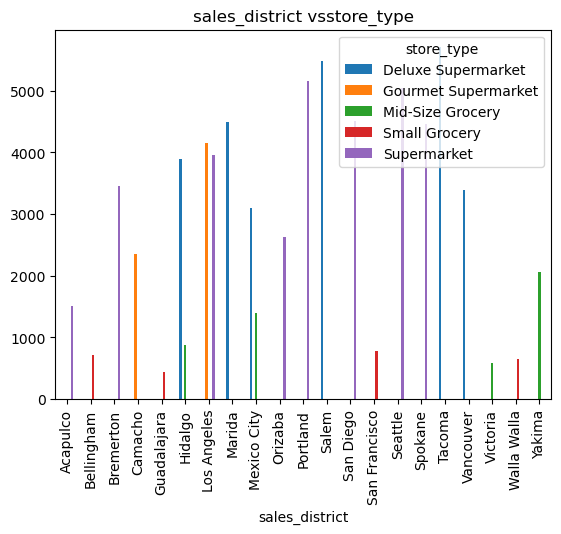

<Figure size 4000x4000 with 0 Axes>

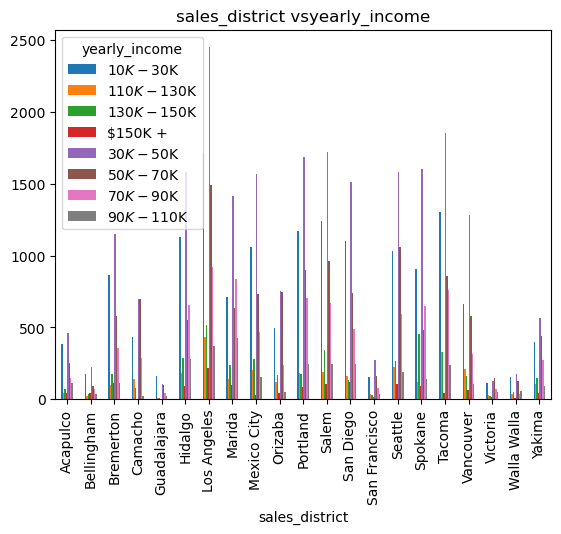

<Figure size 4000x4000 with 0 Axes>

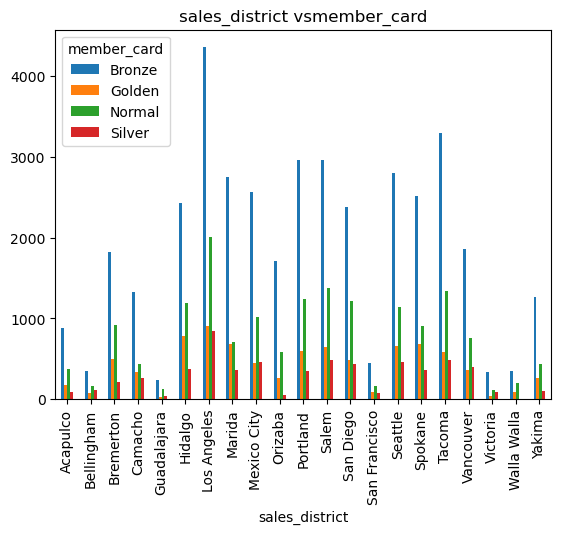

<Figure size 4000x4000 with 0 Axes>

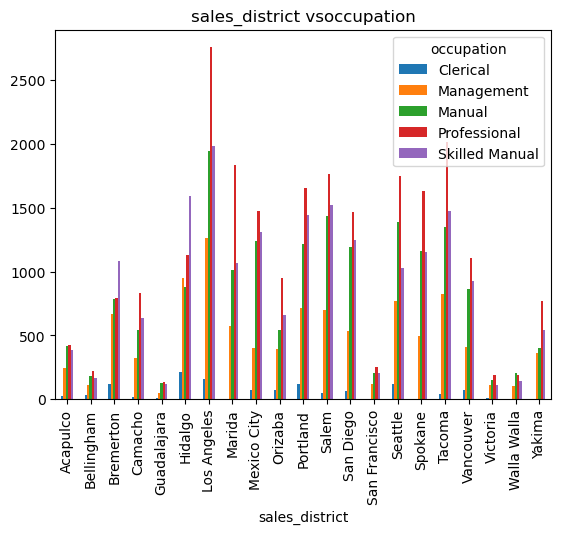

<Figure size 4000x4000 with 0 Axes>

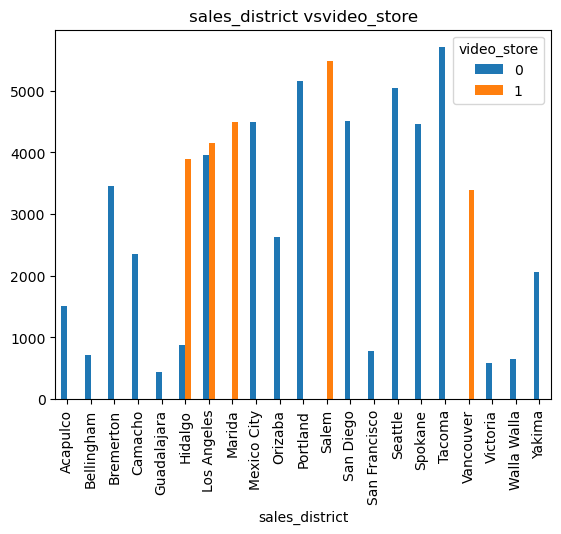

<Figure size 4000x4000 with 0 Axes>

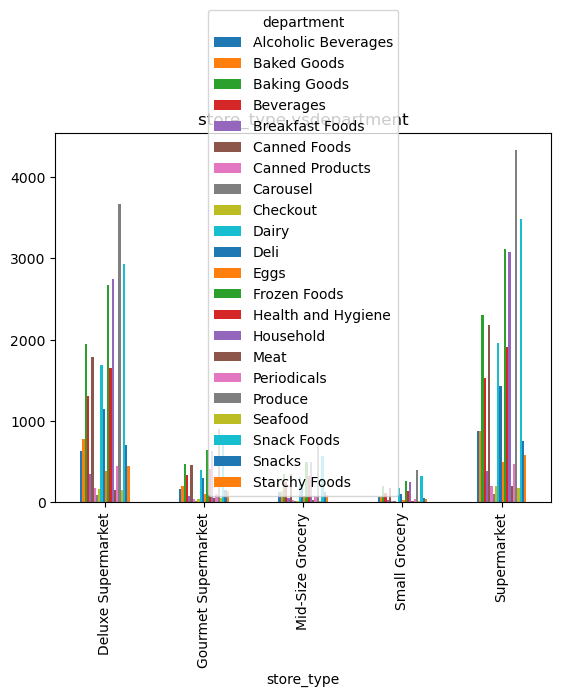

<Figure size 4000x4000 with 0 Axes>

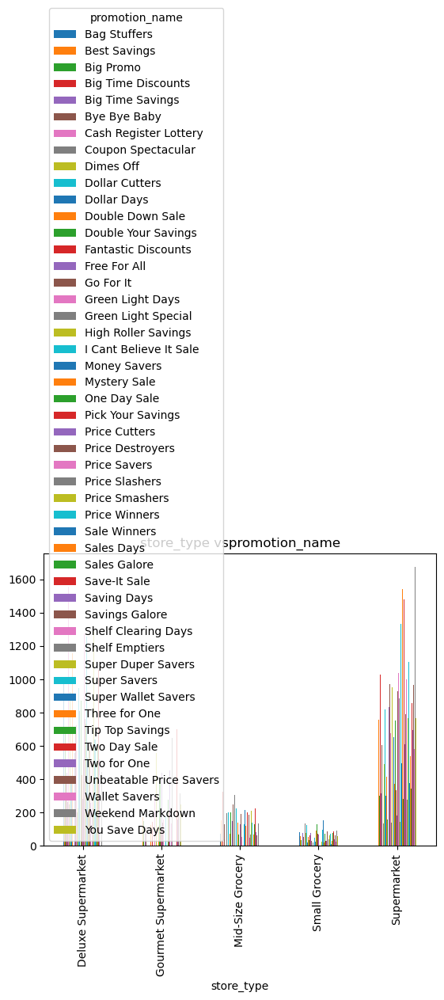

<Figure size 4000x4000 with 0 Axes>

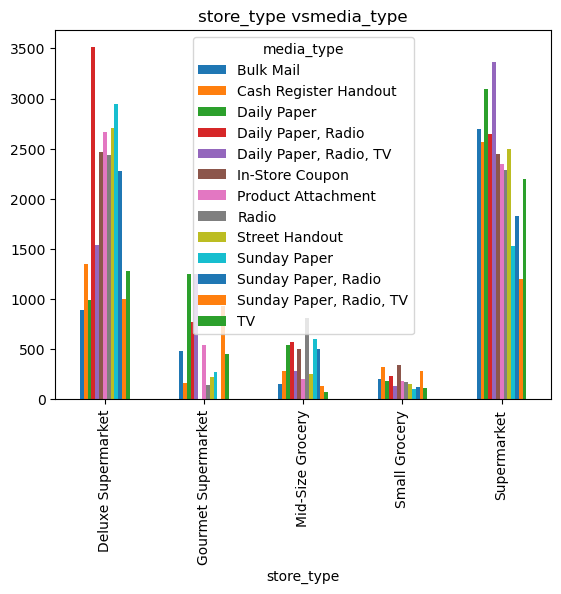

<Figure size 4000x4000 with 0 Axes>

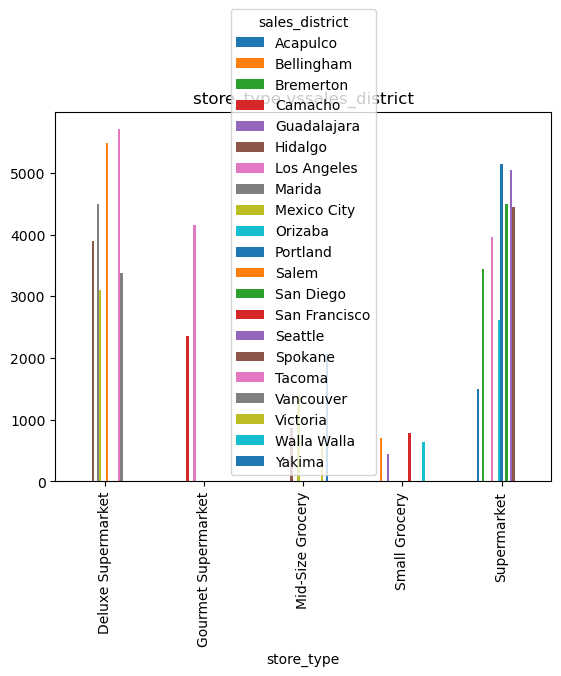

<Figure size 4000x4000 with 0 Axes>

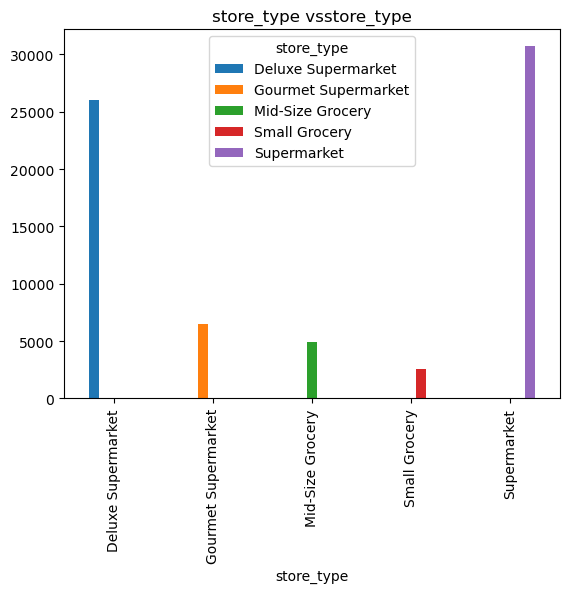

<Figure size 4000x4000 with 0 Axes>

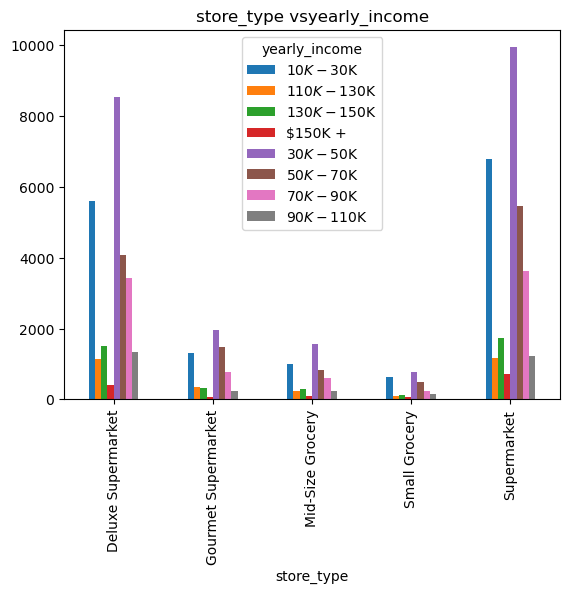

<Figure size 4000x4000 with 0 Axes>

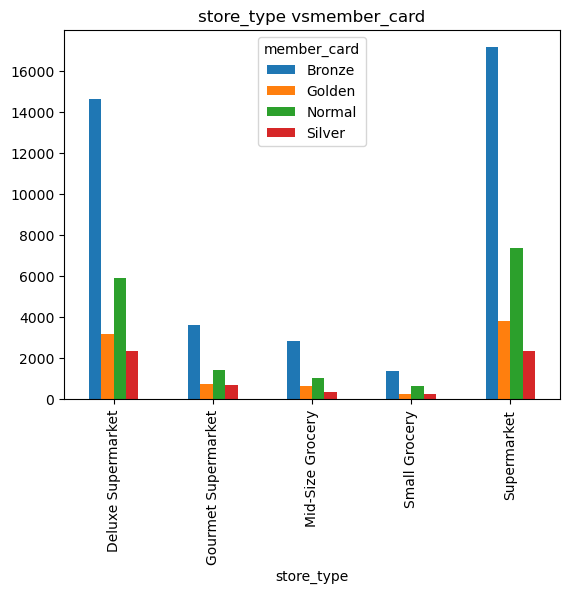

<Figure size 4000x4000 with 0 Axes>

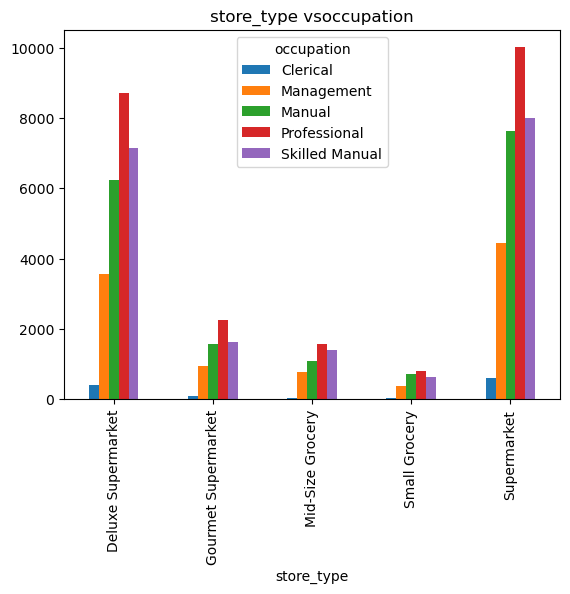

<Figure size 4000x4000 with 0 Axes>

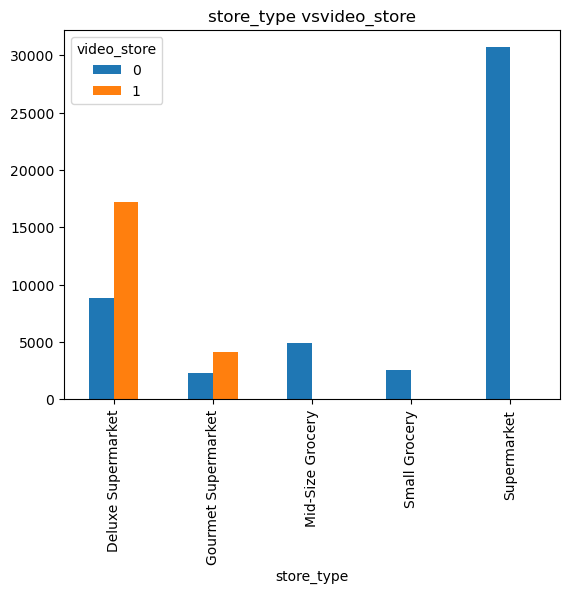

<Figure size 4000x4000 with 0 Axes>

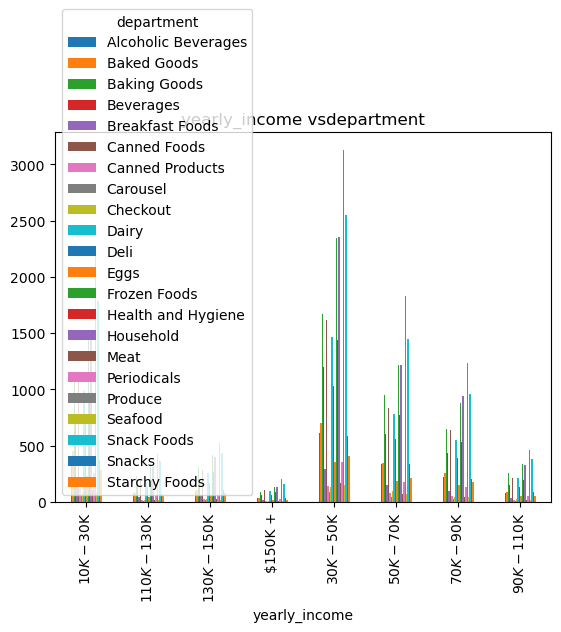

<Figure size 4000x4000 with 0 Axes>

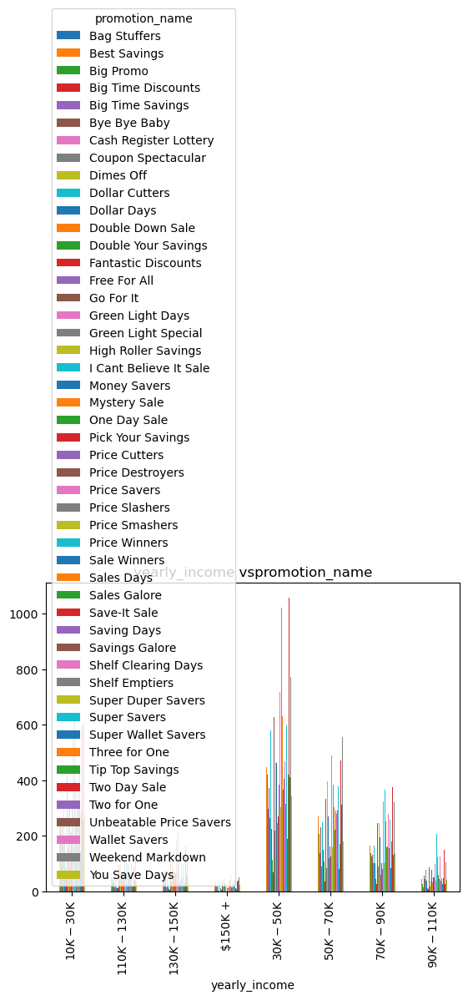

<Figure size 4000x4000 with 0 Axes>

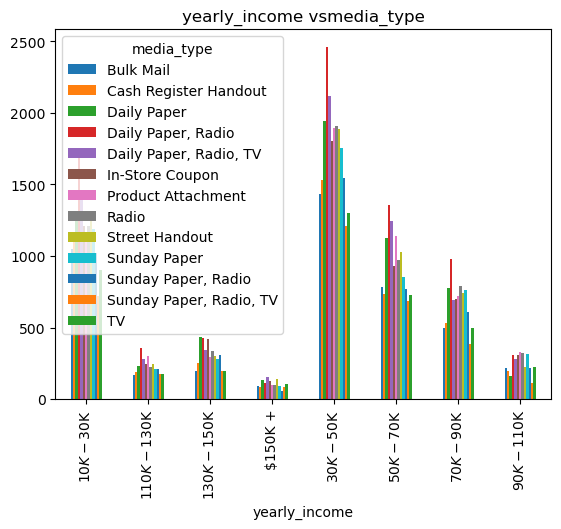

<Figure size 4000x4000 with 0 Axes>

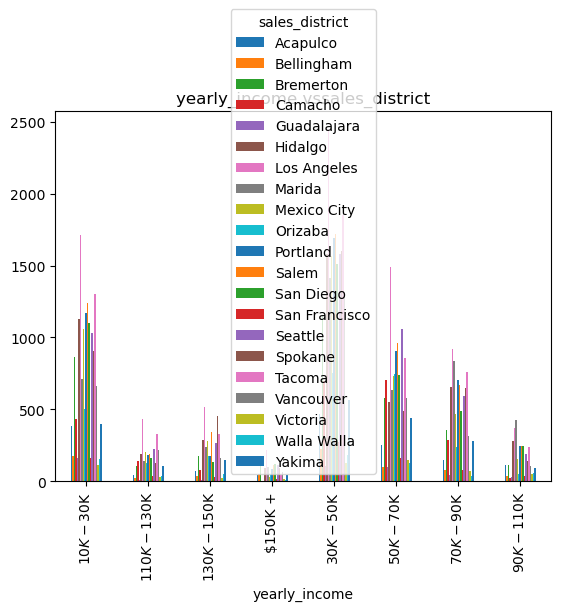

<Figure size 4000x4000 with 0 Axes>

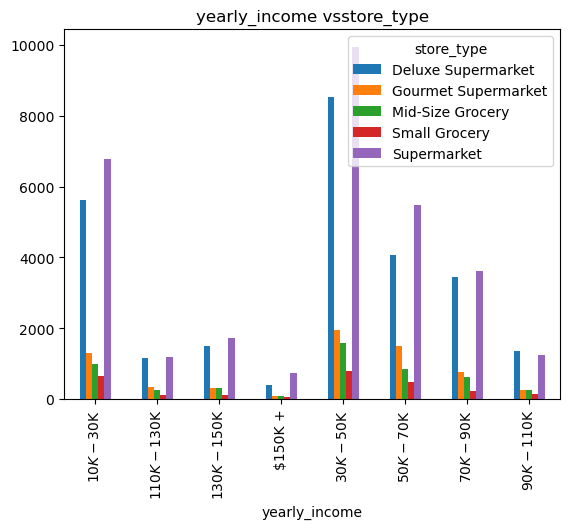

<Figure size 4000x4000 with 0 Axes>

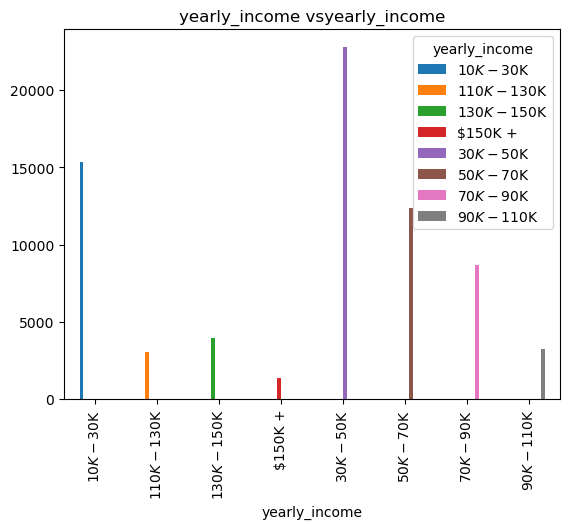

<Figure size 4000x4000 with 0 Axes>

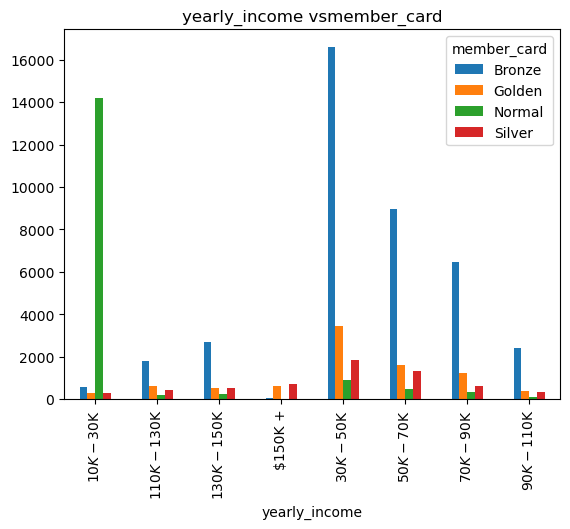

<Figure size 4000x4000 with 0 Axes>

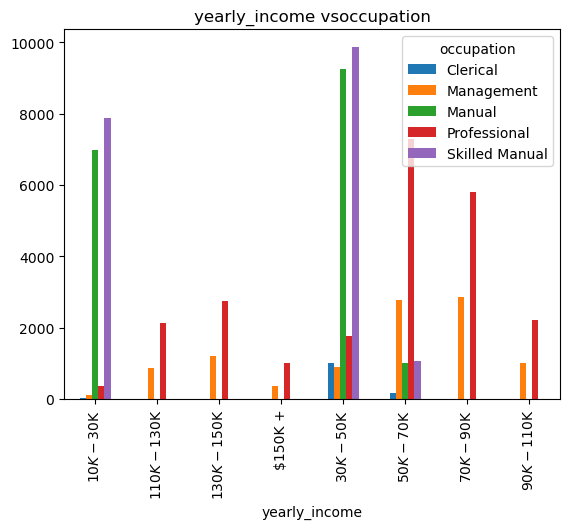

<Figure size 4000x4000 with 0 Axes>

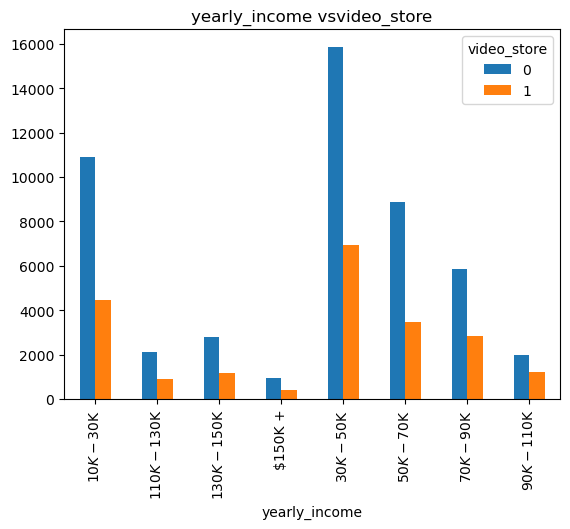

<Figure size 4000x4000 with 0 Axes>

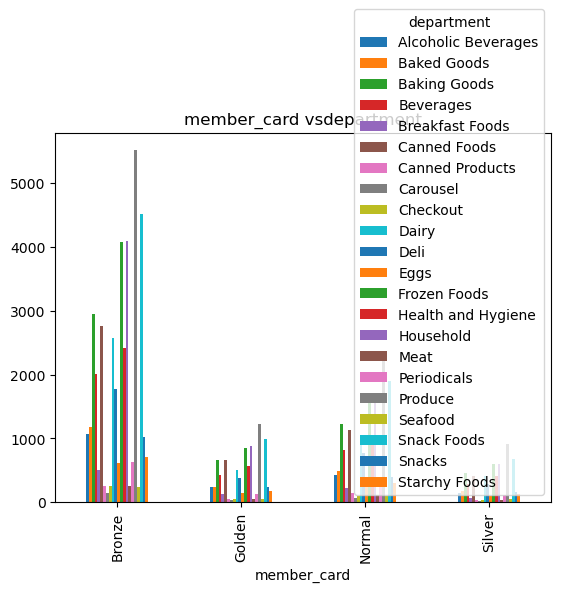

<Figure size 4000x4000 with 0 Axes>

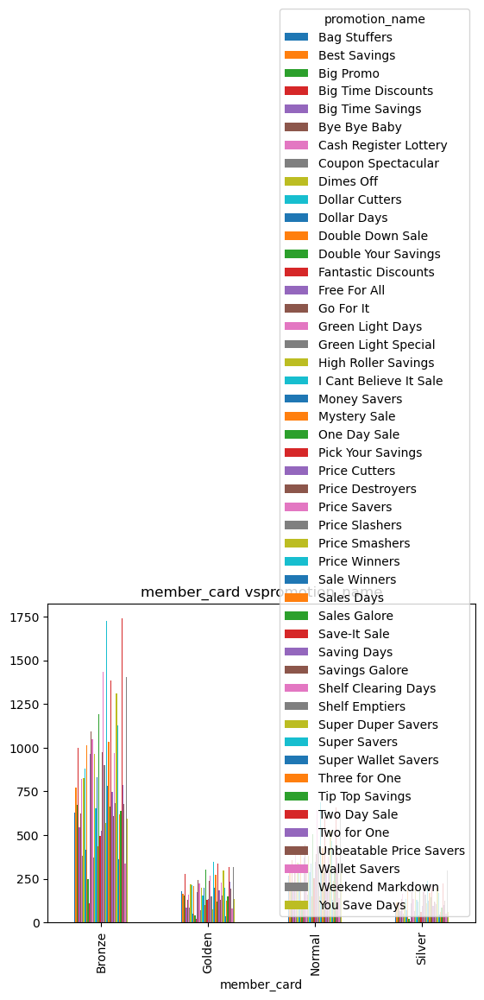

<Figure size 4000x4000 with 0 Axes>

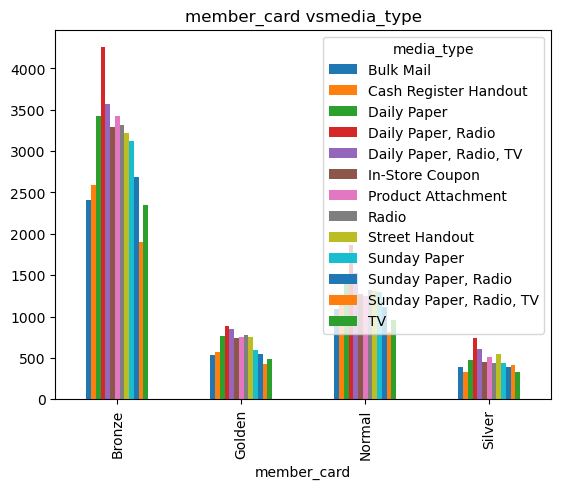

<Figure size 4000x4000 with 0 Axes>

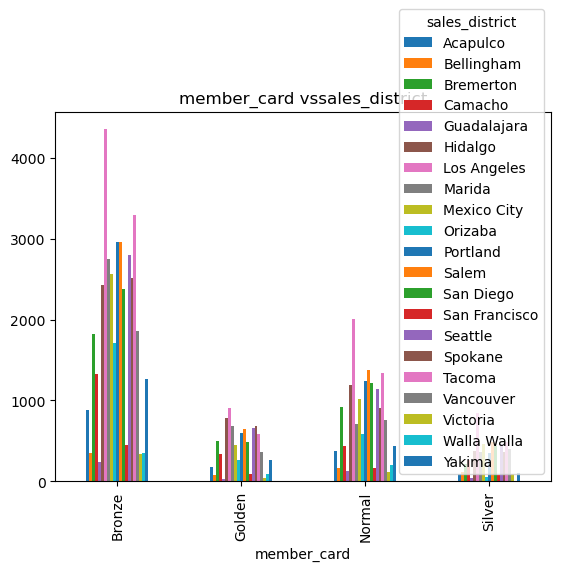

<Figure size 4000x4000 with 0 Axes>

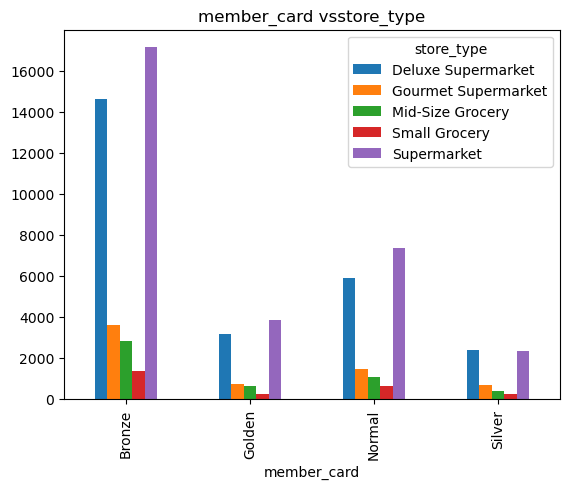

<Figure size 4000x4000 with 0 Axes>

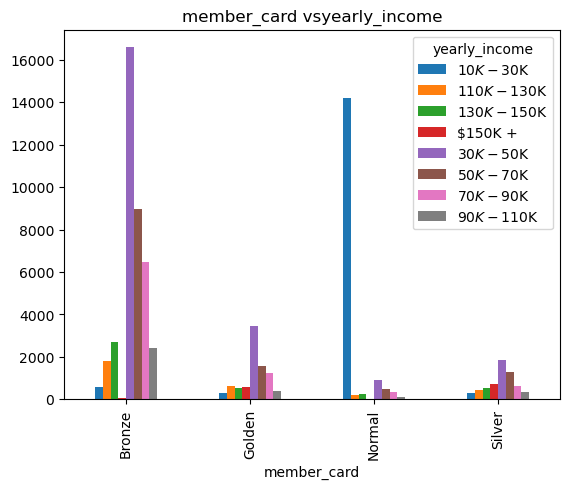

<Figure size 4000x4000 with 0 Axes>

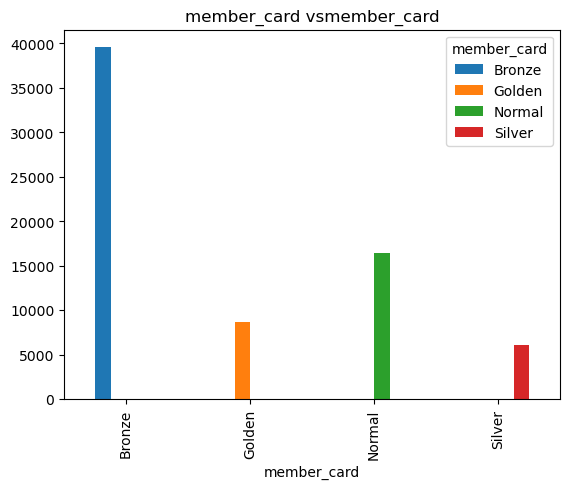

<Figure size 4000x4000 with 0 Axes>

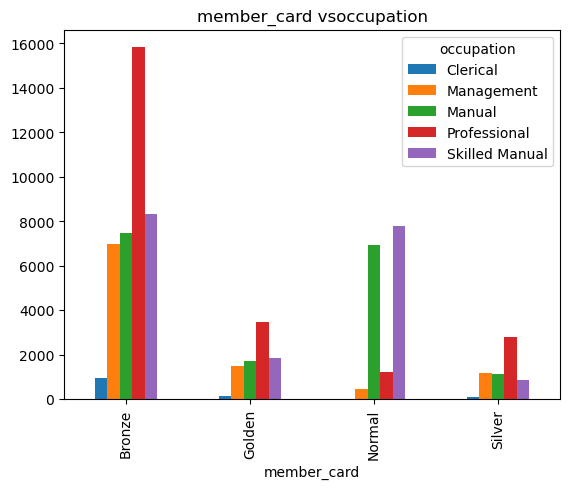

<Figure size 4000x4000 with 0 Axes>

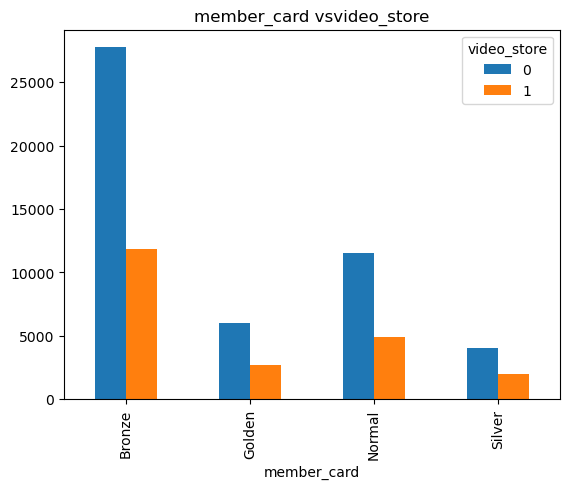

<Figure size 4000x4000 with 0 Axes>

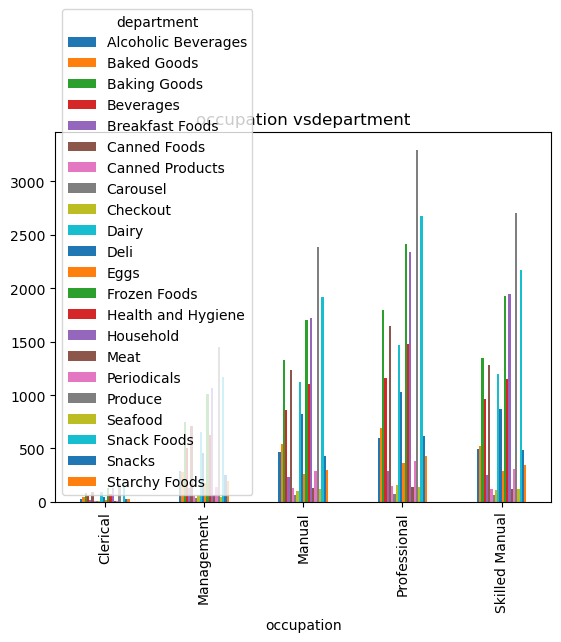

<Figure size 4000x4000 with 0 Axes>

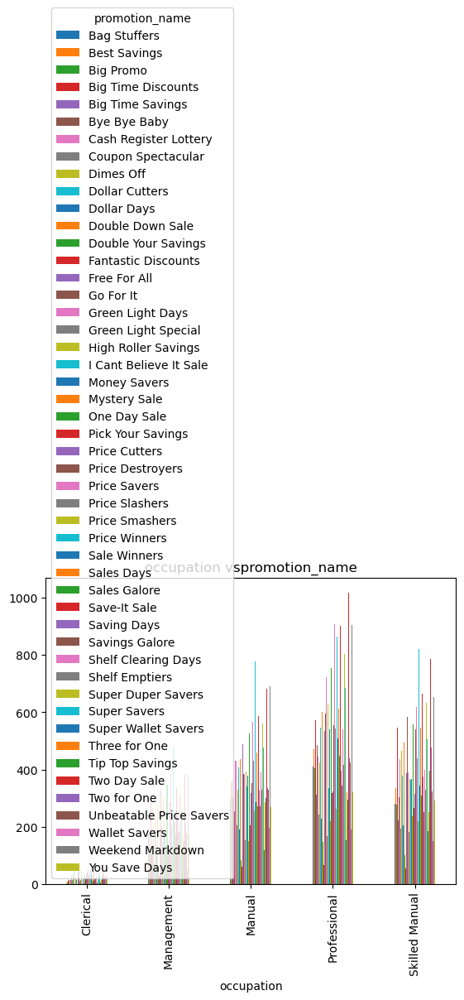

<Figure size 4000x4000 with 0 Axes>

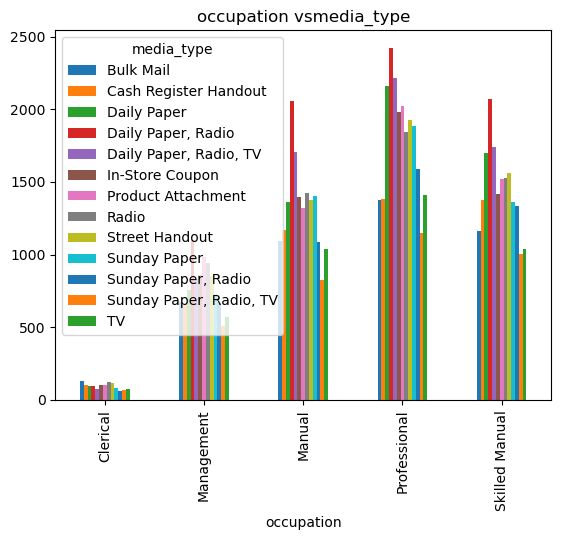

<Figure size 4000x4000 with 0 Axes>

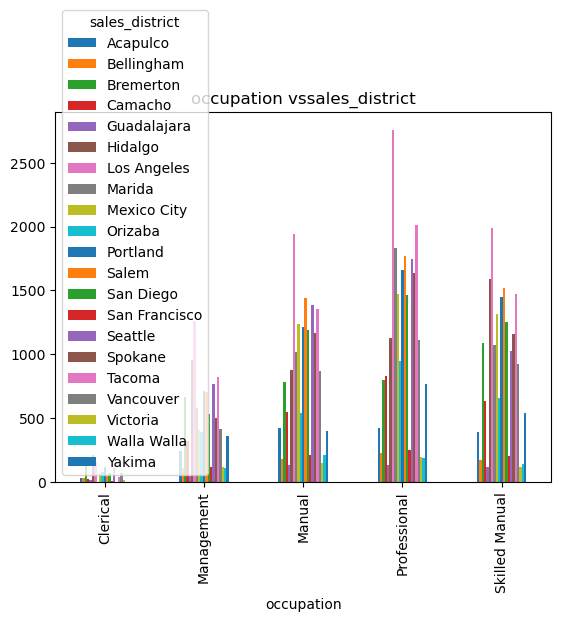

<Figure size 4000x4000 with 0 Axes>

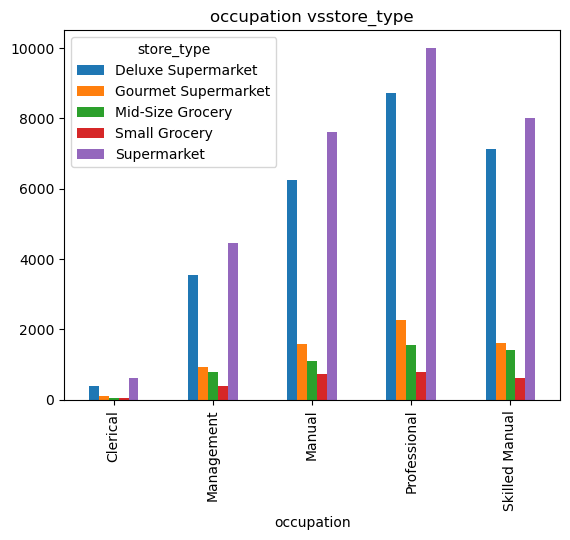

<Figure size 4000x4000 with 0 Axes>

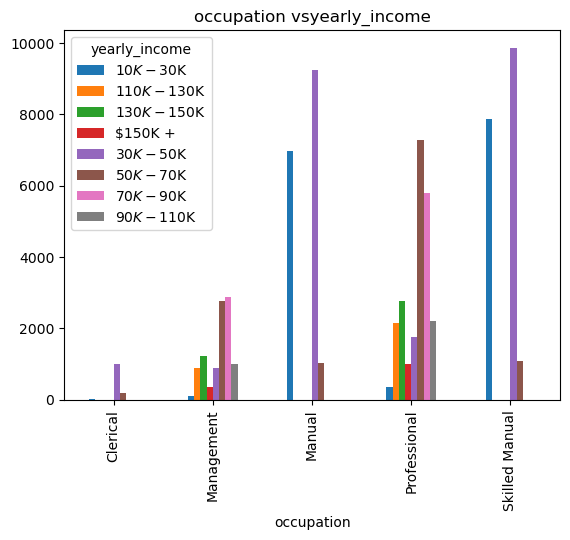

<Figure size 4000x4000 with 0 Axes>

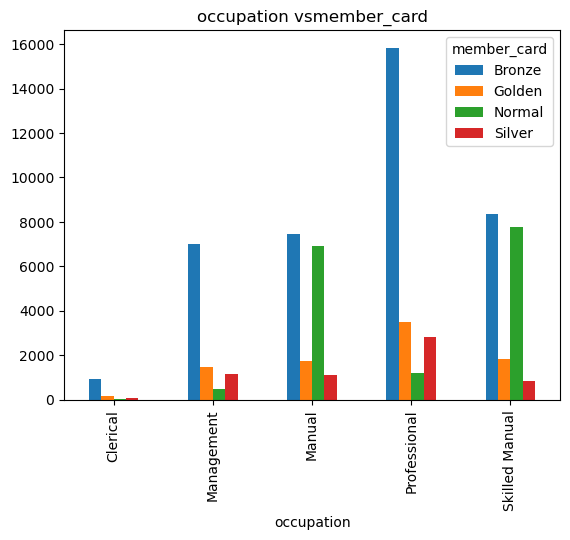

<Figure size 4000x4000 with 0 Axes>

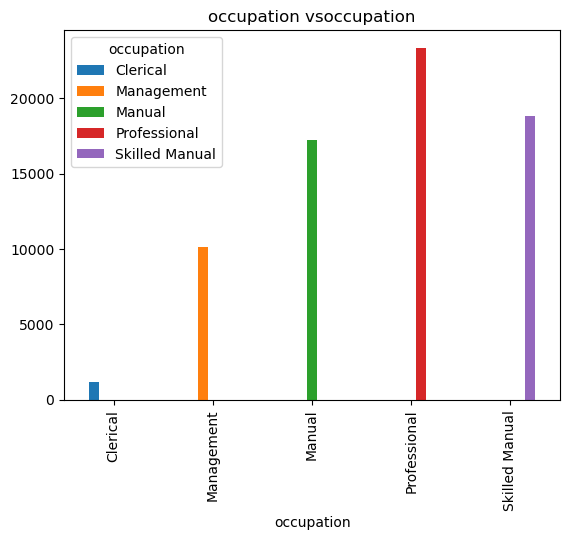

<Figure size 4000x4000 with 0 Axes>

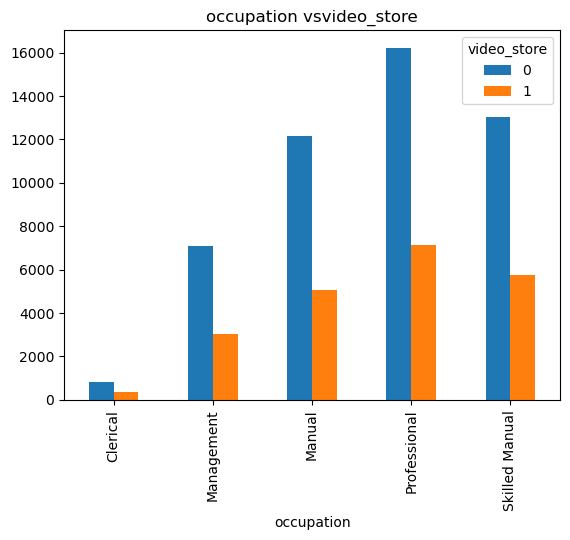

<Figure size 4000x4000 with 0 Axes>

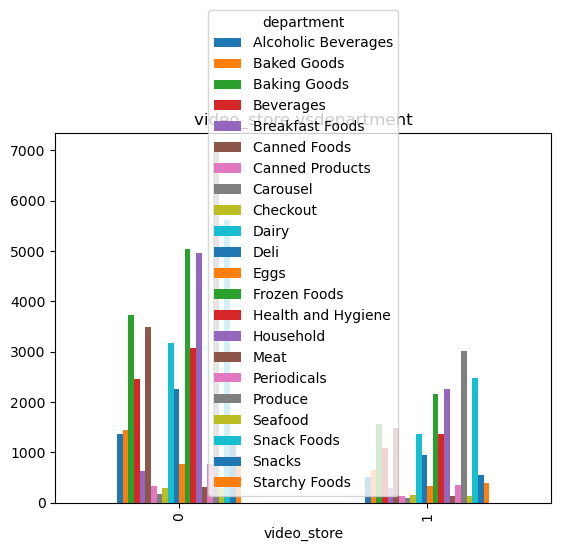

<Figure size 4000x4000 with 0 Axes>

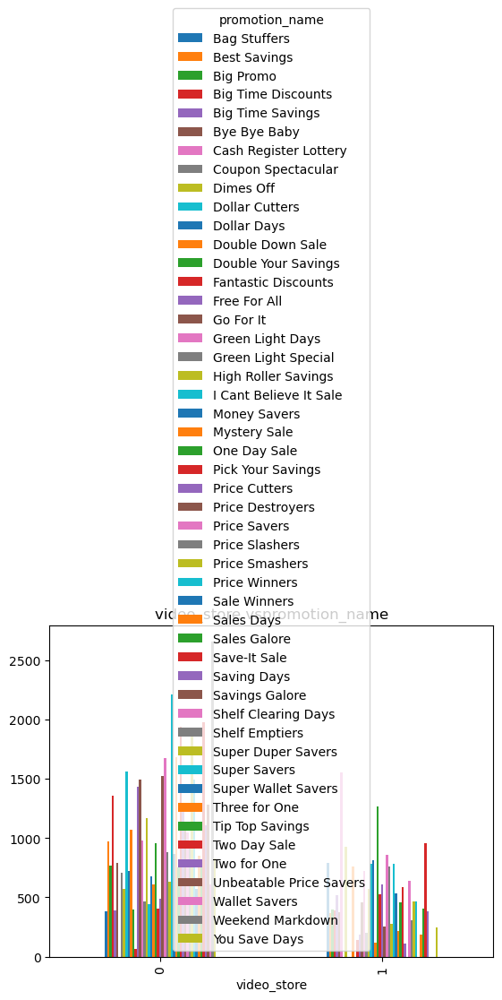

<Figure size 4000x4000 with 0 Axes>

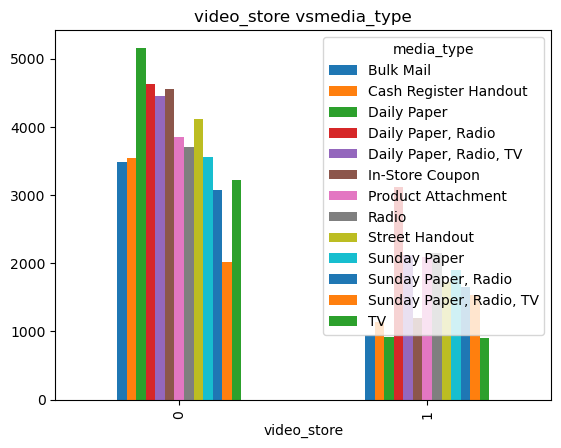

<Figure size 4000x4000 with 0 Axes>

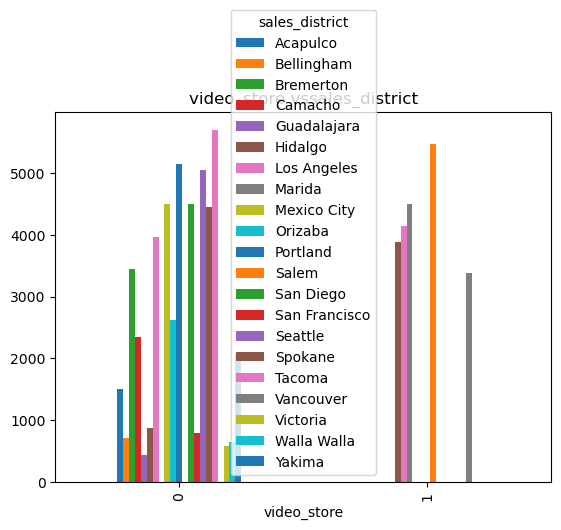

<Figure size 4000x4000 with 0 Axes>

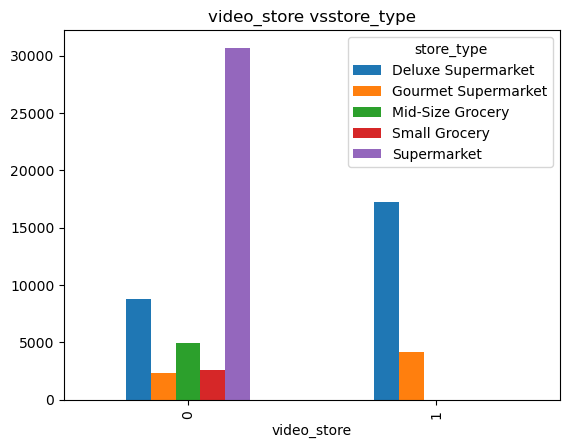

<Figure size 4000x4000 with 0 Axes>

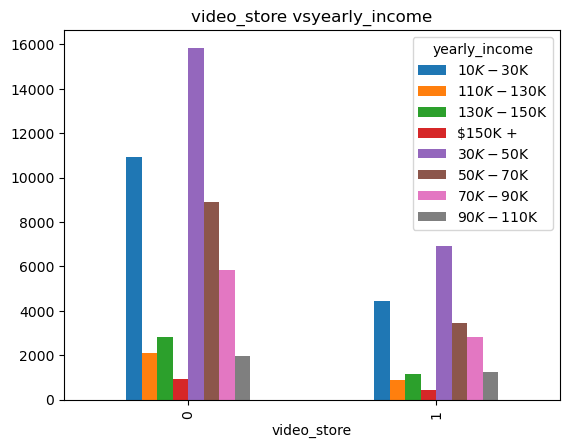

<Figure size 4000x4000 with 0 Axes>

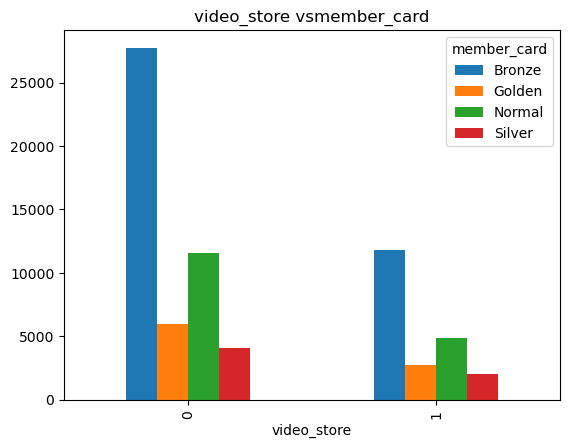

<Figure size 4000x4000 with 0 Axes>

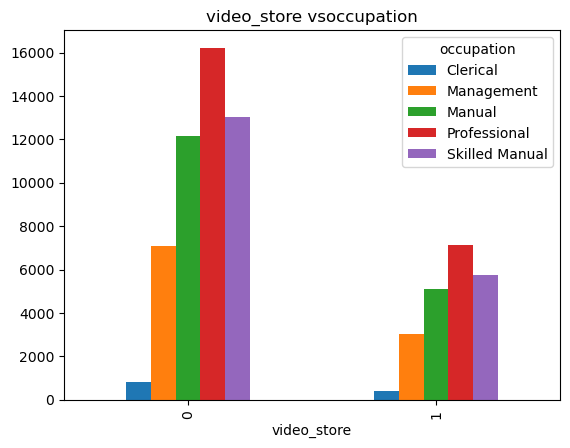

<Figure size 4000x4000 with 0 Axes>

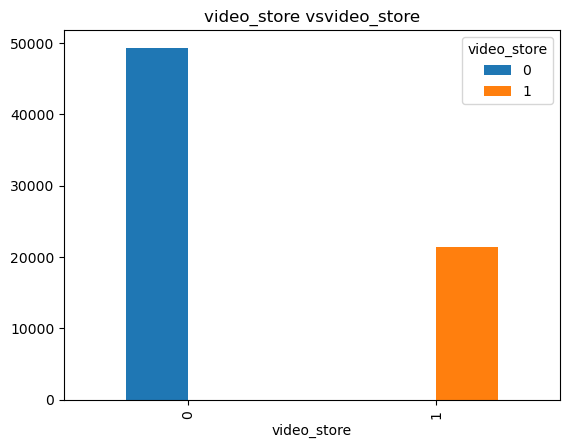

In [49]:
for i in df_cat.columns:
    for j in df_cat.columns:
        plt.figure(figsize=(40,40))
        pd.crosstab(df_cat[i],df_cat[j]).plot(kind="bar")
        plt.title(f"{i} vs{j}")
        plt.show()

# numerical vs categorical

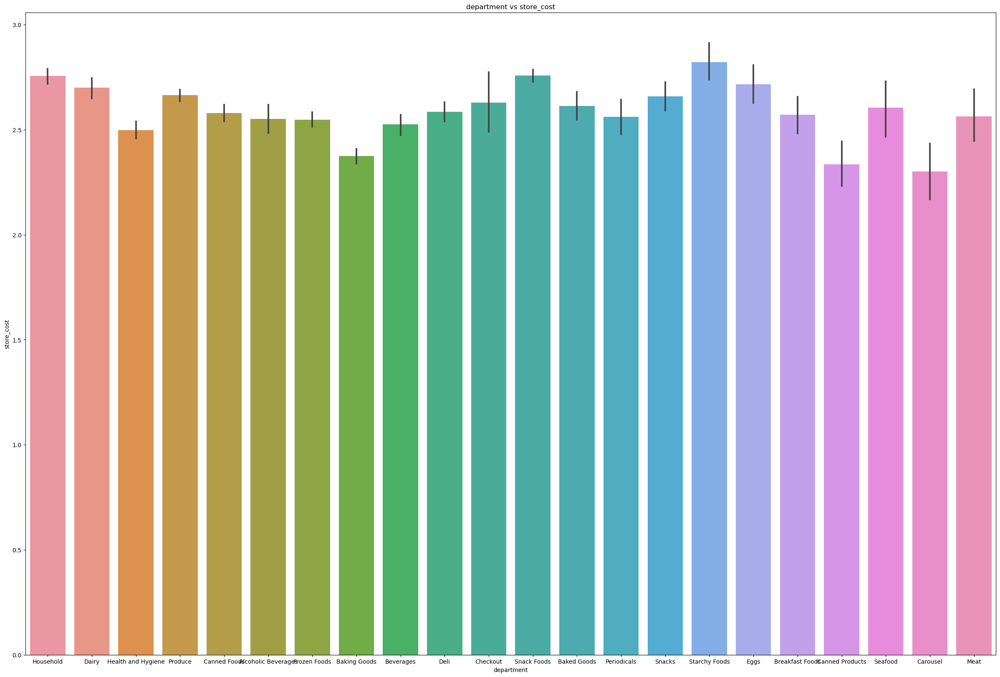

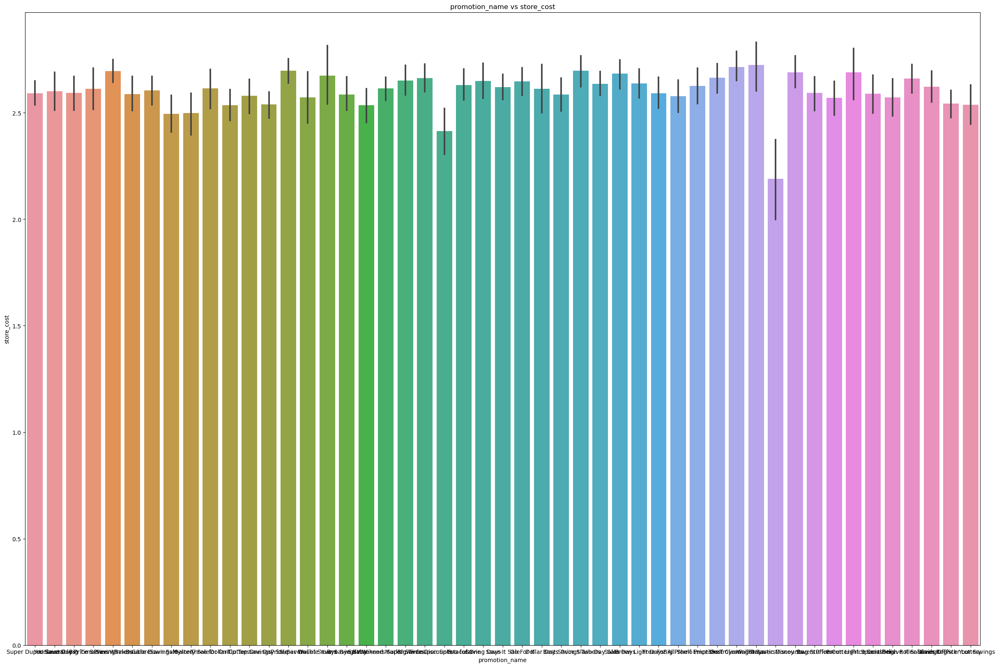

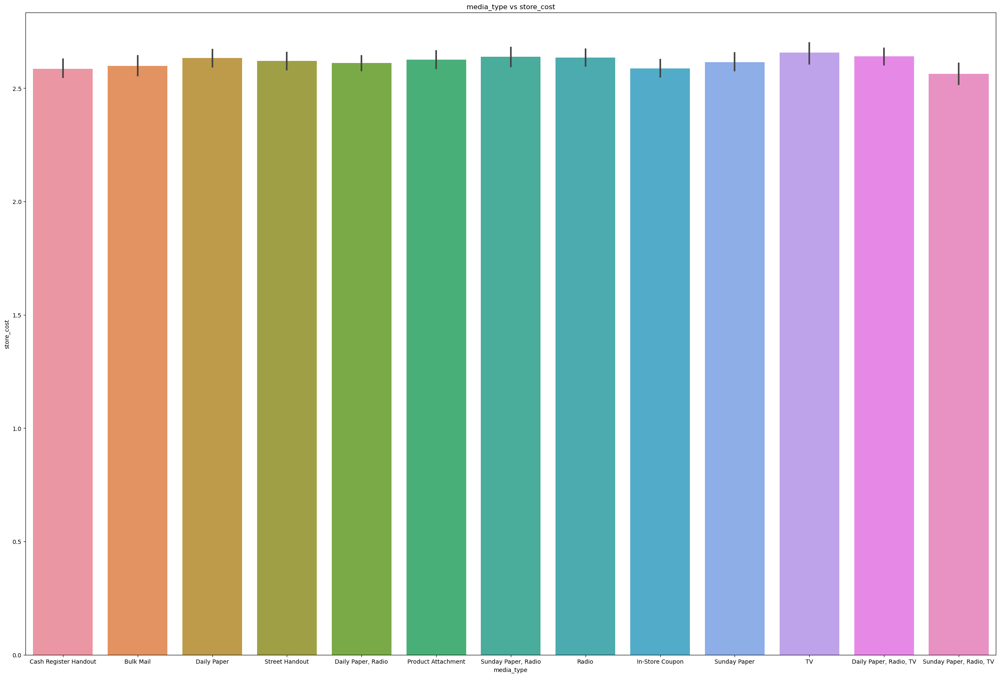

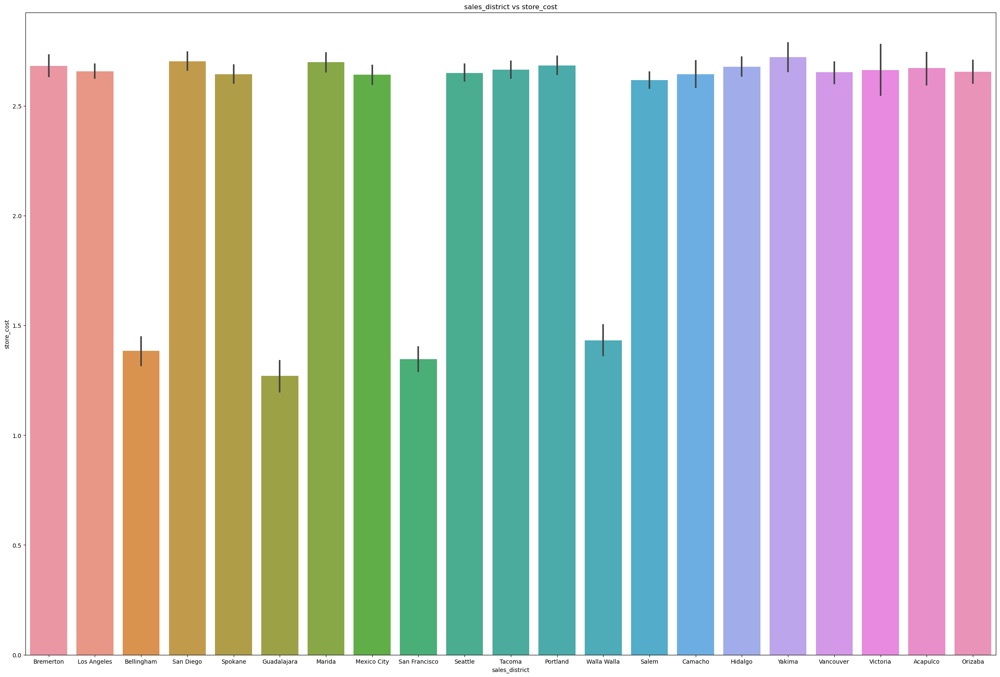

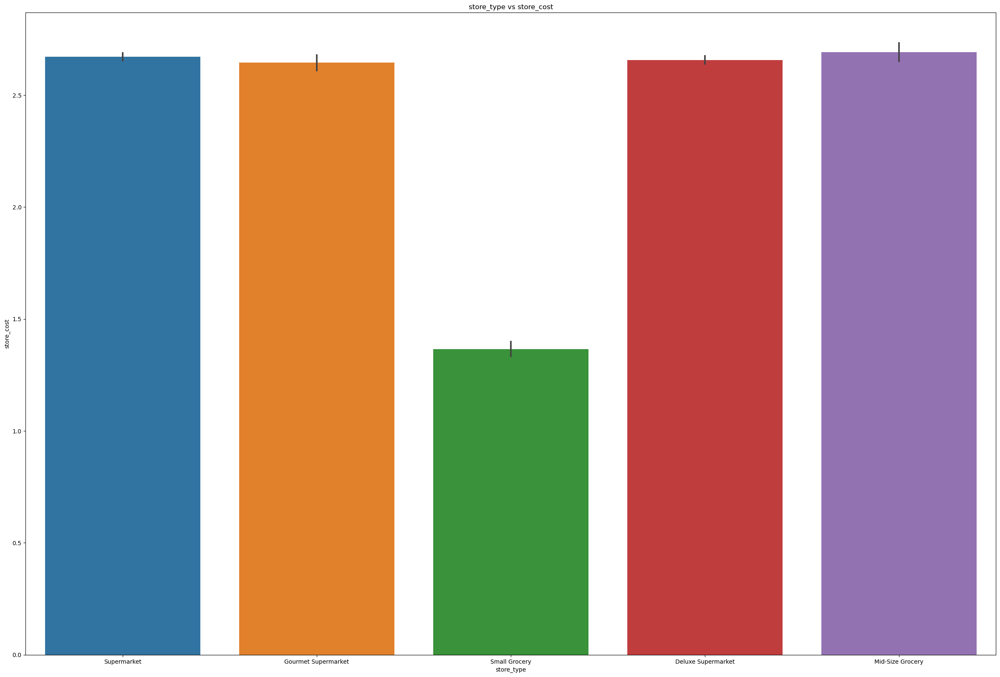

...

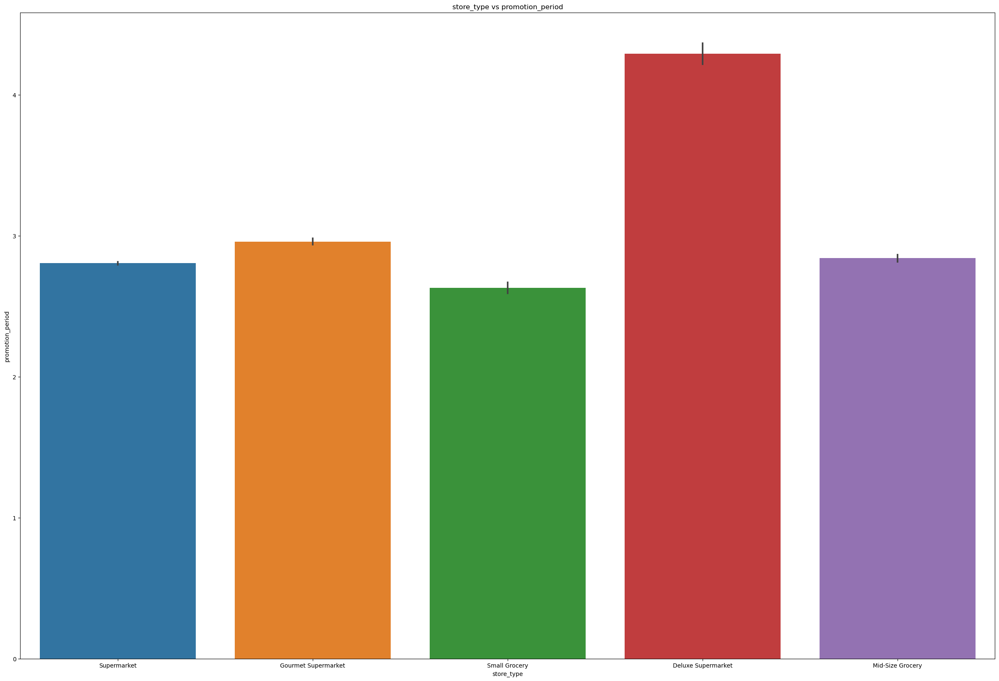

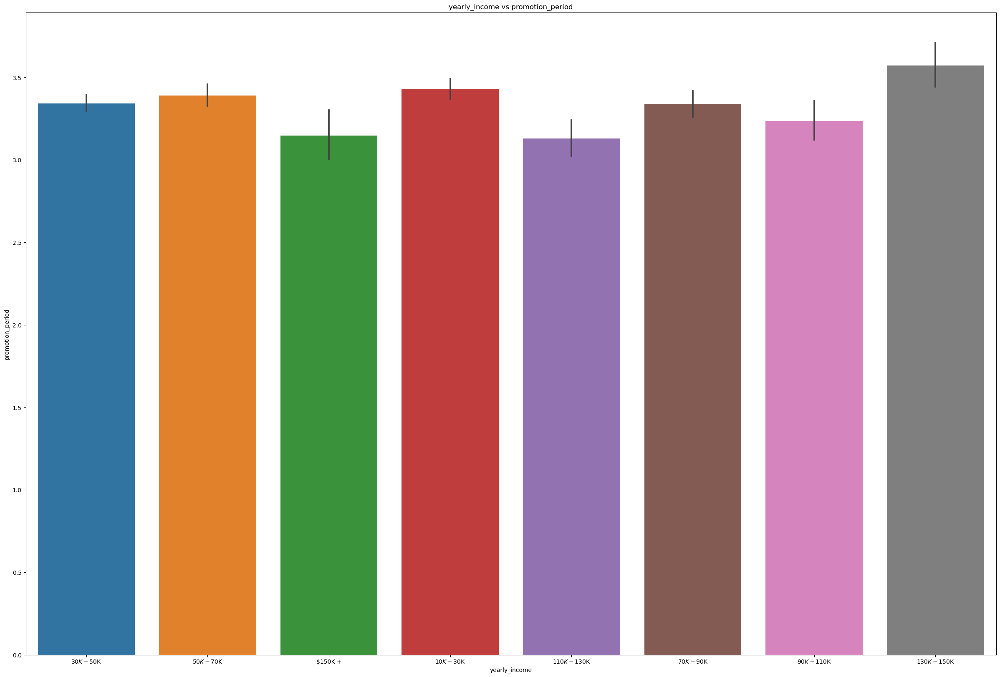

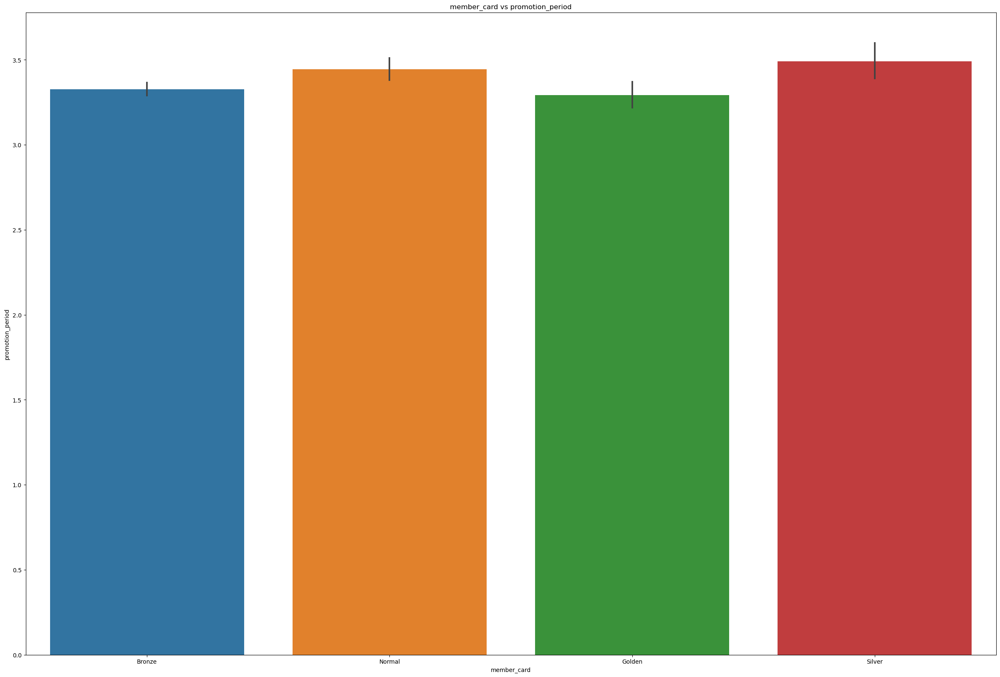

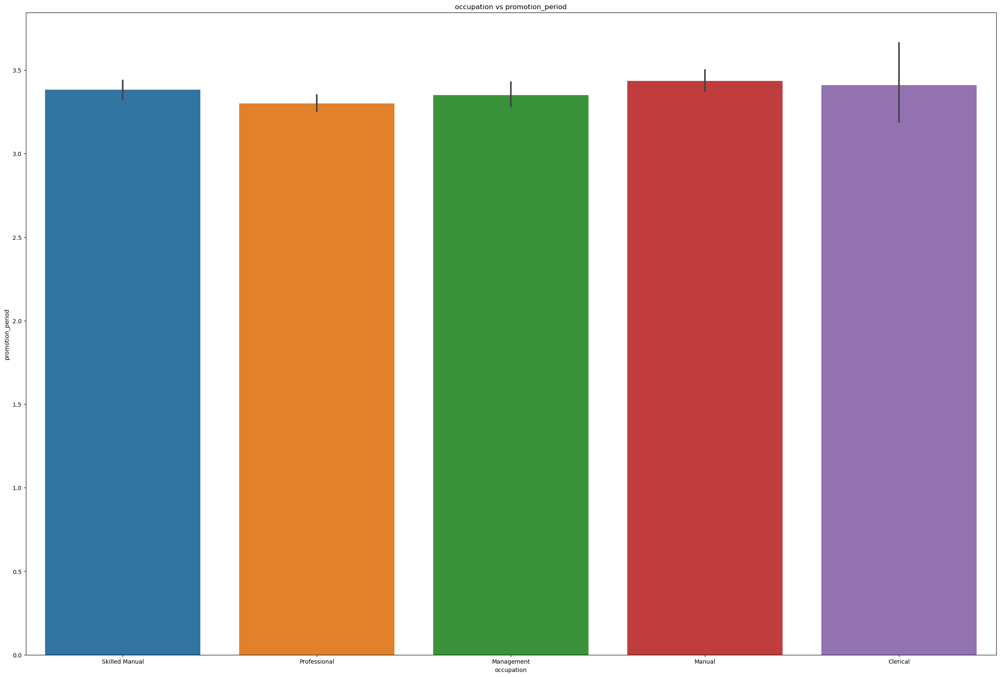

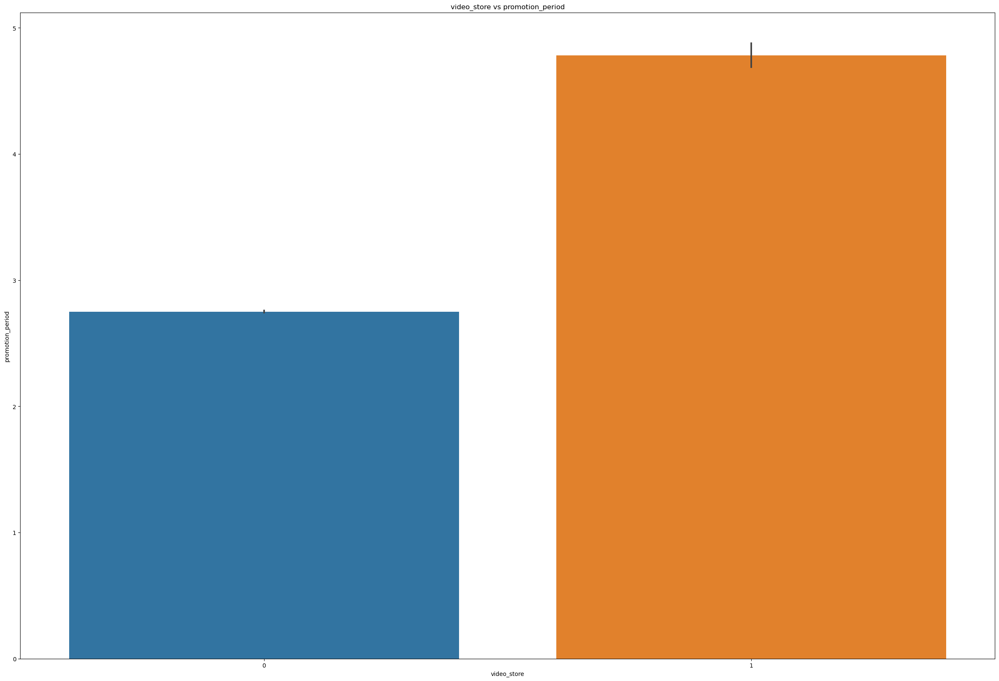

In [51]:
for i in df_num.columns:
    for j in df_cat.columns:
        plt.figure(figsize=(30,20))
        sns.barplot(x=df_cat[j],y=df_num[i])
        plt.title(f"{j} vs {i}")
        plt.show()

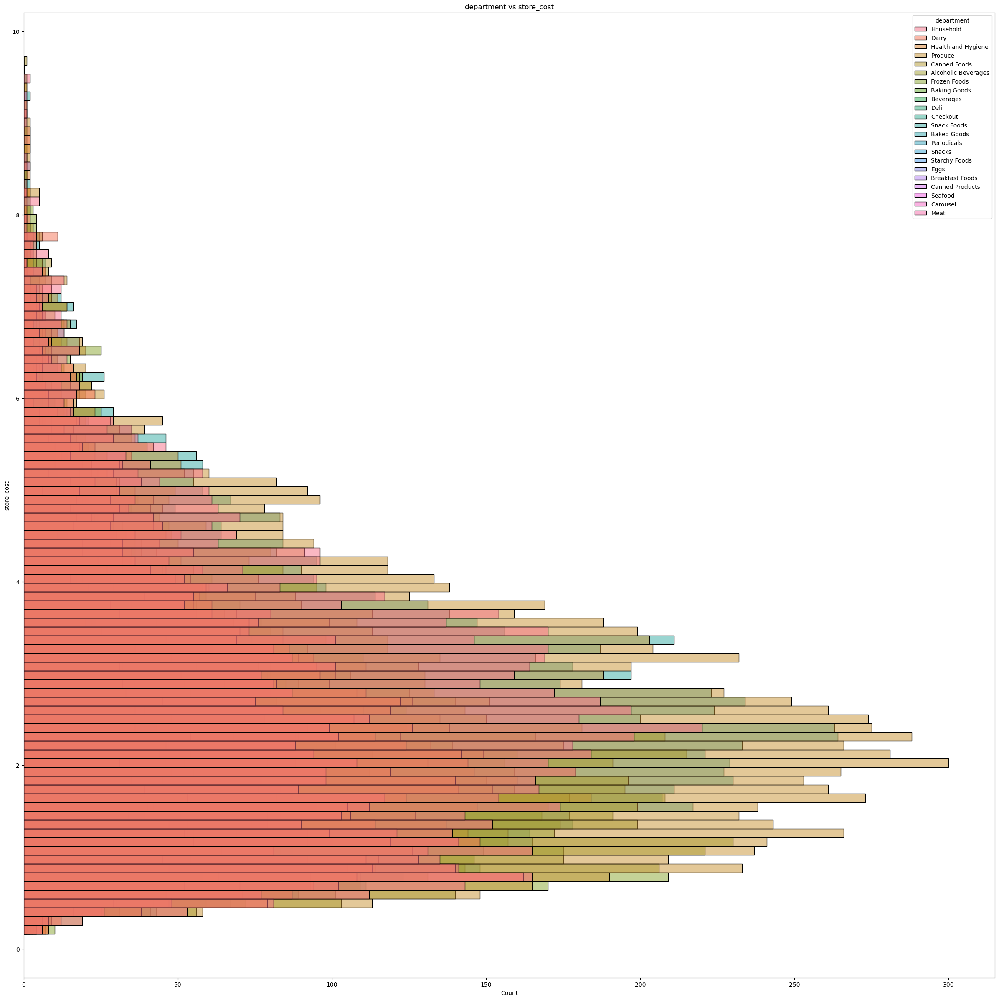

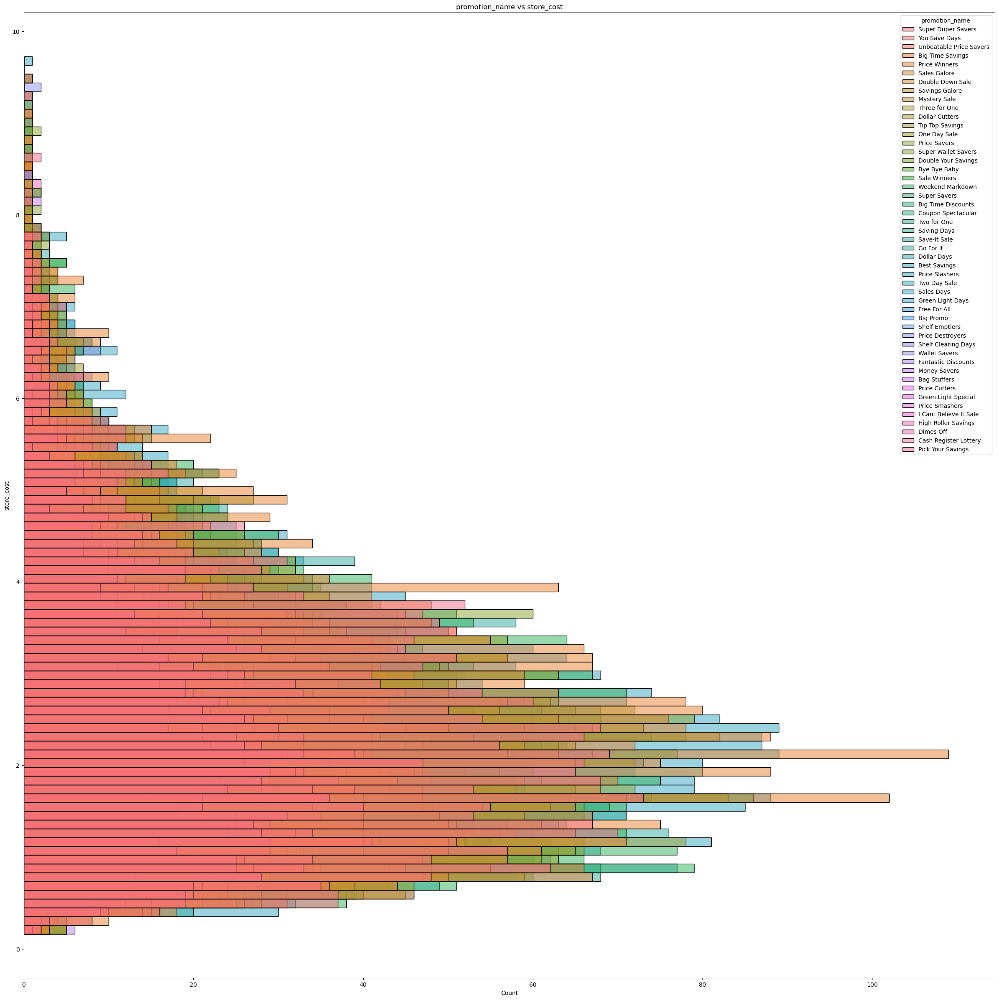

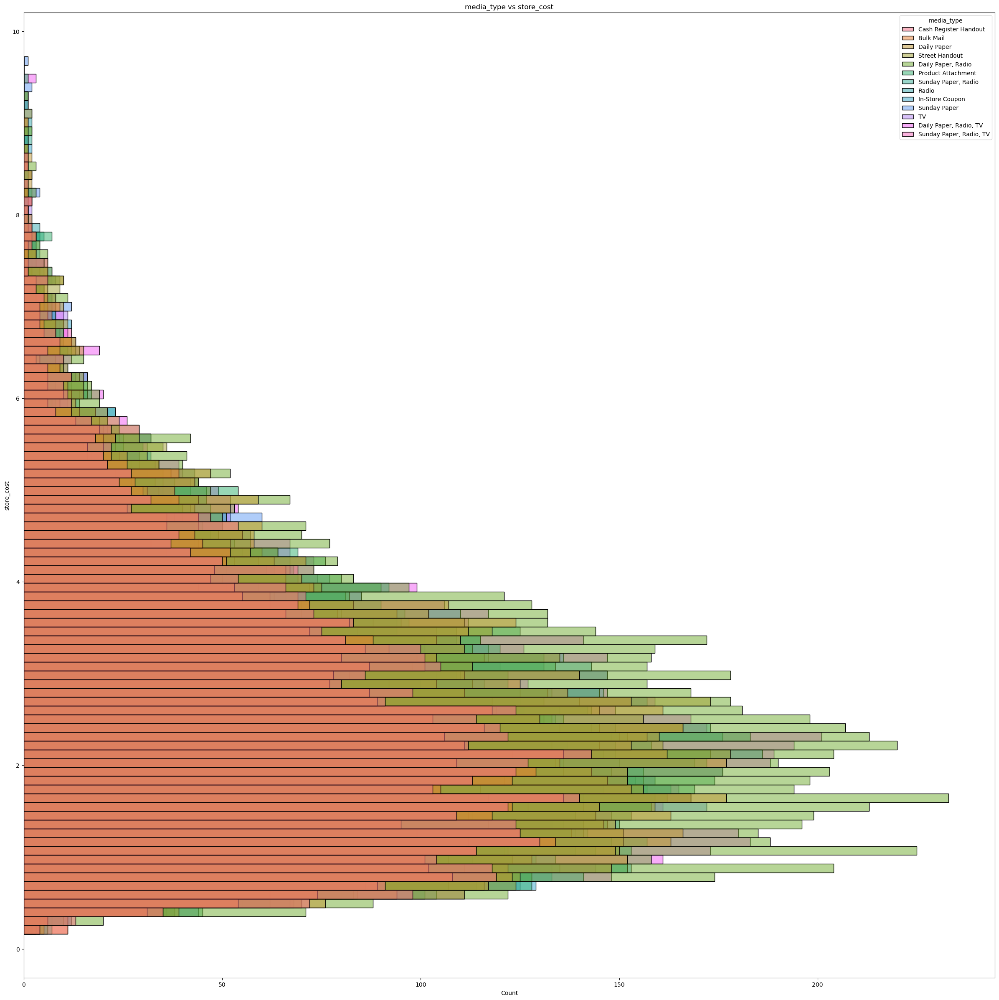

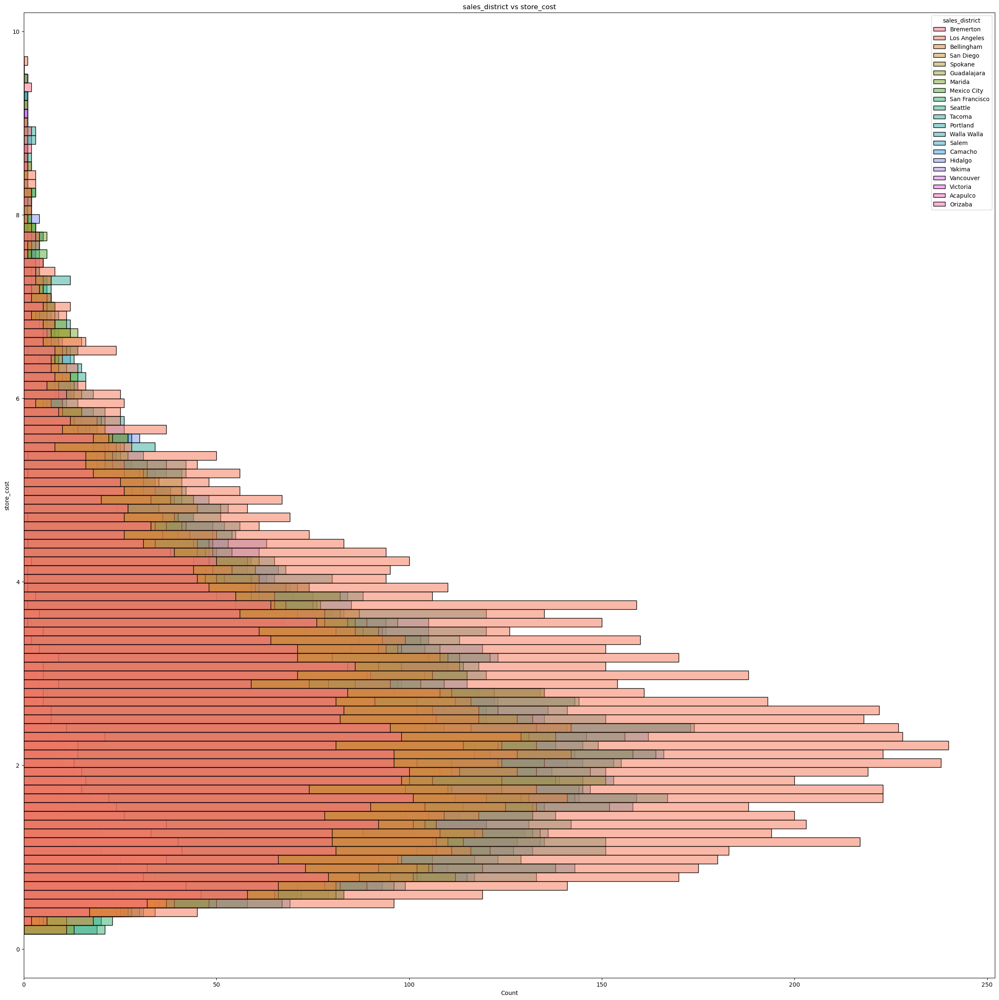

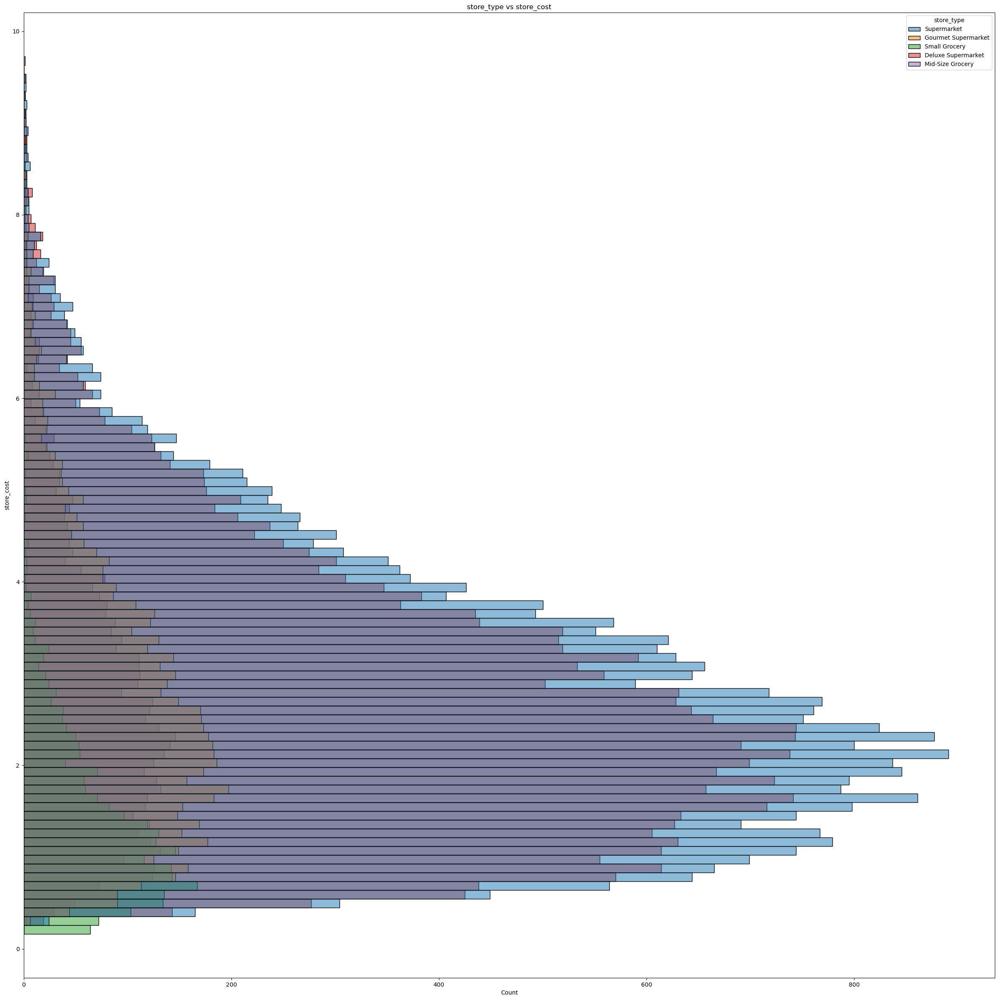

...

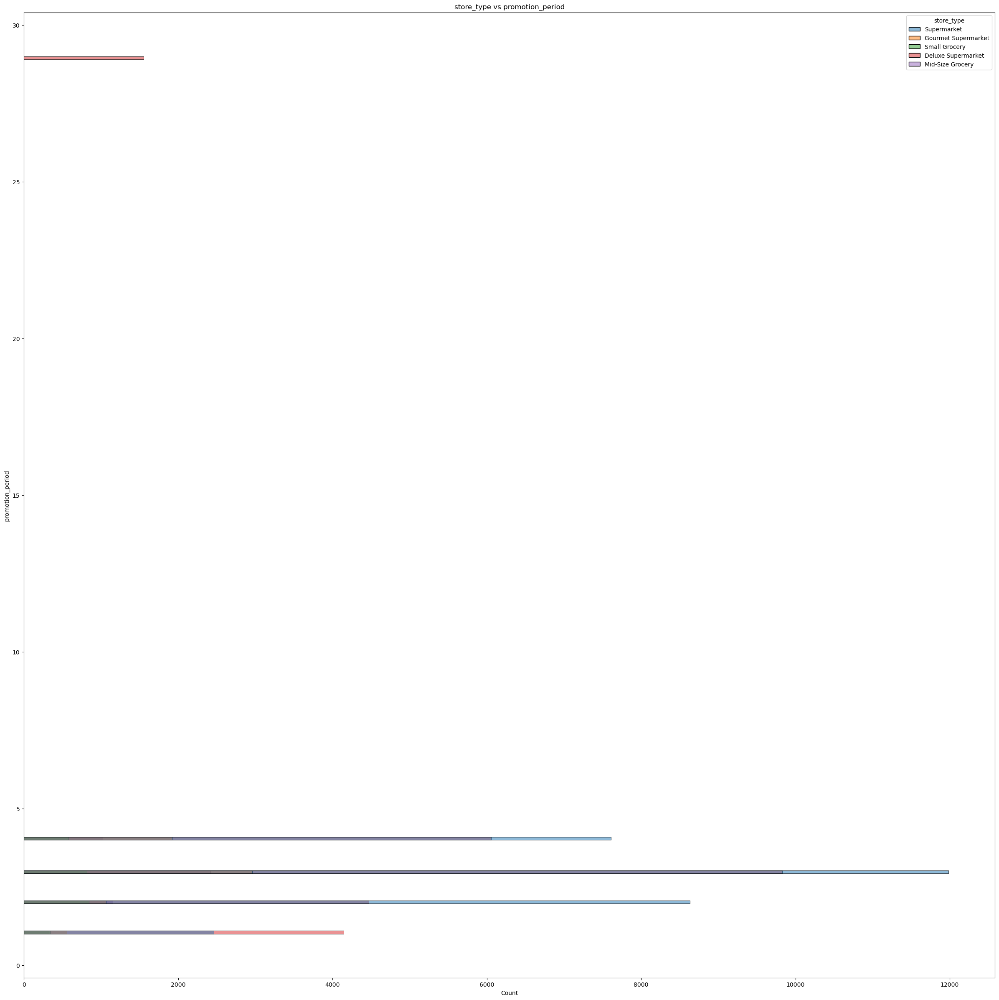

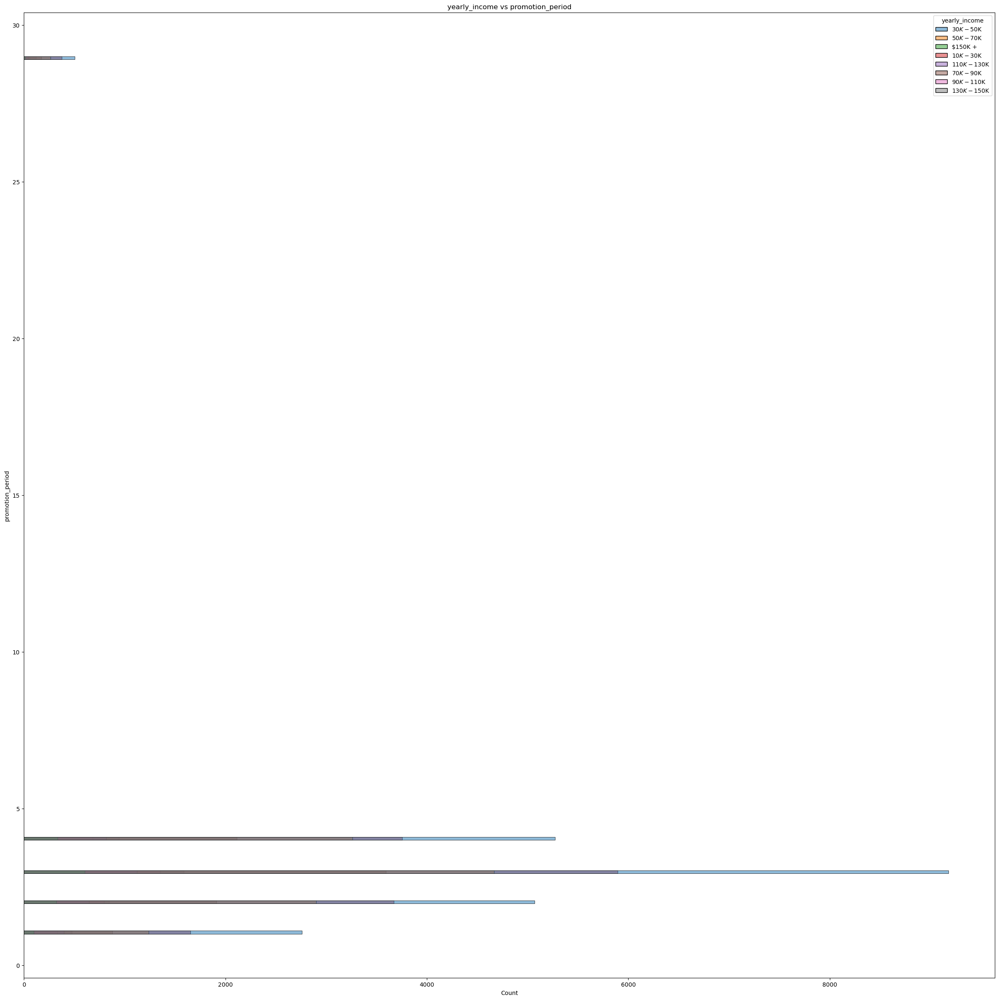

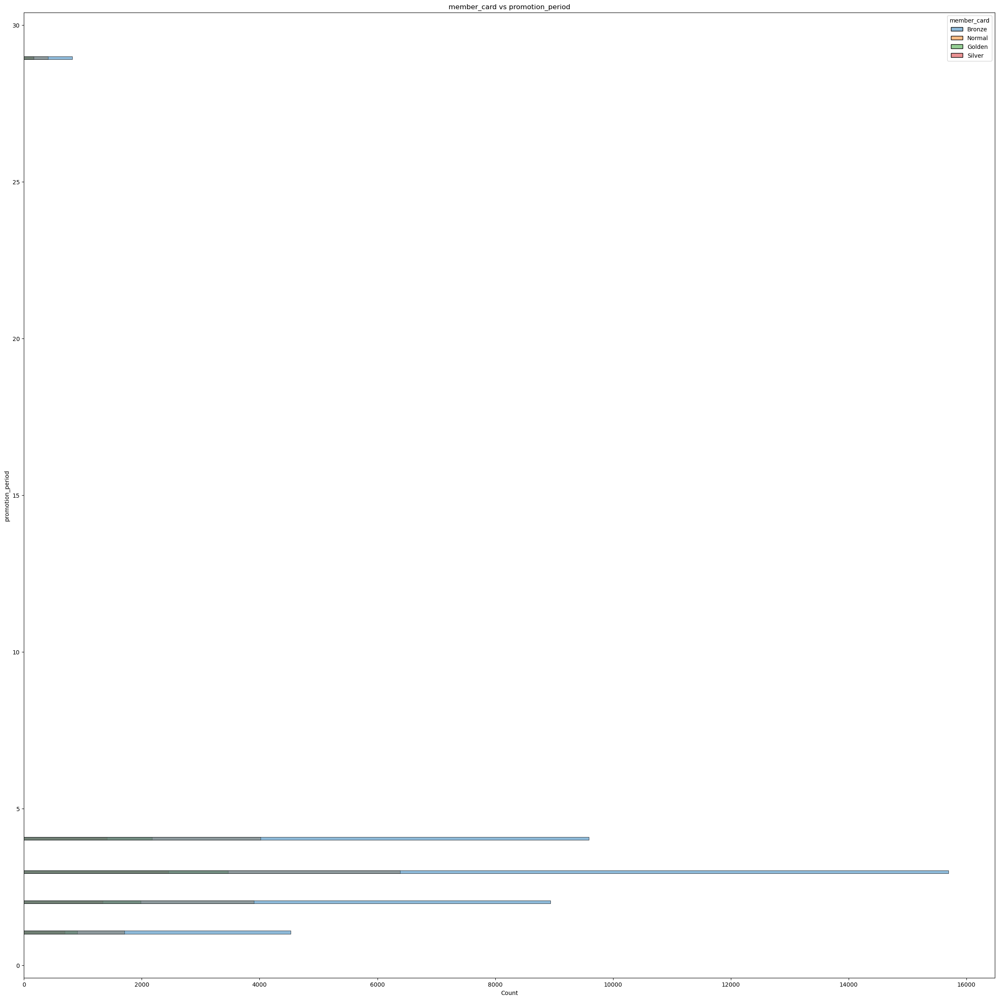

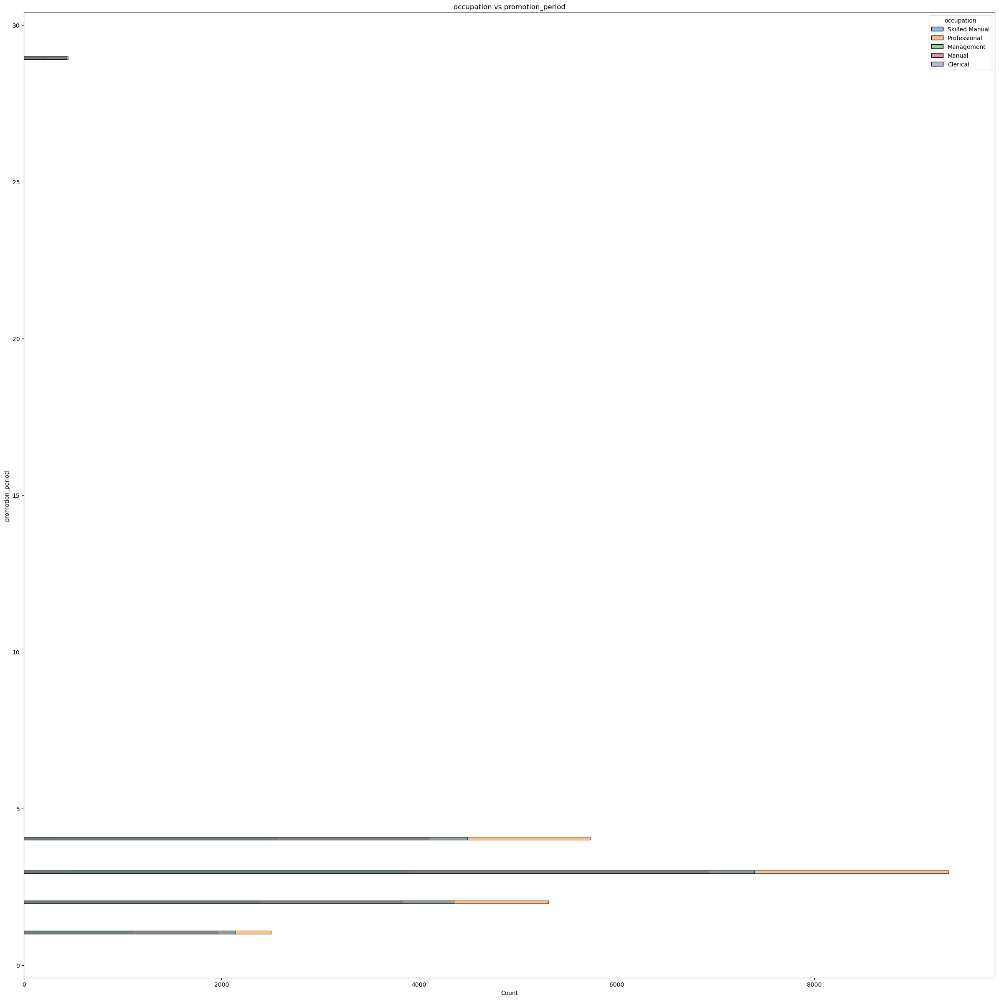

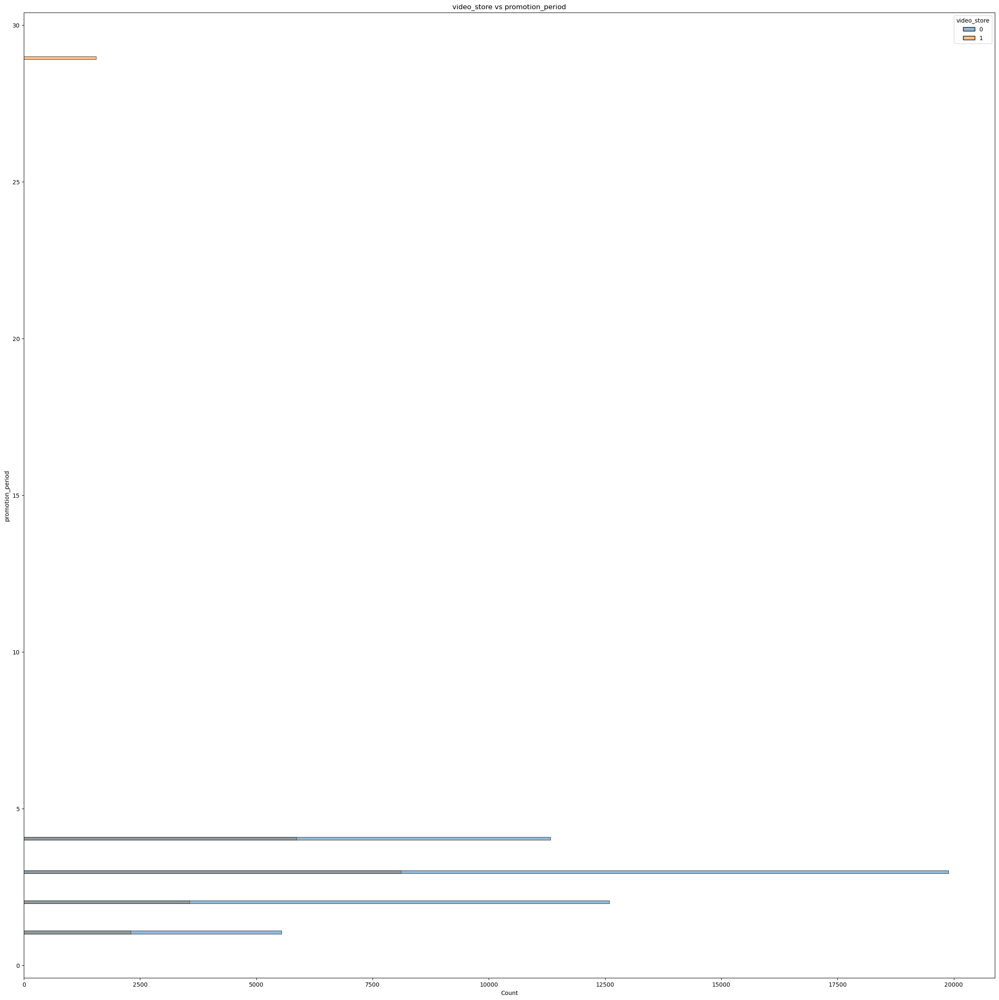

In [52]:
for i in df_num.columns:
    for j in df_cat.columns:
        plt.figure(figsize=(30,30))
        sns.histplot(hue=df_cat[j],y=df_num[i])
        plt.title(f"{j} vs {i}")
        plt.show()

# numerical vs numerical

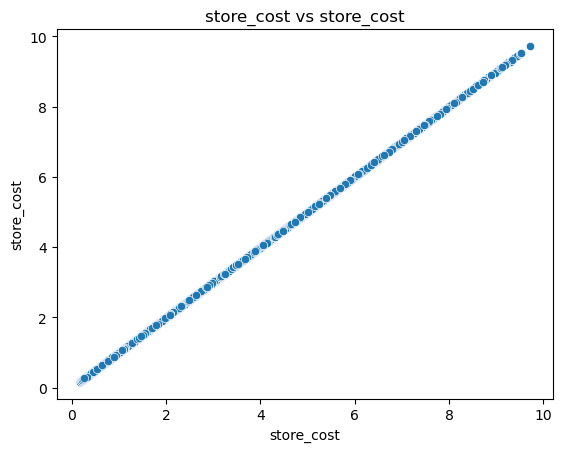

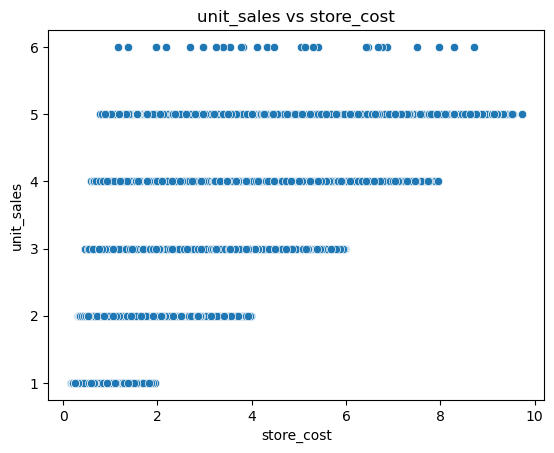

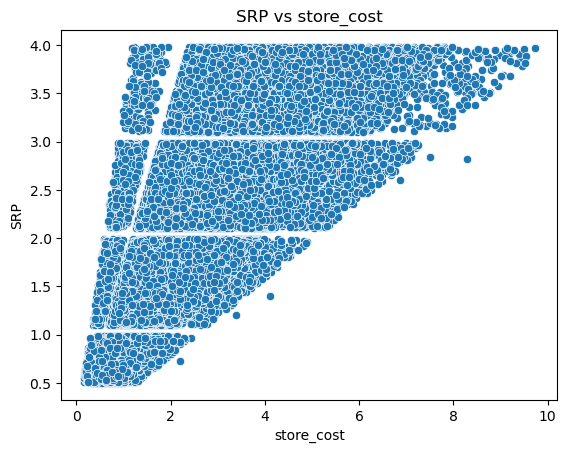

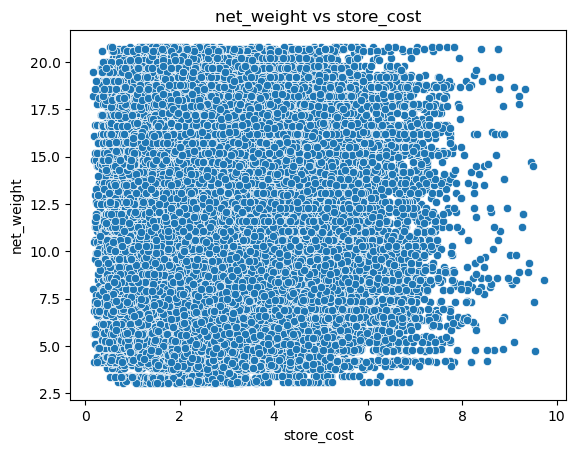

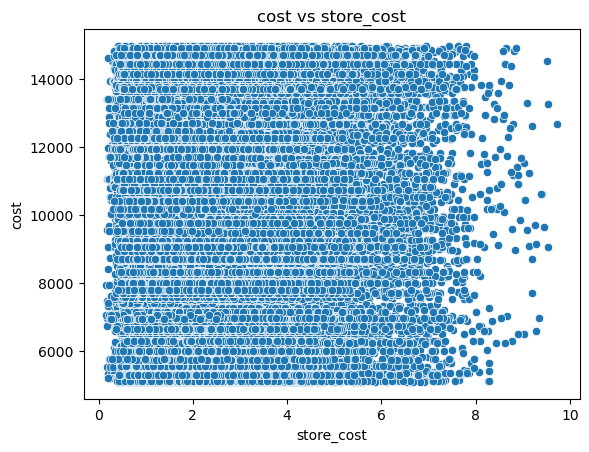

...

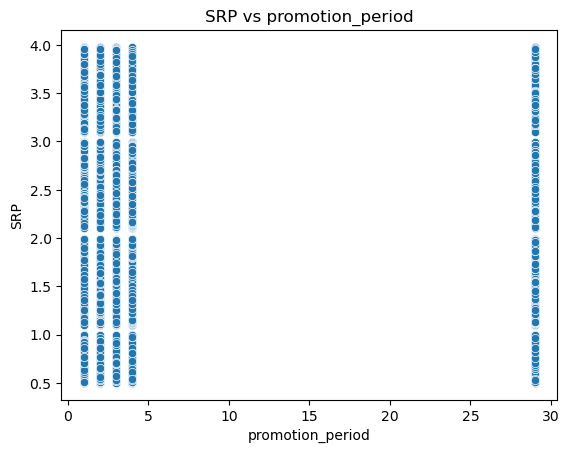

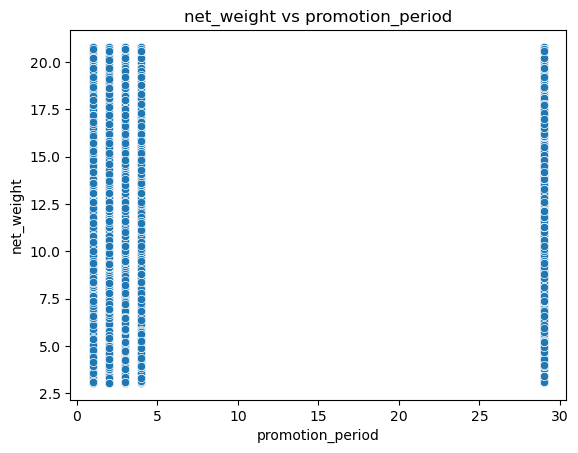

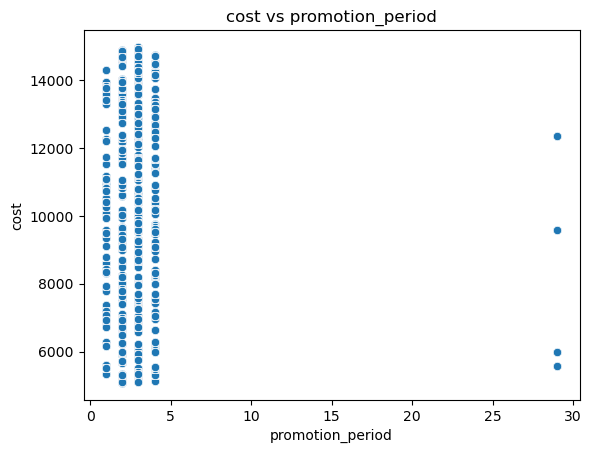

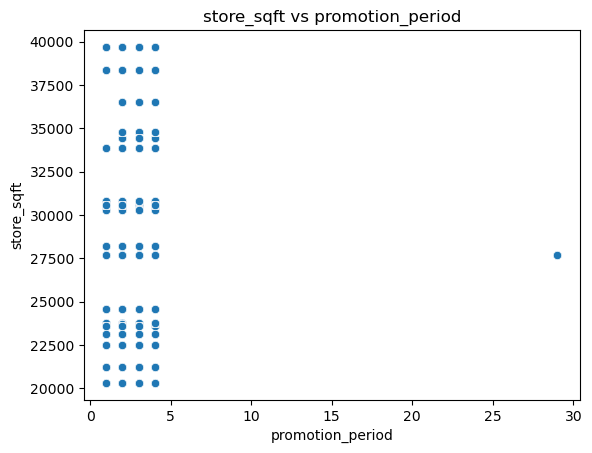

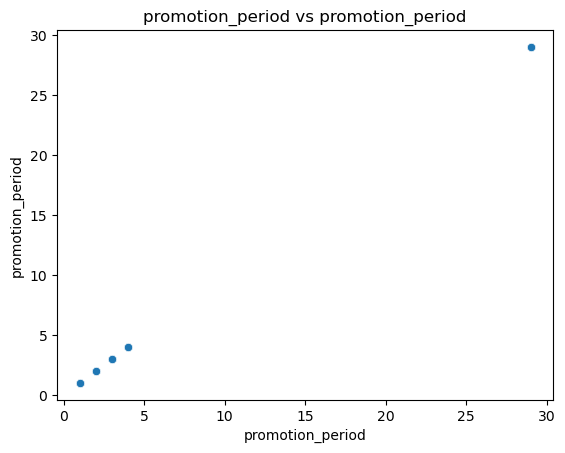

In [54]:
for i in df_num.columns:
    for j in df_num.columns:
        sns.scatterplot(x=df_num[i],y=df_num[j])
        plt.title(f"{j} vs {i}")
        plt.show()

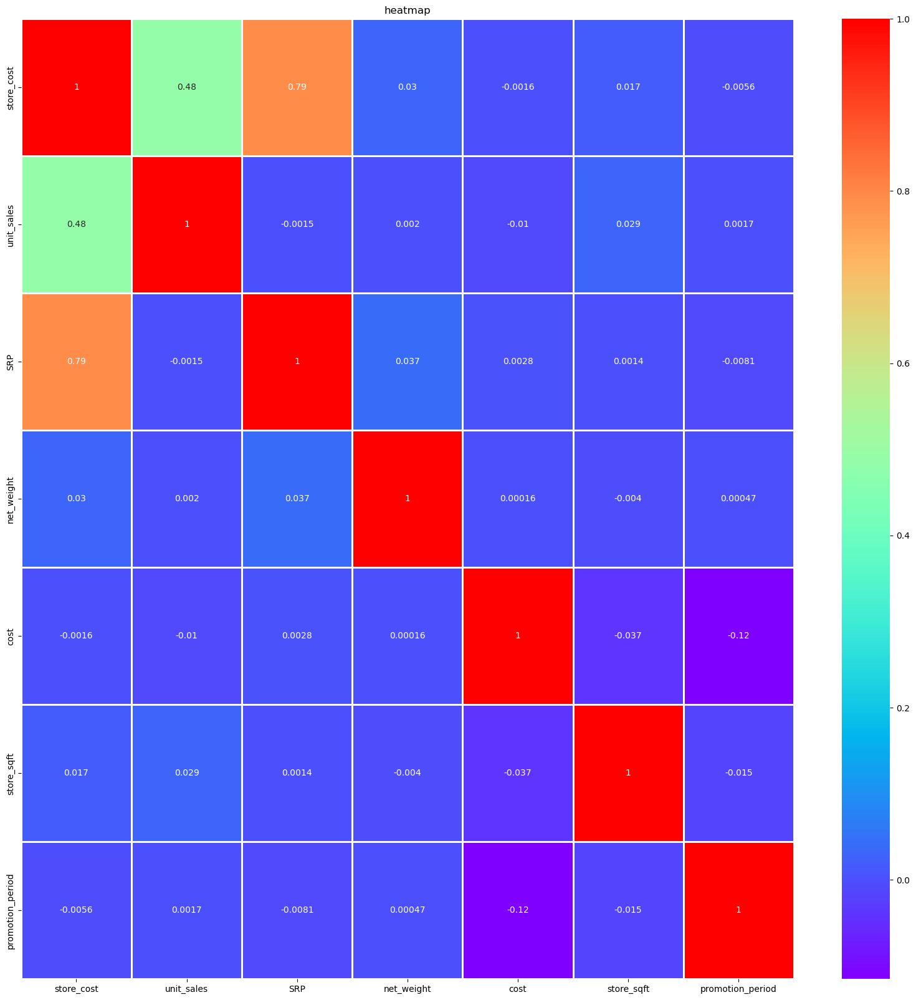

In [55]:
plt.figure(figsize=(20,20))
sns.heatmap(df_num.corr(),annot=True,linewidth=2,cmap="rainbow")
plt.title("heatmap")
plt.show()